# Single Image Super-Resolution (SISR) - Experimental Notebook

**Objective:** This notebook explores and compares different deep learning models for Single Image Super-Resolution (SISR). We aim to enhance low-resolution images by experimenting with:
*   **Architectures:** SRCNN, EDSR, RCAN
*   **Loss Functions:** L1, SSIM, and VGG Perceptual Loss
*   **Dataset:** DIV2K (X4 bicubic downscaling)
*   **Evaluation:** PSNR, SSIM, LPIPS

We will walk through data preparation, model definitions, training various "Hybrid" configurations, and finally, comparing their performance.


## Notebook Roadmap

*   **1. Project Setup & Environment Configuration**
    *   1.1. Mount Google Drive
    *   1.2. Import Essential Libraries
    *   1.3. Configure Device (CUDA/CPU)
*   **2. Dataset Preparation (DIV2K):**
    *   2.1. Download and Extract DIV2K Dataset
    *   2.2. Define Dataset Paths and Key Parameters (scale factor, patch size, batch size, dataset splits)
    *   2.3. Custom Dataset Class (`DIV2KCroppedDataset`)
    *   2.4. Create DataLoaders (Train, Validation, Test Splits)
    *   2.5. Visualize Data Samples (LR/HR pairs, patches/full images)
*   **3. Core Components & Helper Functions:**
    *   3.1. Evaluation Metrics & Functions:
        *   3.1.1. PSNR Calculation Function (`evaluate_model_psnr`)
        *   3.1.2. SSIM Calculation Function (`evaluate_model_ssim`)
        *   3.1.3. LPIPS Calculation Function (`evaluate_model_lpips`)
    *   3.2. Perceptual Loss Components:
        *   3.2.1. VGG Feature Extractor (`VGGFeatureExtractor`)
    *   3.3. Custom Loss Functions:
        *   3.2.2. SSIM Loss Class (`SSIMLoss` - using pytorch-msssim)
*   **4. Model Architectures:**
    *   4.1. SRCNN Model Definition
    *   4.2. EDSR Model Definition (including `ResidualBlock` and `UpsampleBlock`)
    *   4.3. RCAN Model Definition (including `CALayer`, `RCAB`, `ResidualGroup`, `Upsample`)
*   **5. Generic Training Loop:**
    *   5.1. Define Reusable Training Function (`train_model`) with validation, checkpointing, and scheduler support.
    *   5.2. Define Reusable Visualization Function
*   **6. Experiment Details & Execution:**
    *   **6.1. Hybrid 1: SRCNN + VGG Perceptual Loss**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.2. Hybrid 2: EDSR (32b, 64f) + L1 + SSIM Loss (50 epochs, No Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.3. Hybrid 3: EDSR (32b, 64f) + L1 + SSIM Loss (100 epochs, Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.4. Hybrid 4: EDSR (32b, 128f) + L1 + SSIM Loss (100 epochs, Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.5. Hybrid 5: EDSR (64b, 128f) + L1 + SSIM Loss (100 epochs, Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.6. Hybrid 6: EDSR (32b, 128f) + VGG (L35) + 0.1 * L1 Loss (100 epochs, Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
    *   **6.7. Hybrid 7: RCAN (10RG, 20RCAB, 64C) + L1 + 0.1 * SSIM Loss (100 epochs, Augmentation)**
        *   (Sub-sections: Define Loss, Instantiate, Train, Save/Load, Evaluate, Visualize)
*   **7. Comparative Analysis & Results Summary:**
    *   7.1. Plot Training Histories (Loss, Validation PSNR for all Hybrids)
    *   7.2. Evaluate All Models on the Test Set (or final validation set)
    *   7.3. Summary
   

## 1. Project Setup & Environment Configuration

### 1.1 Mount Google Drive

In [1]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### 1.2 Import Essential Libraries

In [20]:
!pip install lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 4.8 MB/s eta 0:00:00


In [18]:
!pip install pytorch_msssim

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 123.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 63.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 113.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvji

In [21]:
# Import necessary libraries
import os
import glob
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader, Subset
from torchvision.models import vgg19
from skimage.metrics import peak_signal_noise_ratio as calculate_psnr
from skimage.metrics import structural_similarity as calculate_ssim # For SSIM Loss if needed later
import torch
from pytorch_msssim import ssim
import lpips
from tqdm.notebook import tqdm
import numpy as np

### 1.3 Configure Device (CUDA/CPU)

In [5]:
# Check if CUDA is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


## 2. Data Preparation

### 2.1 Download and Extract DIV2K Dataset

The following cells download the necessary DIV2K dataset components (Train HR/LR, Valid HR/LR) and extract them into the `/content/data` directory.

In [6]:
# Create data directory
!mkdir -p /content/data
%cd /content/data

# Download Train Set (HR and LR)
print("Downloading DIV2K Training Set...")
!wget -c http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
!wget -c http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X4.zip

# Download Validation Set (HR and LR)  - This will be our Test Set
print("Downloading DIV2K Validation Set (used as Test Set)...")
!wget -c http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
!wget -c http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_LR_bicubic_X4.zip

# Extract downloaded files
print("Extracting files...")
!unzip -o -q DIV2K_train_HR.zip
!unzip -o -q DIV2K_train_LR_bicubic_X4.zip -d DIV2K_train_LR_bicubic # Extract LR into its own subdir
!unzip -o -q DIV2K_valid_HR.zip
!unzip -o -q DIV2K_valid_LR_bicubic_X4.zip -d DIV2K_valid_LR_bicubic # Extract LR into its own subdir

print("Dataset download and extraction complete.")
%cd /content # Corrected: Change back to root directory (comment removed)

/content/data
--2025-05-04 09:59:14--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip [following]
--2025-05-04 09:59:15--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

--2025-05-04 09:59:15--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X4.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|1

### 2.2 Dataset Paths and Parameters

Define paths to the downloaded DIV2K dataset components. We will use the DIV2K *training* set for training and validation, and the DIV2K *validation* set as our final test set.

In [7]:
# Define paths (assuming data is downloaded in /content/data)
base_data_path = "/content/data"

# Check if the base path exists after download/extraction
if not os.path.exists(base_data_path) or not os.path.exists(os.path.join(base_data_path, "DIV2K_train_HR")):
    print(f"Warning: Dataset path {base_data_path} or its contents not found. Please ensure the download/extraction cell ran successfully.")
else:
    print(f"Dataset base path found: {base_data_path}")

train_hr_dir = os.path.join(base_data_path, "DIV2K_train_HR")
# Corrected path for LR train images based on unzip structure
train_lr_dir = os.path.join(base_data_path, "DIV2K_train_LR_bicubic", "DIV2K_train_LR_bicubic", "X4")

# Use the original DIV2K validation set as our test set
test_hr_dir = os.path.join(base_data_path, "DIV2K_valid_HR")
# Corrected path for LR test images based on unzip structure
test_lr_dir = os.path.join(base_data_path, "DIV2K_valid_LR_bicubic", "DIV2K_valid_LR_bicubic", "X4")

# Parameters
scale_factor = 4
hr_patch_size = 96 # Size of HR patches to crop for training
lr_patch_size = hr_patch_size // scale_factor # Corresponding LR patch size
batch_size = 8 # Adjust based on GPU memory
validation_split = 0.1 # Use 10% of training data for validation

Dataset base path found: /content/data


### 2.3 Dataset Class with Random Cropping

This dataset class loads HR/LR pairs and applies random cropping and augmentations during training.

In [8]:
class DIV2KCroppedDataset(Dataset):
    def __init__(self, hr_dir, lr_dir, hr_patch_size, scale_factor, split="train", transform=None):
        self.hr_dir = hr_dir
        self.lr_dir = lr_dir
        self.hr_patch_size = hr_patch_size
        self.lr_patch_size = hr_patch_size // scale_factor
        self.scale_factor = scale_factor
        self.split = split
        self.transform = transform

        self.hr_image_files = sorted(glob.glob(os.path.join(hr_dir, "*.png")))
        # LR files are expected inside the X4 subdirectory
        self.lr_image_files = sorted(glob.glob(os.path.join(lr_dir, "*.png")))

        if not self.hr_image_files:
            raise FileNotFoundError(f"No HR images found in {hr_dir}")
        if not self.lr_image_files:
             raise FileNotFoundError(f"No LR images found in {lr_dir}")

        # Verify counts (optional but good practice)
        print(f"Found {len(self.hr_image_files)} HR images in {hr_dir}")
        print(f"Found {len(self.lr_image_files)} LR images in {lr_dir}")

    def __len__(self):
        return len(self.hr_image_files)

    def __getitem__(self, idx):
        hr_img_path = self.hr_image_files[idx]
        # Construct LR path based on HR filename (e.g., 0001.png -> 0001x4.png)
        hr_basename = os.path.basename(hr_img_path)
        lr_basename = hr_basename.replace(".png", f"x{self.scale_factor}.png")
        lr_img_path = os.path.join(self.lr_dir, lr_basename)

        try:
            hr_image = Image.open(hr_img_path).convert("RGB")
            lr_image = Image.open(lr_img_path).convert("RGB")
        except FileNotFoundError:
            print(f"Error loading image pair: HR={hr_img_path}, Expected LR={lr_img_path}")
            # Handle error, e.g., skip this sample or return dummy data
            # For simplicity, let's try loading the next image
            return self.__getitem__((idx + 1) % len(self))

        if self.split == "train":
            # Get random crop parameters based on LR image size
            lr_w, lr_h = lr_image.size
            if lr_w < self.lr_patch_size or lr_h < self.lr_patch_size:
                # If LR image is too small, resize it up slightly bigger than patch size
                target_size = max(self.lr_patch_size, lr_w, lr_h)
                lr_image = TF.resize(lr_image, target_size, interpolation=Image.BICUBIC)
                hr_image = TF.resize(hr_image, target_size * self.scale_factor, interpolation=Image.BICUBIC)

            i, j, h, w = transforms.RandomCrop.get_params(
                lr_image, output_size=(self.lr_patch_size, self.lr_patch_size)
            )
            lr_patch = TF.crop(lr_image, i, j, h, w)
            hr_patch = TF.crop(hr_image, i * self.scale_factor, j * self.scale_factor, h * self.scale_factor, w * self.scale_factor)

            # Apply random horizontal flip
            if random.random() > 0.5:
                lr_patch = TF.hflip(lr_patch)
                hr_patch = TF.hflip(hr_patch)

            # Apply random vertical flip
            if random.random() > 0.5:
                lr_patch = TF.vflip(lr_patch)
                hr_patch = TF.vflip(hr_patch)

        else: # For validation/test, use full image
            lr_patch = lr_image
            hr_patch = hr_image

        # Apply transforms (ToTensor, normalization etc.)
        if self.transform:
            lr_patch = self.transform(lr_patch)
            hr_patch = self.transform(hr_patch)

        return lr_patch, hr_patch

### 2.4 Data Loaders Setup (Train/Validation/Test Split)

In [9]:
# Define transforms
transform = transforms.Compose([
    transforms.ToTensor() # Converts PIL image [0, 255] to tensor [0, 1]
])

# Load the full training dataset
try:
    full_train_dataset = DIV2KCroppedDataset(
        hr_dir=train_hr_dir,
        lr_dir=train_lr_dir,
        hr_patch_size=hr_patch_size,
        scale_factor=scale_factor,
        split="train",
        transform=transform
    )
    num_train = len(full_train_dataset)
except FileNotFoundError as e:
    print(f"Error initializing training dataset: {e}. Please check paths and ensure data is extracted.")
    num_train = 0 # Set to 0 to prevent further errors

if num_train > 0:
    # Split training data into training and validation sets
    indices = list(range(num_train))
    split_idx = int(np.floor(validation_split * num_train))

    # Shuffle indices before splitting
    np.random.seed(42) # for reproducibility
    np.random.shuffle(indices)

    train_indices, val_indices = indices[split_idx:], indices[:split_idx]

    # Create subset datasets
    train_subset = Subset(full_train_dataset, train_indices)

    # Create a separate dataset instance for validation to avoid random cropping
    val_dataset_config = {
        "hr_dir": train_hr_dir,
        "lr_dir": train_lr_dir,
        "hr_patch_size": hr_patch_size, # Not used if split != train
        "scale_factor": scale_factor,
        "split": "validation", # Use full images for validation
        "transform": transform
    }
    try:
        full_val_dataset = DIV2KCroppedDataset(**val_dataset_config)
        val_subset = Subset(full_val_dataset, val_indices)
    except FileNotFoundError as e:
        print(f"Error initializing validation dataset: {e}.")
        val_subset = None # Mark as None if error

    # Load the test dataset (using DIV2K validation set)
    test_dataset_config = {
        "hr_dir": test_hr_dir,
        "lr_dir": test_lr_dir,
        "hr_patch_size": hr_patch_size, # Not used if split != train
        "scale_factor": scale_factor,
        "split": "test", # Use full images for test
        "transform": transform
    }
    try:
        test_dataset = DIV2KCroppedDataset(**test_dataset_config)
    except FileNotFoundError as e:
        print(f"Error initializing test dataset: {e}.")
        test_dataset = None # Mark as None if error

    # Create DataLoaders
    train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
    val_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=1, pin_memory=True) if val_subset else None
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=1, pin_memory=True) if test_dataset else None

    print(f"Full training dataset size: {num_train}")
    print(f"Training subset size: {len(train_subset)}")
    print(f"Validation subset size: {len(val_subset) if val_subset else 0}")
    print(f"Test dataset size: {len(test_dataset) if test_dataset else 0}")
else:
    print("Skipping DataLoader creation due to dataset initialization error.")
    train_loader, val_loader, test_loader = None, None, None

Found 800 HR images in /content/data/DIV2K_train_HR
Found 800 LR images in /content/data/DIV2K_train_LR_bicubic/DIV2K_train_LR_bicubic/X4
Found 800 HR images in /content/data/DIV2K_train_HR
Found 800 LR images in /content/data/DIV2K_train_LR_bicubic/DIV2K_train_LR_bicubic/X4
Found 100 HR images in /content/data/DIV2K_valid_HR
Found 100 LR images in /content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4
Full training dataset size: 800
Training subset size: 720
Validation subset size: 80
Test dataset size: 100


### 2.5 Visualize Data Samples

Sample from Training Loader (Patches):


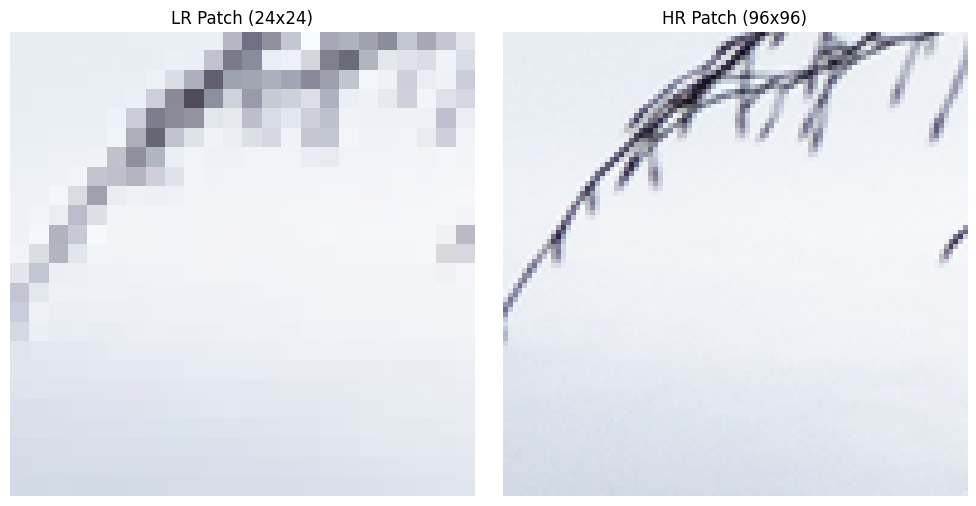


Sample from Validation Loader (Full Images):


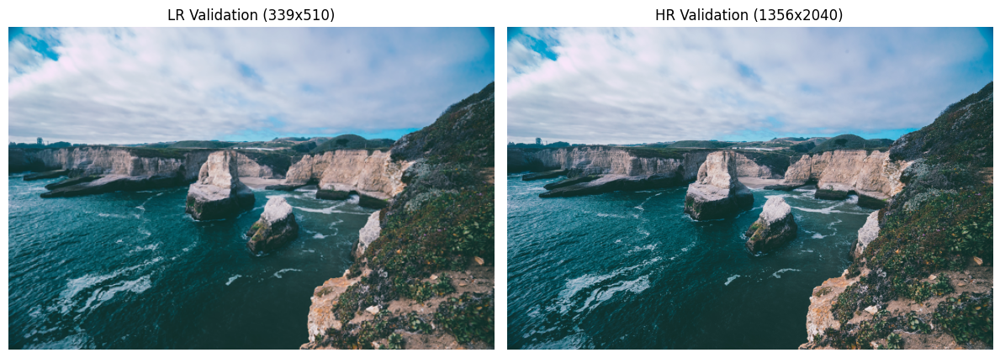

In [10]:
# Function to display images
def show_tensor_image(tensor_img, title=""):
    img = tensor_img.squeeze().cpu().numpy().transpose(1, 2, 0)
    img = np.clip(img, 0, 1) # Ensure values are in [0, 1]
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")

# Visualize a sample from the train loader (cropped patches)
if train_loader:
    print("Sample from Training Loader (Patches):")
    try:
        lr_patch_sample, hr_patch_sample = next(iter(train_loader))
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        show_tensor_image(lr_patch_sample[0], f"LR Patch ({lr_patch_sample[0].shape[-2]}x{lr_patch_sample[0].shape[-1]})")
        plt.subplot(1, 2, 2)
        show_tensor_image(hr_patch_sample[0], f"HR Patch ({hr_patch_sample[0].shape[-2]}x{hr_patch_sample[0].shape[-1]})")
        plt.tight_layout()
        plt.show()
    except StopIteration:
        print("Could not get sample from train_loader (possibly empty dataset or split issue).")
    except Exception as e:
        print(f"Error visualizing train sample: {e}")
else:
    print("Train loader not available for visualization.")

# Visualize a sample from the validation loader (full images)
if val_loader:
    print("\nSample from Validation Loader (Full Images):")
    try:
        lr_val_sample, hr_val_sample = next(iter(val_loader))
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        show_tensor_image(lr_val_sample[0], f"LR Validation ({lr_val_sample[0].shape[-2]}x{lr_val_sample[0].shape[-1]})")
        plt.subplot(1, 2, 2)
        show_tensor_image(hr_val_sample[0], f"HR Validation ({hr_val_sample[0].shape[-2]}x{hr_val_sample[0].shape[-1]})")
        plt.tight_layout()
        plt.show()
    except StopIteration:
        print("Could not get sample from val_loader (possibly empty dataset or split issue).")
    except Exception as e:
        print(f"Error visualizing validation sample: {e}")
else:
    print("Validation loader not available for visualization.")

## 3. Core Components & Helper Functions:

### 3.1. Evaluation Metrics & Functions

#### 3.1.1 Evaluation Function (PSNR)

In [11]:
def evaluate_model_psnr(model, dataloader, device):
    if dataloader is None:
        print("Dataloader is None, cannot evaluate PSNR.")
        return 0.0

    model.eval()
    total_psnr = 0
    count = 0
    with torch.no_grad():
        val_pbar = tqdm(dataloader, desc="Calculating PSNR", leave=False)
        for lr_img, hr_img in val_pbar:
            lr_img = lr_img.to(device)
            hr_img = hr_img.to(device)

            try:
                sr_img = model(lr_img)
            except Exception as e:
                print(f"Error during model inference: {e}. Skipping batch.")
                continue

            # Clamp output to [0, 1] before PSNR calculation
            sr_img = torch.clamp(sr_img, 0.0, 1.0)

            # Convert tensors to numpy for PSNR calculation
            # Ensure batch size is 1 for direct comparison
            if sr_img.size(0) == 1:
                sr_np = sr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)
                hr_np = hr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)

                # Calculate PSNR (ensure data range is correct, ToTensor makes it [0, 1])
                try:
                    psnr = calculate_psnr(hr_np, sr_np, data_range=1.0)
                    if np.isinf(psnr) or np.isnan(psnr):
                        # print(f"Warning: Invalid PSNR value encountered (inf/nan). Skipping image.")
                        continue # Skip this image
                    total_psnr += psnr
                    count += 1
                except ValueError as ve:
                    # Handle cases where images might have different dimensions after processing
                    print(f"ValueError calculating PSNR: {ve}. SR shape: {sr_np.shape}, HR shape: {hr_np.shape}. Skipping.")
                    continue
                except Exception as e:
                    print(f"Warning: Error calculating PSNR for an image: {e}. Skipping.")
                    continue
            else:
                # Handle batch > 1 if needed
                for i in range(sr_img.size(0)):
                    sr_np = sr_img[i].cpu().numpy().transpose(1, 2, 0)
                    hr_np = hr_img[i].cpu().numpy().transpose(1, 2, 0)
                    try:
                        psnr = calculate_psnr(hr_np, sr_np, data_range=1.0)
                        if np.isinf(psnr) or np.isnan(psnr):
                           # print(f"Warning: Invalid PSNR value encountered (inf/nan) in batch. Skipping image.")
                           continue
                        total_psnr += psnr
                        count += 1
                    except ValueError as ve:
                         print(f"ValueError calculating PSNR in batch: {ve}. SR shape: {sr_np.shape}, HR shape: {hr_np.shape}. Skipping.")
                         continue
                    except Exception as e:
                        print(f"Warning: Error calculating PSNR for an image in batch: {e}. Skipping.")
                        continue

    avg_psnr = total_psnr / count if count > 0 else 0
    model.train() # Set model back to training mode
    return avg_psnr

#### 3.1.2 Evaluation Function (SSIM)

In [15]:
# SSIM Evaluation Function
def evaluate_model_ssim(model, loader, device):
    model.eval()
    total_ssim = 0.0
    num_images = 0
    if loader.batch_size != 1:
        print(f"Warning: SSIM evaluation ideally uses batch_size=1. Current batch_size is {loader.batch_size}.")
    with torch.no_grad():
        progress_bar = tqdm(loader, desc="Evaluating SSIM", leave=False)
        for lr_imgs, hr_imgs in progress_bar:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            sr_imgs = model(lr_imgs)
            sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
            hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)
            batch_ssim = ssim(sr_imgs, hr_imgs, data_range=1.0, size_average=False)
            total_ssim += torch.sum(batch_ssim).item()
            num_images += lr_imgs.size(0)
            if num_images > 0:
                running_avg_ssim = total_ssim / num_images
                progress_bar.set_postfix({"Avg SSIM": f"{running_avg_ssim:.4f}"})
    avg_ssim = total_ssim / num_images if num_images > 0 else 0
    print(f"\nAverage SSIM on {num_images} images: {avg_ssim:.4f}")
    return avg_ssim

#### 3.1.3 Evaluation Function (LPIPS)

In [16]:
#  LPIPS Evaluation Function
def evaluate_model_lpips(model, loader, device):
    model.eval()
    try:
        # <<< Removed backslashes around 'alex' >>>
        loss_fn_alex = lpips.LPIPS(net='alex').to(device)
        loss_fn_alex.eval()
    except Exception as e:
        print(f"Error initializing LPIPS model: {e}")
        return None
    total_lpips = 0.0
    num_images = 0
    if loader.batch_size != 1:
        print(f"Warning: LPIPS evaluation ideally uses batch_size=1. Current batch_size is {loader.batch_size}.")
    with torch.no_grad():
        progress_bar = tqdm(loader, desc="Evaluating LPIPS", leave=False)
        for lr_imgs, hr_imgs in progress_bar:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            sr_imgs = model(lr_imgs)
            sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
            hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)
            sr_imgs_norm = sr_imgs * 2.0 - 1.0
            hr_imgs_norm = hr_imgs * 2.0 - 1.0
            batch_lpips = loss_fn_alex(sr_imgs_norm, hr_imgs_norm)
            total_lpips += torch.sum(batch_lpips).item()
            num_images += lr_imgs.size(0)
            if num_images > 0:
                running_avg_lpips = total_lpips / num_images
                progress_bar.set_postfix({"Avg LPIPS": f"{running_avg_lpips:.4f}"})
    avg_lpips = total_lpips / num_images if num_images > 0 else float('inf')
    print(f"\nAverage LPIPS on {num_images} images: {avg_lpips:.4f} (Lower is better)")
    return avg_lpips


### 3.2 Perceptual Loss Components

### 3.2.1 VGG Feature Extractor

In [12]:
from torchvision import models # Ensure models is imported

class VGGFeatureExtractor(nn.Module):
    def __init__(self, feature_layer=35, use_bn=False): # Default uses features before 5th conv block (original SRGAN)
        super(VGGFeatureExtractor, self).__init__()
        if use_bn:
             # VGG19 with Batch Norm might be more stable in some cases
             vgg19_model = models.vgg19_bn(weights=models.VGG19_BN_Weights.DEFAULT)
        else:
             vgg19_model = models.vgg19(weights=models.VGG19_Weights.DEFAULT)

        # Extract features up to the specified layer
        self.features = nn.Sequential(*list(vgg19_model.features.children())[:(feature_layer + 1)])

        # Freeze VGG parameters
        for param in self.features.parameters():
            param.requires_grad = False

        # VGG expects normalized input (ImageNet stats)
        self.normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

    def forward(self, img):
        # Apply normalization - ensure input is 3 channels
        if img.shape[1] == 1: # If grayscale, repeat channel
            img = img.repeat(1, 3, 1, 1)
        img_normalized = self.normalize(img)
        return self.features(img_normalized)

### 3.2.2 SSIM

In [13]:
# Install pytorch-msssim if not already installed
try:
    import pytorch_msssim
except ImportError:
    print("Installing pytorch-msssim...")
    !pip install pytorch-msssim -q

try:
    from pytorch_msssim import ssim, ms_ssim # MS_SSIM is often preferred
    class SSIMLoss(nn.Module):
        def __init__(self, data_range=1.0, size_average=True, channel=3, nonnegative_ssim=False):
            super(SSIMLoss, self).__init__()
            self.data_range = data_range
            self.size_average = size_average
            self.channel = channel
            self.nonnegative = nonnegative_ssim

        def forward(self, img1, img2):
            # SSIM returns a value between -1 and 1 (higher is better)
            # Loss should be 1 - SSIM
            ssim_val = ssim(img1, img2, data_range=self.data_range, size_average=self.size_average, nonnegative_ssim=self.nonnegative)
            return 1.0 - ssim_val
    use_ssim_loss = True
    print("Using pytorch-msssim for SSIM loss.")
except ImportError:
    print("pytorch-msssim not found or failed to import after install. SSIM loss will not be used.")
    use_ssim_loss = False
    class SSIMLoss(nn.Module): # Dummy class
        def forward(self, img1, img2): return torch.tensor(0.0).to(img1.device) # Return 0 loss if not available

Using pytorch-msssim for SSIM loss.


## 4. Model Architectures

### 4.1 SRCNN Model Architecture (for Hybrid 1)

In [14]:
class SRCNN(nn.Module):
    def __init__(self, num_channels=3):
        super(SRCNN, self).__init__()
        # Original SRCNN paper uses 9-1-5 kernels
        self.conv1 = nn.Conv2d(num_channels, 64, kernel_size=9, padding=9//2)
        self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=0) # Mapping layer
        self.conv3 = nn.Conv2d(32, num_channels, kernel_size=5, padding=5//2)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        # This version assumes input x is LR and the network learns the mapping to HR directly.
        # It does NOT include the initial bicubic upsampling or final residual connection of some SRCNN variants.
        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.conv3(x)
        return x

### 4.2 EDSR Model Architecture (for Hybrid 2 to 6)



In [15]:
import torch
import torch.nn as nn
import math

# Define Residual Block
class ResidualBlock(nn.Module):
    def __init__(self, num_features):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(num_features, num_features, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(num_features, num_features, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        out = self.relu(self.conv1(x))
        out = self.conv2(out)
        out = out + residual # Element-wise sum
        return out

# Define Upsample Block (PixelShuffle)
def UpsampleBlock(scale_factor, num_features):
    layers = []
    if (scale_factor & (scale_factor - 1)) == 0: # Check if power of 2
        for _ in range(int(math.log2(scale_factor))):
            layers.append(nn.Conv2d(num_features, 4 * num_features, kernel_size=3, padding=1))
            layers.append(nn.PixelShuffle(2))
            layers.append(nn.ReLU(inplace=True))
    else:
        layers.append(nn.Conv2d(num_features, num_features * (scale_factor ** 2), kernel_size=3, padding=1))
        layers.append(nn.PixelShuffle(scale_factor))
        layers.append(nn.ReLU(inplace=True))
    return nn.Sequential(*layers)

# Define EDSR Model
class EDSR(nn.Module):
    def __init__(self, num_res_blocks=16, num_features=64, scale_factor=4):
        super(EDSR, self).__init__()

        self.head = nn.Conv2d(3, num_features, kernel_size=3, padding=1)

        body = [ResidualBlock(num_features) for _ in range(num_res_blocks)]
        self.body = nn.Sequential(*body)

        self.tail = UpsampleBlock(scale_factor, num_features)

        self.final_conv = nn.Conv2d(num_features, 3, kernel_size=3, padding=1)

    def forward(self, x):
        x = self.head(x)
        res = self.body(x)
        res = res + x # Global residual connection

        x = self.tail(res)
        x = self.final_conv(x)
        return x


### 4.3 RCAN Architecture (for Hybrid 7)

In [85]:
# Define RCAN Model Architecture

import math
import torch
from torch import nn, Tensor

# Channel Attention (CA) Layer
class CALayer(nn.Module):
    def __init__(self, channels: int, reduction: int) -> None:
        super(CALayer, self).__init__()
        # Global average pooling layer
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        # Feature channel downscale and upscale layers
        self.conv_du = nn.Sequential(
            nn.Conv2d(channels, channels // reduction, (1, 1), (1, 1), (0, 0)),
            nn.ReLU(True),
            nn.Conv2d(channels // reduction, channels, (1, 1), (1, 1), (0, 0)),
            nn.Sigmoid(),
        )

    def forward(self, x: Tensor) -> Tensor:
        out = self.avg_pool(x)
        out = self.conv_du(out)
        out = torch.mul(x, out)
        return out

# Residual Channel Attention Block (RCAB)
class RCAB(nn.Module):
    def __init__(self, channels: int, reduction: int) -> None:
        super(RCAB, self).__init__()
        self.rcab = nn.Sequential(
            nn.Conv2d(channels, channels, (3, 3), (1, 1), (1, 1)),
            nn.ReLU(True),
            nn.Conv2d(channels, channels, (3, 3), (1, 1), (1, 1)),
            CALayer(channels, reduction),
        )

    def forward(self, x: Tensor) -> Tensor:
        out = self.rcab(x)
        out = torch.add(x, out)
        return out

# Residual Group (RG)
class ResidualGroup(nn.Module):
    def __init__(self, channels: int, reduction: int, num_rcab: int) -> None:
        super(ResidualGroup, self).__init__()
        residual_channel_attention_block = []
        for _ in range(num_rcab):
            residual_channel_attention_block.append(RCAB(channels, reduction))
        self.residual_channel_attention_block = nn.Sequential(*residual_channel_attention_block)
        self.conv = nn.Conv2d(channels, channels, (3, 3), (1, 1), (1, 1))

    def forward(self, x: Tensor) -> Tensor:
        out = self.residual_channel_attention_block(x)
        out = self.conv(out)
        out = torch.add(x, out)
        return out

# Upsampling Module (using PixelShuffle)
class Upsample(nn.Module):
    def __init__(self, channels: int, upscale_factor: int) -> None:
        super(Upsample, self).__init__()
        self.upsample_block = nn.Sequential(
            nn.Conv2d(channels, channels * upscale_factor * upscale_factor, (3, 3), (1, 1), (1, 1)),
            nn.PixelShuffle(upscale_factor),
        )

    def forward(self, x: Tensor) -> Tensor:
        out = self.upsample_block(x)
        return out

# RCAN Main Model
class RCAN(nn.Module):
    def __init__(
            self,
            in_channels: int = 3,         # Default to 3 for RGB
            out_channels: int = 3,        # Default to 3 for RGB
            channels: int = 64,         # Number of feature channels
            reduction: int = 16,        # Reduction factor for CA
            num_rg: int = 10,           # Number of Residual Groups
            num_rcab: int = 20,         # Number of RCABs per RG
            upscale_factor: int = 4,    # Default upscale factor
    ) -> None:
        super(RCAN, self).__init__()
        # Shallow feature extraction module
        self.sfe = nn.Conv2d(in_channels, channels, (3, 3), (1, 1), (1, 1))

        # Residual Groups (Residual-in-Residual structure)
        residual_group = []
        for _ in range(num_rg):
            residual_group.append(ResidualGroup(channels, reduction, num_rcab))
        self.residual_group = nn.Sequential(*residual_group)

        # Global residual pathway final convolution layer
        self.conv = nn.Conv2d(channels, channels, (3, 3), (1, 1), (1, 1))

        # Upsampling module
        self.upsampling = Upsample(channels, upscale_factor)

        # Reconstruction module
        self.reconstruction = nn.Conv2d(channels, out_channels, (3, 3), (1, 1), (1, 1))

    def forward(self, x: Tensor) -> Tensor:
        # Shallow feature extraction
        out_sfe = self.sfe(x)

        # Deep feature extraction (Residual-in-Residual)
        out_rg = self.residual_group(out_sfe)
        out_conv = self.conv(out_rg)

        # Global skip connection
        out = torch.add(out_sfe, out_conv)

        # Image reconstruction
        out = self.upsampling(out)
        out = self.reconstruction(out)

        return out

print("RCAN model architecture (CALayer, RCAB, ResidualGroup, Upsample, RCAN) defined.")

RCAN model architecture (CALayer, RCAB, ResidualGroup, Upsample, RCAN) defined.


## 5. Training Loop

### 5.1 Generic Training Function with Validation PSNR Tracking

In [17]:
import torch
import torch.optim as optim
from tqdm.notebook import tqdm # Use notebook version for Colab
import numpy as np

def train_model(model, model_name, train_loader, val_loader, criterion, optimizer, num_epochs, device, scheduler=None): # Added scheduler argument
    """Generic training loop with validation PSNR tracking and scheduler support."""
    if train_loader is None or val_loader is None:
        print(f"Skipping training for {model_name} due to missing dataloaders.")
        return model, {"train_loss": [], "val_psnr": []}

    print(f"\n--- Training {model_name} ---")
    model.to(device)
    # Move feature extractor to device if it exists in the criterion
    if hasattr(criterion, "feature_extractor") and criterion.feature_extractor is not None:
        # Check if it's already on the device
        try:
            if next(criterion.feature_extractor.parameters()).device != device:
                 criterion.feature_extractor.to(device)
        except StopIteration:
            # Handle cases where the feature extractor might have no parameters (e.g., just hooks)
            pass
        except Exception as e:
            print(f"Warning: Could not check/move feature_extractor device: {e}")

    # Ensure criterion itself is on device if it's an nn.Module
    if isinstance(criterion, torch.nn.Module):
        criterion.to(device)

    history = {"train_loss": [], "val_psnr": []}
    best_val_psnr = 0.0
    best_model_state = None

    for epoch in range(num_epochs):
        model.train() # Set model to training mode
        running_loss = 0.0
        train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]")

        for lr_imgs, hr_imgs in train_pbar:
            lr_imgs = lr_imgs.to(device)
            hr_imgs = hr_imgs.to(device)

            optimizer.zero_grad()
            try:
                # Handle potential upsampling needed for models like SRCNN
                # The generic train_model assumes the model handles input size appropriately.
                sr_imgs = model(lr_imgs)
            except Exception as e:
                print(f"Error during model forward pass: {e}. LR shape: {lr_imgs.shape}. Skipping batch.")
                continue

            try:
                loss = criterion(sr_imgs, hr_imgs)
            except Exception as e:
                print(f"Error calculating loss: {e}. SR shape: {sr_imgs.shape}, HR shape: {hr_imgs.shape}. Skipping batch.")
                continue

            # Check for NaN or Inf loss
            if torch.isnan(loss) or torch.isinf(loss):
                print(f"Warning: NaN or Inf loss detected at epoch {epoch+1}. Skipping batch.")
                optimizer.zero_grad() # Ensure gradients are cleared
                continue

            try:
                loss.backward()
                # torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                optimizer.step()
            except Exception as e:
                print(f"Error during backward pass or optimizer step: {e}. Skipping batch.")
                optimizer.zero_grad()
                continue

            running_loss += loss.item()
            train_pbar.set_postfix({"loss": f"{loss.item():.4f}"})

        epoch_loss = running_loss / len(train_loader) if len(train_loader) > 0 else 0
        history["train_loss"].append(epoch_loss)

        # Validation Step
        # Ensure evaluate_model_psnr is defined before calling train_model
        try:
            val_psnr = evaluate_model_psnr(model, val_loader, device)
            history["val_psnr"].append(val_psnr)
            print(f"Epoch {epoch+1}/{num_epochs} - Train Loss: {epoch_loss:.4f}, Val PSNR: {val_psnr:.2f} dB")
        except NameError:
            print("Error: evaluate_model_psnr function not defined. Cannot perform validation.")
            history["val_psnr"].append(0.0) # Append dummy value
            val_psnr = 0.0 # Set dummy value for saving logic
        except Exception as e:
            print(f"Error during validation: {e}")
            history["val_psnr"].append(0.0)
            val_psnr = 0.0

        # --- Scheduler Step ---
        if scheduler:
            try:
                # Check if scheduler should be stepped based on validation metric (like ReduceLROnPlateau)
                if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                     scheduler.step(val_psnr) # Step based on validation PSNR
                else:
                     scheduler.step() # Step based on epoch for others like CosineAnnealingLR
                # Optional: Print learning rate
                # current_lr = optimizer.param_groups[0]["lr"]
                # print(f"  Learning Rate: {current_lr:.6f}")
            except Exception as e:
                print(f"Error during scheduler step: {e}")

        # --- Save Best Model ---
        # Save model based on validation PSNR
        if val_psnr > best_val_psnr:
            best_val_psnr = val_psnr
            try:
                # Save to CPU to avoid GPU memory issues if loading later on different device
                best_model_state = {k: v.cpu() for k, v in model.state_dict().items()}
                print(f"  -> New best model saved with Val PSNR: {best_val_psnr:.2f} dB")
            except Exception as e:
                print(f"Error saving best model state: {e}")

    print(f"--- Finished Training {model_name} ---")
    # Load the best model state back into the model
    if best_model_state:
        try:
            # Ensure model is on the correct device before loading state
            model.to(device)
            # Load state dict, ensuring keys match
            model.load_state_dict({k: v.to(device) for k, v in best_model_state.items()})
            print(f"Loaded best model state with Val PSNR: {best_val_psnr:.2f} dB")
        except Exception as e:
            print(f"Error loading best model state: {e}")

    return model, history

### 5.2 Generic Visualization Function

In [17]:
# Helper function to display tensors as images
def show_tensor_image(image_tensor, title=""):
    # Ensure numpy and matplotlib are imported (usually done at the top of the notebook)
    import numpy as np
    import matplotlib.pyplot as plt
    image_numpy = image_tensor.cpu().numpy().transpose(1, 2, 0)
    image_numpy = np.clip(image_numpy, 0, 1)
    plt.imshow(image_numpy)
    plt.title(title)
    plt.axis("off")

def visualize_comparison(models_dict, dataloader, device, scale_factor, idx=0):
    # Ensure necessary libraries are imported
    import torch
    import numpy as np
    import matplotlib.pyplot as plt
    from tqdm.notebook import tqdm # Use notebook version for Colab

    if dataloader is None:
        print("Dataloader is None, cannot visualize.")
        return

    lr_img, hr_img = None, None
    # Get the specific image from the dataloader
    try:
        for i, (lr, hr) in enumerate(dataloader):
            if i == idx:
                lr_img, hr_img = lr.to(device), hr.to(device)
                break
    except Exception as e:
         print(f"Error loading image at index {idx} from dataloader: {e}")
         return

    if lr_img is None:
        print(f"Could not retrieve image at index {idx}. Dataloader might be shorter than expected.")
        return

    # Debug print to confirm shapes
    print(f"Visualizing - LR Image Shape: {lr_img.shape}, HR Image Shape: {hr_img.shape}")

    num_models = len(models_dict)
    if num_models == 0:
        print("No models available for visualization.")
        return

    plt.figure(figsize=(6 * (num_models + 2), 6))

    # Display Low Resolution
    plt.subplot(1, num_models + 2, 1)
    show_tensor_image(lr_img[0], "Low Resolution")

    # Display Model Outputs
    plot_idx = 2
    for name, model in models_dict.items():
        model.eval()
        with torch.no_grad():
            try:
                input_img = lr_img
                # Handle upsampling for SRCNN
                # Ensure SRCNN class is defined before this function is called
                if isinstance(model, SRCNN):
                    input_img = torch.nn.functional.interpolate(lr_img, scale_factor=scale_factor, mode='bicubic', align_corners=False)

                sr_img = model(input_img)
                sr_img = torch.clamp(sr_img, 0.0, 1.0)
            except Exception as e:
                print(f"Error during inference for {name}: {e}")
                plt.subplot(1, num_models + 2, plot_idx)
                plt.title(f"{name}\n(Error during inference)")
                plt.axis("off")
                plot_idx += 1
                continue

        # Calculate PSNR for this specific image
        # Ensure calculate_psnr function is defined before this function is called
        sr_np = sr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)
        hr_np = hr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)
        try:
            if sr_np.shape == hr_np.shape:
                current_psnr = calculate_psnr(hr_np, sr_np, data_range=1.0)
                if np.isinf(current_psnr) or np.isnan(current_psnr):
                    psnr_text = "PSNR: invalid"
                else:
                    psnr_text = f"PSNR: {current_psnr:.2f} dB"
            else:
                 psnr_text = f"PSNR: shape mismatch ({sr_np.shape} vs {hr_np.shape})"
        except NameError:
            psnr_text = "PSNR: calc func missing"
        except Exception as e:
             psnr_text = f"PSNR: error ({e})"

        plt.subplot(1, num_models + 2, plot_idx)
        show_tensor_image(sr_img[0], f"{name}\n({psnr_text})")
        plot_idx += 1

    # Display High Resolution (Ground Truth)
    plt.subplot(1, num_models + 2, num_models + 2)
    show_tensor_image(hr_img[0], "High Resolution (GT)")

    plt.tight_layout()
    plt.show()


## 6. Experiment Details & Execution

### 6.1 Hybrid 1: SRCNN + Perceptual Loss (VGG)

In [26]:
# Define Loss for Hybrid 1
import torch.nn as nn
class Hybrid1Loss(nn.Module):
    def __init__(self, feature_extractor, perceptual_weight=0.01, pixel_loss=nn.L1Loss()):
        super(Hybrid1Loss, self).__init__()
        self.feature_extractor = feature_extractor # Will be moved to device in train_model
        self.perceptual_weight = perceptual_weight
        self.pixel_loss = pixel_loss.to(device)
        self.feature_loss = nn.L1Loss().to(device) # L1 loss on features

    def forward(self, sr_imgs, hr_imgs):
        # Pixel Loss
        pix_loss = self.pixel_loss(sr_imgs, hr_imgs)

        # Perceptual Loss
        sr_features = self.feature_extractor(sr_imgs)
        with torch.no_grad(): # Target features don't need gradients
            hr_features = self.feature_extractor(hr_imgs)
        perc_loss = self.feature_loss(sr_features, hr_features)

        total_loss = pix_loss + self.perceptual_weight * perc_loss
        return total_loss

# Instantiate Model, Loss, Optimizer
hybrid1_model = SRCNN().to(device)
vgg_extractor_h1 = VGGFeatureExtractor() # Not moved to device here
hybrid1_criterion = Hybrid1Loss(vgg_extractor_h1, perceptual_weight=0.01, pixel_loss=nn.L1Loss()) # Using L1 as pixel loss
hybrid1_optimizer = optim.Adam(hybrid1_model.parameters(), lr=1e-4)

# Training Function Call for Hybrid 1
def train_hybrid1_model(model, model_name, train_loader, val_loader, criterion, optimizer, num_epochs, device, scale_factor, scheduler=None):
    if train_loader is None or val_loader is None:
        print(f"Skipping training for {model_name} due to missing dataloaders.")
        return model, {"train_loss": [], "val_psnr": []}

    print(f"\n--- Training {model_name} ---")
    model.to(device)
    history = {"train_loss": [], "val_psnr": []}
    best_val_psnr = 0.0
    best_model_state = None

    if hasattr(criterion, "feature_extractor") and criterion.feature_extractor is not None:
        criterion.feature_extractor.to(device)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]")

        for lr_imgs, hr_imgs in train_pbar:
            lr_imgs = lr_imgs.to(device)
            hr_imgs = hr_imgs.to(device)

            # UPSAMPLING STEP
            with torch.no_grad():
                # Use full path to avoid NameError
                lr_imgs_upsampled = torch.nn.functional.interpolate(lr_imgs, scale_factor=scale_factor, mode='bicubic', align_corners=False)

            # Forward pass with upsampled LR image
            optimizer.zero_grad()
            try:
                sr_imgs = model(lr_imgs_upsampled)
            except Exception as e:
                print(f"Error during model forward pass: {e}. Skipping batch.")
                continue

            # Calculate loss
            try:
                loss = criterion(sr_imgs, hr_imgs)
            except Exception as e:
                print(f"Error calculating loss: {e}. SR shape: {sr_imgs.shape}, HR shape: {hr_imgs.shape}. Skipping batch.")
                continue

            # Backward pass and optimization
            try:
                loss.backward()
                optimizer.step()
            except Exception as e:
                print(f"Error during backward pass or optimizer step: {e}. Skipping batch.")
                optimizer.zero_grad()
                continue

            running_loss += loss.item()
            train_pbar.set_postfix({"loss": f"{loss.item():.4f}"})

        epoch_loss = running_loss / len(train_loader) if len(train_loader) > 0 else 0
        history["train_loss"].append(epoch_loss)

        # Validation PSNR calculation
        val_psnr = evaluate_model_psnr_upsample(model, val_loader, device, scale_factor)
        history["val_psnr"].append(val_psnr)

        print(f"Epoch {epoch+1}/{num_epochs} - Train Loss: {epoch_loss:.4f}, Val PSNR: {val_psnr:.2f} dB")

        if scheduler:
            if isinstance(scheduler, optim.lr_scheduler.ReduceLROnPlateau):
                 scheduler.step(val_psnr)
            else:
                 scheduler.step()

        if val_psnr > best_val_psnr:
            best_val_psnr = val_psnr
            try:
                best_model_state = model.state_dict()
                print(f"  -> New best model saved with Val PSNR: {best_val_psnr:.2f} dB")
            except Exception as e:
                print(f"Error saving best model state: {e}")

    print(f"--- Finished Training {model_name} ---")
    if best_model_state:
        try:
            model.load_state_dict(best_model_state)
            print(f"Loaded best model state with Val PSNR: {best_val_psnr:.2f} dB")
        except Exception as e:
            print(f"Error loading best model state: {e}")

    return model, history

# Modified PSNR Evaluation for Upsampling Models
def evaluate_model_psnr_upsample(model, dataloader, device, scale_factor):
    if dataloader is None:
        print("Dataloader is None, cannot evaluate PSNR.")
        return 0.0

    model.eval()
    total_psnr = 0
    count = 0
    with torch.no_grad():
        val_pbar = tqdm(dataloader, desc="Calculating PSNR", leave=False)
        for lr_img, hr_img in val_pbar:
            lr_img = lr_img.to(device)
            hr_img = hr_img.to(device)

            # UPSAMPLING STEP (using torch.nn)
            # Use full path to avoid NameError
            lr_img_upsampled = torch.nn.functional.interpolate(lr_img, scale_factor=scale_factor, mode='bicubic', align_corners=False)

            try:
                sr_img = model(lr_img_upsampled)
            except Exception as e:
                print(f"Error during model inference: {e}. Skipping batch.")
                continue

            sr_img = torch.clamp(sr_img, 0.0, 1.0)

            if sr_img.size(0) == 1:
                sr_np = sr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)
                hr_np = hr_img.squeeze(0).cpu().numpy().transpose(1, 2, 0)
                try:
                    psnr = calculate_psnr(hr_np, sr_np, data_range=1.0)
                    if np.isinf(psnr) or np.isnan(psnr):
                        continue
                    total_psnr += psnr
                    count += 1
                except ValueError as ve:
                    print(f"ValueError calculating PSNR: {ve}. SR shape: {sr_np.shape}, HR shape: {hr_np.shape}. Skipping.")
                    continue
                except Exception as e:
                    print(f"Warning: Error calculating PSNR for an image: {e}. Skipping.")
                    continue

    avg_psnr = total_psnr / count if count > 0 else 0
    model.train()
    return avg_psnr

# Call Training Function
num_epochs_hybrid = 50
hybrid1_model, hybrid1_history = train_hybrid1_model(
    hybrid1_model, "Hybrid 1 (SRCNN + VGG Loss)",
    train_loader, val_loader,
    hybrid1_criterion, hybrid1_optimizer,
    num_epochs_hybrid, device, scale_factor # Pass scale_factor
)



--- Training Hybrid 1 (SRCNN + VGG Loss) ---


Epoch 1/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/50 - Train Loss: 0.1637, Val PSNR: 20.48 dB
  -> New best model saved with Val PSNR: 20.48 dB


Epoch 2/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/50 - Train Loss: 0.0727, Val PSNR: 23.30 dB
  -> New best model saved with Val PSNR: 23.30 dB


Epoch 3/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/50 - Train Loss: 0.0587, Val PSNR: 23.81 dB
  -> New best model saved with Val PSNR: 23.81 dB


Epoch 4/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/50 - Train Loss: 0.0525, Val PSNR: 24.63 dB
  -> New best model saved with Val PSNR: 24.63 dB


Epoch 5/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/50 - Train Loss: 0.0508, Val PSNR: 24.96 dB
  -> New best model saved with Val PSNR: 24.96 dB


Epoch 6/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/50 - Train Loss: 0.0449, Val PSNR: 25.28 dB
  -> New best model saved with Val PSNR: 25.28 dB


Epoch 7/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/50 - Train Loss: 0.0448, Val PSNR: 25.41 dB
  -> New best model saved with Val PSNR: 25.41 dB


Epoch 8/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/50 - Train Loss: 0.0426, Val PSNR: 24.86 dB


Epoch 9/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/50 - Train Loss: 0.0445, Val PSNR: 25.54 dB
  -> New best model saved with Val PSNR: 25.54 dB


Epoch 10/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/50 - Train Loss: 0.0394, Val PSNR: 25.59 dB
  -> New best model saved with Val PSNR: 25.59 dB


Epoch 11/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/50 - Train Loss: 0.0389, Val PSNR: 25.63 dB
  -> New best model saved with Val PSNR: 25.63 dB


Epoch 12/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/50 - Train Loss: 0.0396, Val PSNR: 25.68 dB
  -> New best model saved with Val PSNR: 25.68 dB


Epoch 13/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/50 - Train Loss: 0.0395, Val PSNR: 25.79 dB
  -> New best model saved with Val PSNR: 25.79 dB


Epoch 14/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/50 - Train Loss: 0.0376, Val PSNR: 25.76 dB


Epoch 15/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/50 - Train Loss: 0.0366, Val PSNR: 25.83 dB
  -> New best model saved with Val PSNR: 25.83 dB


Epoch 16/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/50 - Train Loss: 0.0367, Val PSNR: 25.76 dB


Epoch 17/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/50 - Train Loss: 0.0370, Val PSNR: 25.85 dB
  -> New best model saved with Val PSNR: 25.85 dB


Epoch 18/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/50 - Train Loss: 0.0375, Val PSNR: 25.89 dB
  -> New best model saved with Val PSNR: 25.89 dB


Epoch 19/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/50 - Train Loss: 0.0373, Val PSNR: 25.96 dB
  -> New best model saved with Val PSNR: 25.96 dB


Epoch 20/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/50 - Train Loss: 0.0377, Val PSNR: 25.91 dB


Epoch 21/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/50 - Train Loss: 0.0374, Val PSNR: 25.96 dB
  -> New best model saved with Val PSNR: 25.96 dB


Epoch 22/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/50 - Train Loss: 0.0352, Val PSNR: 25.97 dB
  -> New best model saved with Val PSNR: 25.97 dB


Epoch 23/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/50 - Train Loss: 0.0365, Val PSNR: 25.97 dB
  -> New best model saved with Val PSNR: 25.97 dB


Epoch 24/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/50 - Train Loss: 0.0354, Val PSNR: 26.04 dB
  -> New best model saved with Val PSNR: 26.04 dB


Epoch 25/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/50 - Train Loss: 0.0350, Val PSNR: 26.03 dB


Epoch 26/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/50 - Train Loss: 0.0341, Val PSNR: 26.09 dB
  -> New best model saved with Val PSNR: 26.09 dB


Epoch 27/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/50 - Train Loss: 0.0350, Val PSNR: 26.11 dB
  -> New best model saved with Val PSNR: 26.11 dB


Epoch 28/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/50 - Train Loss: 0.0343, Val PSNR: 26.02 dB


Epoch 29/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/50 - Train Loss: 0.0342, Val PSNR: 26.11 dB
  -> New best model saved with Val PSNR: 26.11 dB


Epoch 30/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/50 - Train Loss: 0.0340, Val PSNR: 26.15 dB
  -> New best model saved with Val PSNR: 26.15 dB


Epoch 31/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/50 - Train Loss: 0.0358, Val PSNR: 26.04 dB


Epoch 32/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/50 - Train Loss: 0.0350, Val PSNR: 25.27 dB


Epoch 33/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/50 - Train Loss: 0.0350, Val PSNR: 26.16 dB
  -> New best model saved with Val PSNR: 26.16 dB


Epoch 34/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/50 - Train Loss: 0.0339, Val PSNR: 26.17 dB
  -> New best model saved with Val PSNR: 26.17 dB


Epoch 35/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/50 - Train Loss: 0.0344, Val PSNR: 26.19 dB
  -> New best model saved with Val PSNR: 26.19 dB


Epoch 36/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/50 - Train Loss: 0.0354, Val PSNR: 26.23 dB
  -> New best model saved with Val PSNR: 26.23 dB


Epoch 37/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/50 - Train Loss: 0.0321, Val PSNR: 26.23 dB
  -> New best model saved with Val PSNR: 26.23 dB


Epoch 38/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/50 - Train Loss: 0.0334, Val PSNR: 26.17 dB


Epoch 39/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/50 - Train Loss: 0.0340, Val PSNR: 26.23 dB
  -> New best model saved with Val PSNR: 26.23 dB


Epoch 40/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/50 - Train Loss: 0.0350, Val PSNR: 26.18 dB


Epoch 41/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/50 - Train Loss: 0.0349, Val PSNR: 26.24 dB
  -> New best model saved with Val PSNR: 26.24 dB


Epoch 42/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/50 - Train Loss: 0.0355, Val PSNR: 26.24 dB
  -> New best model saved with Val PSNR: 26.24 dB


Epoch 43/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/50 - Train Loss: 0.0333, Val PSNR: 26.27 dB
  -> New best model saved with Val PSNR: 26.27 dB


Epoch 44/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/50 - Train Loss: 0.0331, Val PSNR: 26.28 dB
  -> New best model saved with Val PSNR: 26.28 dB


Epoch 45/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/50 - Train Loss: 0.0351, Val PSNR: 26.22 dB


Epoch 46/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/50 - Train Loss: 0.0336, Val PSNR: 26.17 dB


Epoch 47/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/50 - Train Loss: 0.0327, Val PSNR: 26.09 dB


Epoch 48/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/50 - Train Loss: 0.0328, Val PSNR: 26.29 dB
  -> New best model saved with Val PSNR: 26.29 dB


Epoch 49/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/50 - Train Loss: 0.0341, Val PSNR: 26.02 dB


Epoch 50/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/50 - Train Loss: 0.0330, Val PSNR: 26.25 dB
--- Finished Training Hybrid 1 (SRCNN + VGG Loss) ---
Loaded best model state with Val PSNR: 26.29 dB


In [27]:
hybrid1_model

SRCNN(
  (conv1): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
  (conv2): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
  (conv3): Conv2d(32, 3, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (relu): ReLU(inplace=True)
)

In [58]:
import torch

# Save model weights
torch.save(eval_model_h1.state_dict(), 'hybrid1_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(model, 'full_hybrid1_model.pth')


Visual Comparison for Hybrid 1 (SRCNN + VGG Loss) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


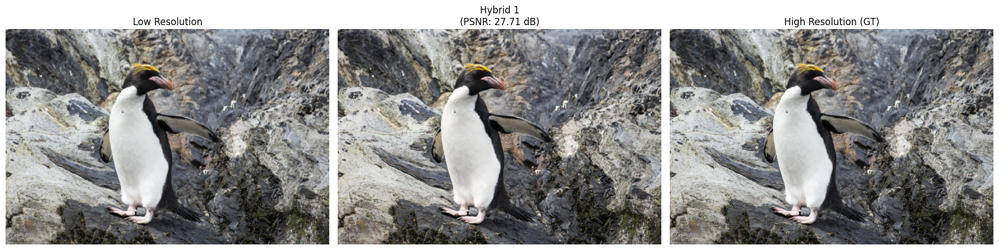

In [39]:
print("\nVisual Comparison for Hybrid 1 (SRCNN + VGG Loss) on a Test Image:")
if 'hybrid1_model' in locals() and test_loader:
    models_to_visualize = {"Hybrid 1": hybrid1_model}
    # Pass scale_factor to the updated function
    visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
else:
    print("Hybrid 1 model or test loader not available for visualization.")

In [55]:
import torch

model_path = "/content/hybrid1_best_model_.pth"

try:
    print(f"--- Inspecting: {model_path} ---")
    state_dict = torch.load(model_path, map_location="cpu") # Load onto CPU to avoid GPU issues
    print(f"Keys found:\n{list(state_dict.keys())}")
except FileNotFoundError:
    print(f"Error: File not found at {model_path}")
except Exception as e:
    print(f"An error occurred: {e}")
print("-"*30)

--- Inspecting: /content/hybrid1_best_model_.pth ---
Keys found:
['conv1.weight', 'conv1.bias', 'conv2.weight', 'conv2.bias', 'conv3.weight', 'conv3.bias']
------------------------------


In [56]:
eval_model_h1 = SRCNN().to(cpu_device)

In [57]:
model_path_h1 = "/content/hybrid1_best_model_.pth"

try:
    print(f"Loading weights from: {model_path_h1}")
    eval_model_h1.load_state_dict(torch.load(model_path_h1, map_location=cpu_device))
    eval_model_h1.eval()
except Exception as e:
    print(f"Error loading model: {e}")

Loading weights from: /content/hybrid1_best_model_.pth


In [30]:
# Evaluate Saved Model (Hybrid 1 - SRCNN with Pre-Upsampling on CPU)

import torch
import torch.nn.functional as F
from pytorch_msssim import ssim
import lpips
from tqdm.notebook import tqdm
import numpy as np

print("\n--- Evaluating Hybrid 1 (SRCNN with Pre-Upsampling) on CPU --- ")

# Define device as CPU
cpu_device = torch.device("cpu")

# --- 1. Define Model Architecture (SRCNN) ---
if 'SRCNN' not in locals():
    print("Error: SRCNN class definition not found.")
else:
    print("Instantiating SRCNN model architecture for Hybrid 1...")
    eval_model_h1 = SRCNN().to(cpu_device)

    # --- 2. Load Saved Weights ---
    model_path_h1 = "/content/hybrid1_best_model_.pth" # <<< CHECK/CORRECT PATH

    try:
        print(f"Loading weights from: {model_path_h1}")
        eval_model_h1.load_state_dict(torch.load(model_path_h1, map_location=cpu_device))
        eval_model_h1.eval()
        print("Model weights loaded successfully.")

        # --- 3. Choose Dataloader ---
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1 for evaluation")
                target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=False)
            print("Using validation set for evaluation.")

            # --- 4. Run Evaluations (on CPU) ---

            # Re-define evaluation functions locally to include upsampling for SRCNN
            def evaluate_srcnn_ssim(model, loader, device, scale_factor):
                model.eval()
                total_ssim = 0.0
                num_images = 0
                with torch.no_grad():
                    progress_bar = tqdm(loader, desc="Evaluating SRCNN SSIM", leave=False)
                    for lr_imgs, hr_imgs in progress_bar:
                        lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

                        #  Upsample LR image first
                        target_h, target_w = hr_imgs.shape[-2:]
                        upsampled_lr = F.interpolate(lr_imgs, size=(target_h, target_w), mode='bicubic', align_corners=False)

                        # Pass upsampled image to SRCNN
                        sr_imgs = model(upsampled_lr)

                        sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
                        hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)
                        batch_ssim = ssim(sr_imgs, hr_imgs, data_range=1.0, size_average=False)
                        total_ssim += torch.sum(batch_ssim).item()
                        num_images += lr_imgs.size(0)
                        if num_images > 0:
                            running_avg_ssim = total_ssim / num_images
                            progress_bar.set_postfix({"Avg SSIM": f"{running_avg_ssim:.4f}"})
                avg_ssim = total_ssim / num_images if num_images > 0 else 0
                print(f"\nAverage SSIM on {num_images} images: {avg_ssim:.4f}")
                return avg_ssim

            def evaluate_srcnn_lpips(model, loader, device, scale_factor):
                model.eval()
                try:
                    loss_fn_alex = lpips.LPIPS(net='alex').to(device)
                    loss_fn_alex.eval()
                except Exception as e:
                    print(f"Error initializing LPIPS model: {e}")
                    return None
                total_lpips = 0.0
                num_images = 0
                with torch.no_grad():
                    progress_bar = tqdm(loader, desc="Evaluating SRCNN LPIPS", leave=False)
                    for lr_imgs, hr_imgs in progress_bar:
                        lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

                        # Upsample LR image first
                        target_h, target_w = hr_imgs.shape[-2:]
                        upsampled_lr = F.interpolate(lr_imgs, size=(target_h, target_w), mode='bicubic', align_corners=False)

                        # Pass upsampled image to SRCNN
                        sr_imgs = model(upsampled_lr)

                        sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
                        hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)
                        sr_imgs_norm = sr_imgs * 2.0 - 1.0
                        hr_imgs_norm = hr_imgs * 2.0 - 1.0
                        batch_lpips = loss_fn_alex(sr_imgs_norm, hr_imgs_norm)
                        total_lpips += torch.sum(batch_lpips).item()
                        num_images += lr_imgs.size(0)
                        if num_images > 0:
                            running_avg_lpips = total_lpips / num_images
                            progress_bar.set_postfix({"Avg LPIPS": f"{running_avg_lpips:.4f}"})
                avg_lpips = total_lpips / num_images if num_images > 0 else float('inf')
                print(f"\nAverage LPIPS on {num_images} images: {avg_lpips:.4f} (Lower is better)")
                return avg_lpips

            # --- Run SRCNN-specific Evaluations (on CPU) ---
            print("\n--- Evaluating SSIM for Hybrid 1 (SRCNN) on CPU --- ")
            # Pass cpu_device and scale_factor (assuming scale_factor is defined)
            h1_avg_ssim = evaluate_srcnn_ssim(eval_model_h1, target_loader, cpu_device, scale_factor)

            print("\n--- Evaluating LPIPS for Hybrid 1 (SRCNN) on CPU --- ")
            h1_avg_lpips = evaluate_srcnn_lpips(eval_model_h1, target_loader, cpu_device, scale_factor)

            print(f"\n--- Results for Hybrid 1 ({model_path_h1} - SRCNN) ---")
            print(f"Average SSIM: {h1_avg_ssim:.4f}")
            print(f"Average LPIPS: {h1_avg_lpips:.4f} (Lower is better)")

            del eval_model_h1

        else:
            print("Error: Validation loader (e.g., val_loader_h3) not found.")

    except FileNotFoundError:
        print(f"Error: Model weights file not found at {model_path_h1}. Please check the path.")
    except NameError as e:
        # Catch if scale_factor is not defined
        print(f"Error: A required variable might be missing (e.g., scale_factor): {e}")
    except RuntimeError as e:
        print(f"Error loading state_dict or during evaluation: {e}")
    except Exception as e:
        print(f"An error occurred during evaluation: {e}")


--- Evaluating Hybrid 1 (SRCNN with Pre-Upsampling) on CPU --- 
Instantiating SRCNN model architecture for Hybrid 1...
Loading weights from: /content/hybrid1_best_model_.pth
Model weights loaded successfully.
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 1 (SRCNN) on CPU --- 


Evaluating SRCNN SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7386

--- Evaluating LPIPS for Hybrid 1 (SRCNN) on CPU --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 207MB/s]


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating SRCNN LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.4535 (Lower is better)

--- Results for Hybrid 1 (/content/hybrid1_best_model_.pth - SRCNN) ---
Average SSIM: 0.7386
Average LPIPS: 0.4535 (Lower is better)


### 6.2 Hybrid 2: EDSR + L1 + SSIM Loss

In [32]:
import torch
import torch.nn as nn
import torch.optim as optim
from pytorch_msssim import ssim

# Define Loss for Hybrid 2
class Hybrid2Loss(nn.Module):
    def __init__(self, l1_weight=1.0, ssim_weight=0.1, data_range=1.0):
        super(Hybrid2Loss, self).__init__()
        self.l1_weight = l1_weight
        self.ssim_weight = ssim_weight
        self.data_range = data_range
        self.l1_loss = nn.L1Loss()
        print(f"Hybrid2Loss initialized with L1 weight: {l1_weight}, SSIM weight: {ssim_weight}")

    def forward(self, sr_imgs, hr_imgs):
        loss_l1 = self.l1_loss(sr_imgs, hr_imgs)
        loss_ssim = 1.0 - ssim(sr_imgs, hr_imgs, data_range=self.data_range, size_average=True)
        total_loss = (self.l1_weight * loss_l1) + (self.ssim_weight * loss_ssim)
        return total_loss

# --- Instantiate Enhanced Model, Loss, Optimizer, Scheduler ---

# Check EDSR
if 'EDSR' not in locals():
    print("Error: EDSR class not defined. Please run the cell in Section 2.5 first.")
else:
    # Instantiate Model with 32 residual blocks using EDSR class
    print("Instantiating Enhanced EDSR (32 res blocks)...")
    hybrid2_model = EDSR(num_res_blocks=32, num_features=64, scale_factor=scale_factor).to(device)

    # Instantiate Loss (adjust weights here if desired)
    hybrid2_criterion = Hybrid2Loss(l1_weight=1.0, ssim_weight=0.1)

    # Instantiate Optimizer
    hybrid2_optimizer = optim.Adam(hybrid2_model.parameters(), lr=1e-4)

    # Add Cosine Annealing Learning Rate Scheduler
    if 'num_epochs_hybrid' not in locals():
        num_epochs_hybrid = 50
        print(f"Warning: num_epochs_hybrid not defined, using default: {num_epochs_hybrid}")

    hybrid2_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(hybrid2_optimizer, T_max=num_epochs_hybrid, eta_min=1e-6)
    print(f"Using CosineAnnealingLR scheduler with T_max={num_epochs_hybrid}, eta_min=1e-6")

    # --- Train the Enhanced Hybrid 2 Model ---
    # # Check train_model
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    else:
        # Call the updated training function, passing the scheduler
        hybrid2_model, hybrid2_history = train_model(
            hybrid2_model, "Hybrid 2 (EDSR + L1 + SSIM - Enhanced)",
            train_loader, val_loader,
            hybrid2_criterion, hybrid2_optimizer,
            num_epochs_hybrid, device,
            scheduler=hybrid2_scheduler
        )


Instantiating Enhanced EDSR (32 res blocks)...
Hybrid2Loss initialized with L1 weight: 1.0, SSIM weight: 0.1
Using CosineAnnealingLR scheduler with T_max=50, eta_min=1e-6

--- Training Hybrid 2 (EDSR + L1 + SSIM - Enhanced) ---


Epoch 1/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/50 - Train Loss: 0.1814, Val PSNR: 21.77 dB
  -> New best model saved with Val PSNR: 21.77 dB


Epoch 2/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/50 - Train Loss: 0.1038, Val PSNR: 22.74 dB
  -> New best model saved with Val PSNR: 22.74 dB


Epoch 3/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/50 - Train Loss: 0.0899, Val PSNR: 24.30 dB
  -> New best model saved with Val PSNR: 24.30 dB


Epoch 4/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/50 - Train Loss: 0.0764, Val PSNR: 24.95 dB
  -> New best model saved with Val PSNR: 24.95 dB


Epoch 5/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/50 - Train Loss: 0.0708, Val PSNR: 24.85 dB


Epoch 6/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/50 - Train Loss: 0.0677, Val PSNR: 25.15 dB
  -> New best model saved with Val PSNR: 25.15 dB


Epoch 7/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/50 - Train Loss: 0.0650, Val PSNR: 25.89 dB
  -> New best model saved with Val PSNR: 25.89 dB


Epoch 8/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/50 - Train Loss: 0.0645, Val PSNR: 25.36 dB


Epoch 9/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/50 - Train Loss: 0.0642, Val PSNR: 25.99 dB
  -> New best model saved with Val PSNR: 25.99 dB


Epoch 10/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/50 - Train Loss: 0.0589, Val PSNR: 26.24 dB
  -> New best model saved with Val PSNR: 26.24 dB


Epoch 11/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/50 - Train Loss: 0.0601, Val PSNR: 26.27 dB
  -> New best model saved with Val PSNR: 26.27 dB


Epoch 12/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/50 - Train Loss: 0.0588, Val PSNR: 25.91 dB


Epoch 13/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/50 - Train Loss: 0.0581, Val PSNR: 26.21 dB


Epoch 14/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/50 - Train Loss: 0.0590, Val PSNR: 26.31 dB
  -> New best model saved with Val PSNR: 26.31 dB


Epoch 15/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/50 - Train Loss: 0.0552, Val PSNR: 26.49 dB
  -> New best model saved with Val PSNR: 26.49 dB


Epoch 16/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/50 - Train Loss: 0.0569, Val PSNR: 26.43 dB


Epoch 17/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/50 - Train Loss: 0.0557, Val PSNR: 26.43 dB


Epoch 18/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/50 - Train Loss: 0.0519, Val PSNR: 26.68 dB
  -> New best model saved with Val PSNR: 26.68 dB


Epoch 19/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/50 - Train Loss: 0.0574, Val PSNR: 26.62 dB


Epoch 20/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/50 - Train Loss: 0.0533, Val PSNR: 25.78 dB


Epoch 21/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/50 - Train Loss: 0.0555, Val PSNR: 26.56 dB


Epoch 22/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/50 - Train Loss: 0.0540, Val PSNR: 26.72 dB
  -> New best model saved with Val PSNR: 26.72 dB


Epoch 23/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/50 - Train Loss: 0.0529, Val PSNR: 26.67 dB


Epoch 24/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/50 - Train Loss: 0.0521, Val PSNR: 26.72 dB
  -> New best model saved with Val PSNR: 26.72 dB


Epoch 25/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/50 - Train Loss: 0.0539, Val PSNR: 26.81 dB
  -> New best model saved with Val PSNR: 26.81 dB


Epoch 26/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/50 - Train Loss: 0.0534, Val PSNR: 26.76 dB


Epoch 27/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/50 - Train Loss: 0.0527, Val PSNR: 26.27 dB


Epoch 28/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/50 - Train Loss: 0.0535, Val PSNR: 26.83 dB
  -> New best model saved with Val PSNR: 26.83 dB


Epoch 29/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/50 - Train Loss: 0.0515, Val PSNR: 26.87 dB
  -> New best model saved with Val PSNR: 26.87 dB


Epoch 30/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/50 - Train Loss: 0.0529, Val PSNR: 26.76 dB


Epoch 31/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/50 - Train Loss: 0.0534, Val PSNR: 26.84 dB


Epoch 32/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/50 - Train Loss: 0.0533, Val PSNR: 26.86 dB


Epoch 33/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/50 - Train Loss: 0.0525, Val PSNR: 26.83 dB


Epoch 34/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/50 - Train Loss: 0.0538, Val PSNR: 26.86 dB


Epoch 35/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/50 - Train Loss: 0.0528, Val PSNR: 26.93 dB
  -> New best model saved with Val PSNR: 26.93 dB


Epoch 36/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/50 - Train Loss: 0.0506, Val PSNR: 26.94 dB
  -> New best model saved with Val PSNR: 26.94 dB


Epoch 37/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/50 - Train Loss: 0.0502, Val PSNR: 26.94 dB


Epoch 38/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/50 - Train Loss: 0.0536, Val PSNR: 26.96 dB
  -> New best model saved with Val PSNR: 26.96 dB


Epoch 39/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/50 - Train Loss: 0.0512, Val PSNR: 26.96 dB
  -> New best model saved with Val PSNR: 26.96 dB


Epoch 40/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/50 - Train Loss: 0.0490, Val PSNR: 26.96 dB
  -> New best model saved with Val PSNR: 26.96 dB


Epoch 41/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/50 - Train Loss: 0.0519, Val PSNR: 26.97 dB
  -> New best model saved with Val PSNR: 26.97 dB


Epoch 42/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/50 - Train Loss: 0.0524, Val PSNR: 26.97 dB
  -> New best model saved with Val PSNR: 26.97 dB


Epoch 43/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/50 - Train Loss: 0.0491, Val PSNR: 26.97 dB
  -> New best model saved with Val PSNR: 26.97 dB


Epoch 44/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/50 - Train Loss: 0.0497, Val PSNR: 26.98 dB
  -> New best model saved with Val PSNR: 26.98 dB


Epoch 45/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/50 - Train Loss: 0.0524, Val PSNR: 26.98 dB


Epoch 46/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/50 - Train Loss: 0.0528, Val PSNR: 26.98 dB
  -> New best model saved with Val PSNR: 26.98 dB


Epoch 47/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/50 - Train Loss: 0.0517, Val PSNR: 26.98 dB
  -> New best model saved with Val PSNR: 26.98 dB


Epoch 48/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/50 - Train Loss: 0.0506, Val PSNR: 26.98 dB
  -> New best model saved with Val PSNR: 26.98 dB


Epoch 49/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/50 - Train Loss: 0.0489, Val PSNR: 26.98 dB


Epoch 50/50 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/50 - Train Loss: 0.0522, Val PSNR: 26.98 dB
--- Finished Training Hybrid 2 (EDSR + L1 + SSIM - Enhanced) ---
Loaded best model state with Val PSNR: 26.98 dB


In [33]:
hybrid2_model

EDSR(
  (head): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   

In [48]:
import torch

# Save model weights
torch.save(hybrid2_model.state_dict(), 'hybrid2_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid2_model, 'full_hybrid2_model.pth')


Visual Comparison for Hybrid 2 (EDSR + L1 + SSIM - Enhanced) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


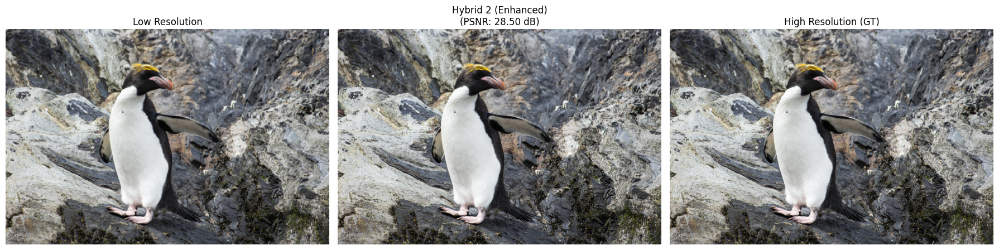

In [38]:
print("\nVisual Comparison for Hybrid 2 (EDSR + L1 + SSIM - Enhanced) on a Test Image:")
if 'hybrid2_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 2 (Enhanced)": hybrid2_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 2 model or test loader not available for visualization.")

In [39]:
import torch
model_path = "/content/data/hybrid2_best_model.pth"
try:
    print(f"--- Inspecting: {model_path} ---")
    state_dict = torch.load(model_path, map_location="cpu")
    print(f"Keys found for Hybrid 2:\n{list(state_dict.keys())}")
except Exception as e:
    print(f"Error inspecting {model_path}: {e}")
print("-"*30)

--- Inspecting: /content/data/hybrid2_best_model.pth ---
Keys found for Hybrid 2:
['head.weight', 'head.bias', 'body.0.conv1.weight', 'body.0.conv1.bias', 'body.0.conv2.weight', 'body.0.conv2.bias', 'body.1.conv1.weight', 'body.1.conv1.bias', 'body.1.conv2.weight', 'body.1.conv2.bias', 'body.2.conv1.weight', 'body.2.conv1.bias', 'body.2.conv2.weight', 'body.2.conv2.bias', 'body.3.conv1.weight', 'body.3.conv1.bias', 'body.3.conv2.weight', 'body.3.conv2.bias', 'body.4.conv1.weight', 'body.4.conv1.bias', 'body.4.conv2.weight', 'body.4.conv2.bias', 'body.5.conv1.weight', 'body.5.conv1.bias', 'body.5.conv2.weight', 'body.5.conv2.bias', 'body.6.conv1.weight', 'body.6.conv1.bias', 'body.6.conv2.weight', 'body.6.conv2.bias', 'body.7.conv1.weight', 'body.7.conv1.bias', 'body.7.conv2.weight', 'body.7.conv2.bias', 'body.8.conv1.weight', 'body.8.conv1.bias', 'body.8.conv2.weight', 'body.8.conv2.bias', 'body.9.conv1.weight', 'body.9.conv1.bias', 'body.9.conv2.weight', 'body.9.conv2.bias', 'body.10.

In [40]:
# Evaluate (Hybrid 2)

print("--- Evaluating Hybrid 2 --- ")

# Define Model Architecture (EDSR, 32 blocks, 64 features)
if 'EDSR' not in locals():
    print("Error: EDSR class definition not found.")
else:
    print("Instantiating model architecture for Hybrid 2...")
    eval_model_h2 = EDSR(num_res_blocks=32, num_features=64, scale_factor=scale_factor).to(device)

    # Load Saved Weights
    model_path_h2 = "/content/data/hybrid2_best_model.pth"

    try:
        print(f"Loading weights from: {model_path_h2}")
        eval_model_h2.load_state_dict(torch.load(model_path_h2, map_location=device))
        eval_model_h2.eval()
        print("Model weights loaded successfully.")

        # Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1 for evaluation")
                target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)
            print("Using validation set for evaluation.")

            # Run Evaluations
            print("\n--- Evaluating SSIM for Hybrid 2 --- ")
            h2_avg_ssim = evaluate_model_ssim(eval_model_h2, target_loader, device)

            print("\n--- Evaluating LPIPS for Hybrid 2 --- ")
            h2_avg_lpips = evaluate_model_lpips(eval_model_h2, target_loader, device)

            print(f"\n--- Results for Hybrid 2 ({model_path_h2}) ---")
            print(f"Average SSIM: {h2_avg_ssim:.4f}")
            print(f"Average LPIPS: {h2_avg_lpips:.4f} (Lower is better)")

        else:
            print("Error: Validation loader (e.g., val_loader_h3) not found.")

    except FileNotFoundError:
        print(f"Error: Model weights file not found at {model_path_h2}. Please check the path.")
    except Exception as e:
        print(f"An error occurred during evaluation: {e}")

--- Evaluating Hybrid 2 --- 
Instantiating model architecture for Hybrid 2...
Loading weights from: /content/data/hybrid2_best_model.pth
Model weights loaded successfully.
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 2 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7677

--- Evaluating LPIPS for Hybrid 2 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.3765 (Lower is better)

--- Results for Hybrid 2 (/content/data/hybrid2_best_model.pth) ---
Average SSIM: 0.7677
Average LPIPS: 0.3765 (Lower is better)


In [41]:
# Extra step (just for testing if TTA could enahnce the model)
# Define Test-Time Augmentation (TTA) Evaluation Function

import torch
import torch.nn.functional as F
import numpy as np
from tqdm.notebook import tqdm
import math

def apply_tta_transform(img_tensor, transform_idx):
    """Applies one of the 8 geometric transformations to an image tensor (NCHW)."""
    if transform_idx == 0: # Identity
        return img_tensor
    elif transform_idx == 1: # Flip Horizontal
        return torch.flip(img_tensor, dims=[3])
    elif transform_idx == 2: # Rotate 90
        return torch.rot90(img_tensor, k=1, dims=(2, 3))
    elif transform_idx == 3: # Rotate 180
        return torch.rot90(img_tensor, k=2, dims=(2, 3))
    elif transform_idx == 4: # Rotate 270
        return torch.rot90(img_tensor, k=3, dims=(2, 3))
    elif transform_idx == 5: # Flip Horizontal + Rotate 90
        return torch.rot90(torch.flip(img_tensor, dims=[3]), k=1, dims=(2, 3))
    elif transform_idx == 6: # Flip Horizontal + Rotate 180
        return torch.rot90(torch.flip(img_tensor, dims=[3]), k=2, dims=(2, 3))
    elif transform_idx == 7: # Flip Horizontal + Rotate 270
        return torch.rot90(torch.flip(img_tensor, dims=[3]), k=3, dims=(2, 3))
    else:
        raise ValueError(f"Invalid transform_idx: {transform_idx}")

def apply_inverse_tta_transform(img_tensor, transform_idx):
    """Applies the inverse of one of the 8 geometric transformations."""
    if transform_idx == 0: # Identity
        return img_tensor
    elif transform_idx == 1: # Flip Horizontal
        return torch.flip(img_tensor, dims=[3]) # Inverse is itself
    elif transform_idx == 2: # Rotate 90 -> Inverse Rotate 270 (-90)
        return torch.rot90(img_tensor, k=-1, dims=(2, 3))
    elif transform_idx == 3: # Rotate 180 -> Inverse Rotate 180
        return torch.rot90(img_tensor, k=-2, dims=(2, 3))
    elif transform_idx == 4: # Rotate 270 -> Inverse Rotate 90 (-270)
        return torch.rot90(img_tensor, k=-3, dims=(2, 3))
    elif transform_idx == 5: # Flip H + Rot 90 -> Inverse Rot 270 + Flip H
        return torch.flip(torch.rot90(img_tensor, k=-1, dims=(2, 3)), dims=[3])
    elif transform_idx == 6: # Flip H + Rot 180 -> Inverse Rot 180 + Flip H
        return torch.flip(torch.rot90(img_tensor, k=-2, dims=(2, 3)), dims=[3])
    elif transform_idx == 7: # Flip H + Rot 270 -> Inverse Rot 90 + Flip H
        return torch.flip(torch.rot90(img_tensor, k=-3, dims=(2, 3)), dims=[3])
    else:
        raise ValueError(f"Invalid transform_idx: {transform_idx}")

def evaluate_model_psnr_tta(model, loader, device):
    """Evaluates model PSNR using Test-Time Augmentation (8 geometric transforms)."""
    model.eval()
    model.to(device)
    total_psnr = 0.0
    num_images = 0

    with torch.no_grad():
        eval_pbar = tqdm(loader, desc="Evaluating with TTA")
        for lr_imgs, hr_imgs in eval_pbar:
            lr_imgs = lr_imgs.to(device) # Should be Batch Size 1 for TTA
            hr_imgs = hr_imgs.to(device)

            if lr_imgs.size(0) != 1:
                print("Error: TTA evaluation requires batch size 1. Skipping batch.")
                continue

            sr_outputs_ensembled = []

            # Apply 8 transformations
            for i in range(8):
                # 1. Transform LR input
                transformed_lr = apply_tta_transform(lr_imgs, i)

                # 2. Get SR prediction
                try:
                    transformed_sr = model(transformed_lr)
                except Exception as e:
                    print(f"Error during TTA inference (transform {i}): {e}. Skipping transform.")
                    continue # Skip this transform if model fails

                # 3. Apply inverse transform to SR output
                sr_output = apply_inverse_tta_transform(transformed_sr, i)
                sr_outputs_ensembled.append(sr_output)

            if not sr_outputs_ensembled:
                print("Warning: No successful TTA inferences for this image. Skipping.")
                continue

            # 4. Average the results
            ensembled_sr = torch.stack(sr_outputs_ensembled).mean(dim=0)
            ensembled_sr = torch.clamp(ensembled_sr, 0.0, 1.0) # Clamp results

            # 5. Calculate PSNR
            mse = F.mse_loss(ensembled_sr, hr_imgs)
            if mse.item() == 0:
                psnr = float("inf") # Or a very high value like 100.0
            else:
                psnr = 10 * torch.log10(1.0 / mse)

            total_psnr += psnr.item()
            num_images += 1
            eval_pbar.set_postfix({"Current PSNR (TTA)": f"{psnr.item():.2f} dB"})

    avg_psnr = total_psnr / num_images if num_images > 0 else 0
    print(f"\nAverage PSNR (TTA) on {num_images} images: {avg_psnr:.2f} dB")
    return avg_psnr

print("TTA evaluation function defined: evaluate_model_psnr_tta")

TTA evaluation function defined: evaluate_model_psnr_tta


In [42]:
# Evaluate Hybrid 2 with Test-Time Augmentation (TTA)

# Ensure the model, loader, and TTA function are available
if 'hybrid2_model' in locals() and 'val_loader' in locals() and 'evaluate_model_psnr_tta' in locals():
    print("\n--- Evaluating Hybrid 2 (EDSR - Enhanced) with TTA on Validation Set ---")
    hybrid2_model.to(device)

    # Check validation loader batch size - TTA requires batch_size=1
    if val_loader.batch_size != 1:
        print(f"Warning: Validation loader batch size is {val_loader.batch_size}. TTA expects 1.")
        print("Creating a temporary validation loader with batch_size=1 for TTA...")
        if 'val_dataset' in locals():
            # Make sure DataLoader is imported: from torch.utils.data import DataLoader
            tta_val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)
            avg_psnr_tta = evaluate_model_psnr_tta(hybrid2_model, tta_val_loader, device)
            print(f"\nFinal Average Validation PSNR (with TTA): {avg_psnr_tta:.2f} dB")
        else:
            print("Error: 'val_dataset' not found. Cannot create TTA loader automatically.")
            print("Please manually create a DataLoader with batch_size=1 for the validation set.")
    else:
        print("Validation loader batch size is 1. Proceeding with TTA evaluation...")
        avg_psnr_tta = evaluate_model_psnr_tta(hybrid2_model, val_loader, device)
        print(f"\nFinal Average Validation PSNR (with TTA): {avg_psnr_tta:.2f} dB")

    if 'test_loader' in locals():
        print("\n--- Evaluating Hybrid 2 (EDSR - Enhanced) with TTA on Test Set ---")
        if test_loader.batch_size != 1:
            print(f"Warning: Test loader batch size is {test_loader.batch_size}. TTA expects 1.")
            print("Creating a temporary test loader with batch_size=1 for TTA...")
            if 'test_dataset' in locals():
                 tta_test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)
                 test_psnr_tta = evaluate_model_psnr_tta(hybrid2_model, tta_test_loader, device)
                 print(f"\nFinal Average Test PSNR (with TTA): {test_psnr_tta:.2f} dB")
            else:
                 print("Error: 'test_dataset' not found. Cannot create TTA loader automatically.")
        else:
            print("Test loader batch size is 1. Proceeding with TTA evaluation...")
            test_psnr_tta = evaluate_model_psnr_tta(hybrid2_model, test_loader, device)
            print(f"\nFinal Average Test PSNR (with TTA): {test_psnr_tta:.2f} dB")

else:
    missing = []
    if 'hybrid2_model' not in locals(): missing.append("'hybrid2_model'")
    if 'val_loader' not in locals(): missing.append("'val_loader'")
    if 'evaluate_model_psnr_tta' not in locals(): missing.append("'evaluate_model_psnr_tta' function (run Cell 1?)")
    print(f"Cannot run TTA evaluation. Missing: {', '.join(missing)}.")


--- Evaluating Hybrid 2 (EDSR - Enhanced) with TTA on Validation Set ---
Validation loader batch size is 1. Proceeding with TTA evaluation...


Evaluating with TTA:   0%|          | 0/80 [00:00<?, ?it/s]


Average PSNR (TTA) on 80 images: 27.08 dB

Final Average Validation PSNR (with TTA): 27.08 dB

--- Evaluating Hybrid 2 (EDSR - Enhanced) with TTA on Test Set ---
Test loader batch size is 1. Proceeding with TTA evaluation...


Evaluating with TTA:   0%|          | 0/100 [00:00<?, ?it/s]


Average PSNR (TTA) on 100 images: 27.52 dB

Final Average Test PSNR (with TTA): 27.52 dB


### 6.3. Hybrid 3: EDSR (32b, 64f) + L1 + SSIM Loss (100 epochs, Augmentation)

In [44]:
import torchvision.transforms as transforms
from PIL import Image

print("Defining transforms for Hybrid 3 (with augmentation)...")

# Define transforms with augmentation for training
train_transform_aug = transforms.Compose([
    transforms.RandomHorizontalFlip(), # Add horizontal flips
    transforms.RandomVerticalFlip(),   # Add vertical flips
    transforms.RandomRotation(degrees=90),
    transforms.ToTensor()
])

# Validation/Test transforms remain the same (no augmentation)
val_test_transform = transforms.Compose([
    transforms.ToTensor()
])

print("Transforms for Hybrid 3 defined.")

Defining transforms for Hybrid 3 (with augmentation)...
Transforms for Hybrid 3 defined.


In [45]:
# Define Augmented Transforms for Hybrid 3

import torchvision.transforms as transforms
from PIL import Image # Ensure PIL is imported

print("Defining transforms for Hybrid 3 (with augmentation)...")

# Define transforms with augmentation for training
# Using RandomHorizontalFlip and RandomVerticalFlip
train_transform_aug = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.ToTensor()
])

# Validation/Test transforms remain the same (no augmentation)
# Ensure val_test_transform is defined from previous sections, or redefine it here:
if 'val_test_transform' not in locals():
    val_test_transform = transforms.Compose([
        transforms.ToTensor()
    ])
    print("Defined val_test_transform.")
else:
    print("Using existing val_test_transform.")

print("Transforms for Hybrid 3 defined (train_transform_aug, val_test_transform).")


Defining transforms for Hybrid 3 (with augmentation)...
Using existing val_test_transform.
Transforms for Hybrid 3 defined (train_transform_aug, val_test_transform).


In [46]:
# Create DataLoaders for Hybrid 3

from torch.utils.data import DataLoader, Subset

print("Creating DataLoaders for Hybrid 3...")

# Check if dataset splits exist
if 'train_subset' in locals() and 'val_subset' in locals() and 'test_dataset' in locals():
    try:
        train_batch_size = 8
        print(f"Creating train_loader_aug with batch size {train_batch_size}.")
        print("Attempting to associate train_transform_aug for this loader.")

        # Temporarily modify the transform of the underlying dataset used by train_subset
        original_transform = None
        target_dataset_for_transform = None
        try:
            # train_subset is a Subset, its underlying dataset is train_subset.dataset
            target_dataset_for_transform = train_subset.dataset

            if hasattr(target_dataset_for_transform, 'transform'):
                original_transform = target_dataset_for_transform.transform
                target_dataset_for_transform.transform = train_transform_aug # Apply augmented transform
                print("Temporarily set transform on underlying dataset (train_subset.dataset) for train_loader_aug.")
            else:
                print("Warning: Underlying dataset object (train_subset.dataset) does not have a 'transform' attribute. Augmentation might not apply this way.")

        except Exception as e:
             print(f"Warning: Could not directly set transform: {e}. Augmentation might not apply.")

        # Create the new training loader using the existing train_subset
        train_loader_aug = DataLoader(train_subset,
                                    batch_size=train_batch_size,
                                    shuffle=True,
                                    num_workers=2,
                                    pin_memory=True)

        # Restore original transform ---
        if original_transform is not None and target_dataset_for_transform is not None:
            try:
                # Restore the original transform on the underlying dataset
                target_dataset_for_transform.transform = original_transform
                print("Restored original transform on underlying dataset (train_subset.dataset).")
            except Exception as e:
                 print(f"Warning: Could not restore original transform: {e}")
        elif target_dataset_for_transform is not None:
             print("No original transform was stored or target dataset found; assuming no change needed or Dataset handles it internally.")

        print("\nVERIFICATION RECOMMENDED (run in a new cell):")
        print("Visualize a batch from 'train_loader_aug' to confirm augmentation:")
        print("import matplotlib.pyplot as plt; import torchvision; data_iter = iter(train_loader_aug); imgs, _ = next(data_iter); plt.imshow(torchvision.utils.make_grid(imgs).permute(1, 2, 0)); plt.show()")

        # Create new Val/Test loaders using the existing val_subset and test_dataset
        # Ensure they use the standard val_test_transform (should be handled by their dataset objects)
        val_loader_h3 = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)
        test_loader_h3 = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True)

        print(f"\nCreated train_loader_aug (Batch: {train_batch_size}), val_loader_h3 (Batch: 1), test_loader_h3 (Batch: 1).")

    except Exception as e:
        print(f"Error creating DataLoaders: {e}")
else:
    # Update error message with correct variable names
    missing_vars = []
    if 'train_subset' not in locals(): missing_vars.append('train_subset')
    if 'val_subset' not in locals(): missing_vars.append('val_subset')
    if 'test_dataset' not in locals(): missing_vars.append('test_dataset')
    print(f"Error: Dataset splits ({', '.join(missing_vars)}) not found.")



Creating DataLoaders for Hybrid 3...
Creating train_loader_aug with batch size 8.
Attempting to associate train_transform_aug for this loader.
Temporarily set transform on underlying dataset (train_subset.dataset) for train_loader_aug.
Restored original transform on underlying dataset (train_subset.dataset).

VERIFICATION RECOMMENDED (run in a new cell):
Visualize a batch from 'train_loader_aug' to confirm augmentation:
import matplotlib.pyplot as plt; import torchvision; data_iter = iter(train_loader_aug); imgs, _ = next(data_iter); plt.imshow(torchvision.utils.make_grid(imgs).permute(1, 2, 0)); plt.show()

Created train_loader_aug (Batch: 8), val_loader_h3 (Batch: 1), test_loader_h3 (Batch: 1).


Visualizing a batch from train_loader_aug to check augmentation...


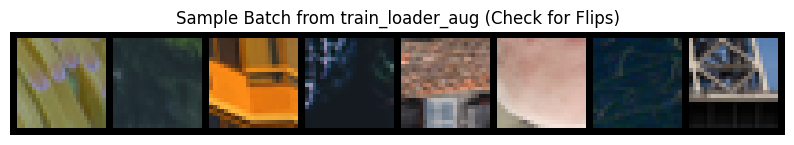

In [47]:
# Verification Cell
import matplotlib.pyplot as plt
import torchvision

print("Visualizing a batch from train_loader_aug to check augmentation...")
data_iter = iter(train_loader_aug)
imgs, _ = next(data_iter)
plt.figure(figsize=(10,10))
plt.imshow(torchvision.utils.make_grid(imgs).permute(1, 2, 0))
plt.title("Sample Batch from train_loader_aug (Check for Flips)")
plt.axis("off")
plt.show()

In [60]:
# Setup and Train Hybrid 3 (EDSR + L1 + SSIM - 100 Epochs + Aug)

import torch
import torch.nn as nn
import torch.optim as optim
from pytorch_msssim import ssim

# Define number of epochs for this experiment
num_epochs_hybrid3 = 100

# Define Loss (using the same Hybrid2Loss class definition from before)
if 'Hybrid2Loss' not in locals():
    print("Error: Hybrid2Loss class definition not found. Please run that cell first.")
else:
    hybrid3_criterion = Hybrid2Loss(l1_weight=1.0, ssim_weight=0.1)

# --- Instantiate New Model, Optimizer, Scheduler ---

# Ensure EDSR class definition (Section 2.5) and Loss are defined
if 'EDSR' not in locals():
    print("Error: EDSR class not defined. Please run the cell in Section 2.5 first.")
elif 'hybrid3_criterion' not in locals():
    print("Error: Loss function for Hybrid 3 not defined.")
else:
    # Instantiate New Model (32 res blocks, 64 features)
    print(f"Instantiating NEW Enhanced EDSR model (Hybrid 3) for {num_epochs_hybrid3} epochs with augmentation...")
    hybrid3_model = EDSR(num_res_blocks=32, num_features=64, scale_factor=scale_factor).to(device)

    # Instantiate New Optimizer
    hybrid3_optimizer = optim.Adam(hybrid3_model.parameters(), lr=1e-4)

    # Instantiate New Scheduler with T_max=100
    hybrid3_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        hybrid3_optimizer,
        T_max=num_epochs_hybrid3, # Use 100 epochs
        eta_min=1e-6
    )
    print(f"Using CosineAnnealingLR scheduler with T_max={num_epochs_hybrid3}, eta_min=1e-6")

    # --- Train the New Hybrid 3 Model ---
    # Ensure train_model function (Section 3.1) and loaders are defined
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    elif 'train_loader_aug' not in locals() or 'val_loader_h3' not in locals():
        print("Error: DataLoaders for Hybrid 3 (train_loader_aug, val_loader_h3) not found. Run Cell 2 first.")
    else:
        # Call the training function with the new variables
        print("Starting training for Hybrid 3...")
        hybrid3_model, hybrid3_history = train_model(
            hybrid3_model, "Hybrid 3 (EDSR + L1 + SSIM - 100 Epochs + Aug)",
            train_loader_aug, val_loader_h3, # Use the new loaders
            hybrid3_criterion, hybrid3_optimizer, # Use the new criterion/optimizer
            num_epochs_hybrid3, device,
            scheduler=hybrid3_scheduler # Use the new scheduler
        )
        print("Finished training Hybrid 3.")

Hybrid2Loss initialized with L1 weight: 1.0, SSIM weight: 0.1
Instantiating NEW Enhanced EDSR model (Hybrid 3) for 100 epochs with augmentation...
Using CosineAnnealingLR scheduler with T_max=100, eta_min=1e-6
Starting training for Hybrid 3...

--- Training Hybrid 3 (EDSR + L1 + SSIM - 100 Epochs + Aug) ---


Epoch 1/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/100 - Train Loss: 0.1806, Val PSNR: 21.21 dB
  -> New best model saved with Val PSNR: 21.21 dB


Epoch 2/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/100 - Train Loss: 0.1038, Val PSNR: 23.73 dB
  -> New best model saved with Val PSNR: 23.73 dB


Epoch 3/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/100 - Train Loss: 0.0850, Val PSNR: 24.34 dB
  -> New best model saved with Val PSNR: 24.34 dB


Epoch 4/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/100 - Train Loss: 0.0743, Val PSNR: 25.21 dB
  -> New best model saved with Val PSNR: 25.21 dB


Epoch 5/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/100 - Train Loss: 0.0679, Val PSNR: 25.37 dB
  -> New best model saved with Val PSNR: 25.37 dB


Epoch 6/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/100 - Train Loss: 0.0693, Val PSNR: 25.73 dB
  -> New best model saved with Val PSNR: 25.73 dB


Epoch 7/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/100 - Train Loss: 0.0650, Val PSNR: 25.33 dB


Epoch 8/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/100 - Train Loss: 0.0656, Val PSNR: 26.04 dB
  -> New best model saved with Val PSNR: 26.04 dB


Epoch 9/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/100 - Train Loss: 0.0600, Val PSNR: 26.27 dB
  -> New best model saved with Val PSNR: 26.27 dB


Epoch 10/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/100 - Train Loss: 0.0595, Val PSNR: 26.19 dB


Epoch 11/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/100 - Train Loss: 0.0575, Val PSNR: 26.26 dB


Epoch 12/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/100 - Train Loss: 0.0594, Val PSNR: 26.16 dB


Epoch 13/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/100 - Train Loss: 0.0570, Val PSNR: 26.34 dB
  -> New best model saved with Val PSNR: 26.34 dB


Epoch 14/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/100 - Train Loss: 0.0600, Val PSNR: 26.54 dB
  -> New best model saved with Val PSNR: 26.54 dB


Epoch 15/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/100 - Train Loss: 0.0577, Val PSNR: 26.53 dB


Epoch 16/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/100 - Train Loss: 0.0574, Val PSNR: 26.22 dB


Epoch 17/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/100 - Train Loss: 0.0572, Val PSNR: 25.90 dB


Epoch 18/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/100 - Train Loss: 0.0555, Val PSNR: 26.55 dB
  -> New best model saved with Val PSNR: 26.55 dB


Epoch 19/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/100 - Train Loss: 0.0572, Val PSNR: 26.59 dB
  -> New best model saved with Val PSNR: 26.59 dB


Epoch 20/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/100 - Train Loss: 0.0536, Val PSNR: 26.57 dB


Epoch 21/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/100 - Train Loss: 0.0588, Val PSNR: 26.68 dB
  -> New best model saved with Val PSNR: 26.68 dB


Epoch 22/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/100 - Train Loss: 0.0571, Val PSNR: 26.63 dB


Epoch 23/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/100 - Train Loss: 0.0534, Val PSNR: 26.78 dB
  -> New best model saved with Val PSNR: 26.78 dB


Epoch 24/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/100 - Train Loss: 0.0554, Val PSNR: 26.80 dB
  -> New best model saved with Val PSNR: 26.80 dB


Epoch 25/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/100 - Train Loss: 0.0528, Val PSNR: 26.61 dB


Epoch 26/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/100 - Train Loss: 0.0532, Val PSNR: 26.75 dB


Epoch 27/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/100 - Train Loss: 0.0549, Val PSNR: 26.78 dB


Epoch 28/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/100 - Train Loss: 0.0563, Val PSNR: 26.76 dB


Epoch 29/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/100 - Train Loss: 0.0521, Val PSNR: 26.92 dB
  -> New best model saved with Val PSNR: 26.92 dB


Epoch 30/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/100 - Train Loss: 0.0523, Val PSNR: 26.93 dB
  -> New best model saved with Val PSNR: 26.93 dB


Epoch 31/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/100 - Train Loss: 0.0516, Val PSNR: 26.91 dB


Epoch 32/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/100 - Train Loss: 0.0538, Val PSNR: 26.90 dB


Epoch 33/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/100 - Train Loss: 0.0541, Val PSNR: 26.81 dB


Epoch 34/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/100 - Train Loss: 0.0514, Val PSNR: 26.89 dB


Epoch 35/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/100 - Train Loss: 0.0512, Val PSNR: 26.94 dB
  -> New best model saved with Val PSNR: 26.94 dB


Epoch 36/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/100 - Train Loss: 0.0531, Val PSNR: 26.99 dB
  -> New best model saved with Val PSNR: 26.99 dB


Epoch 37/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/100 - Train Loss: 0.0508, Val PSNR: 26.99 dB


Epoch 38/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/100 - Train Loss: 0.0488, Val PSNR: 26.96 dB


Epoch 39/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/100 - Train Loss: 0.0525, Val PSNR: 27.00 dB
  -> New best model saved with Val PSNR: 27.00 dB


Epoch 40/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/100 - Train Loss: 0.0505, Val PSNR: 27.09 dB
  -> New best model saved with Val PSNR: 27.09 dB


Epoch 41/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/100 - Train Loss: 0.0511, Val PSNR: 26.85 dB


Epoch 42/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/100 - Train Loss: 0.0530, Val PSNR: 27.04 dB


Epoch 43/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/100 - Train Loss: 0.0484, Val PSNR: 27.08 dB


Epoch 44/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/100 - Train Loss: 0.0503, Val PSNR: 27.09 dB
  -> New best model saved with Val PSNR: 27.09 dB


Epoch 45/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/100 - Train Loss: 0.0501, Val PSNR: 27.07 dB


Epoch 46/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/100 - Train Loss: 0.0512, Val PSNR: 27.08 dB


Epoch 47/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/100 - Train Loss: 0.0489, Val PSNR: 27.14 dB
  -> New best model saved with Val PSNR: 27.14 dB


Epoch 48/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/100 - Train Loss: 0.0500, Val PSNR: 27.07 dB


Epoch 49/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/100 - Train Loss: 0.0507, Val PSNR: 27.14 dB


Epoch 50/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/100 - Train Loss: 0.0492, Val PSNR: 27.19 dB
  -> New best model saved with Val PSNR: 27.19 dB


Epoch 51/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 51/100 - Train Loss: 0.0513, Val PSNR: 26.89 dB


Epoch 52/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 52/100 - Train Loss: 0.0498, Val PSNR: 27.20 dB
  -> New best model saved with Val PSNR: 27.20 dB


Epoch 53/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 53/100 - Train Loss: 0.0486, Val PSNR: 27.21 dB
  -> New best model saved with Val PSNR: 27.21 dB


Epoch 54/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 54/100 - Train Loss: 0.0510, Val PSNR: 27.18 dB


Epoch 55/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 55/100 - Train Loss: 0.0519, Val PSNR: 27.15 dB


Epoch 56/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 56/100 - Train Loss: 0.0491, Val PSNR: 27.20 dB


Epoch 57/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 57/100 - Train Loss: 0.0489, Val PSNR: 27.15 dB


Epoch 58/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 58/100 - Train Loss: 0.0514, Val PSNR: 27.05 dB


Epoch 59/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 59/100 - Train Loss: 0.0512, Val PSNR: 27.22 dB
  -> New best model saved with Val PSNR: 27.22 dB


Epoch 60/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 60/100 - Train Loss: 0.0507, Val PSNR: 27.22 dB


Epoch 61/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 61/100 - Train Loss: 0.0484, Val PSNR: 27.22 dB
  -> New best model saved with Val PSNR: 27.22 dB


Epoch 62/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 62/100 - Train Loss: 0.0476, Val PSNR: 27.24 dB
  -> New best model saved with Val PSNR: 27.24 dB


Epoch 63/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 63/100 - Train Loss: 0.0508, Val PSNR: 27.24 dB


Epoch 64/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 64/100 - Train Loss: 0.0461, Val PSNR: 27.26 dB
  -> New best model saved with Val PSNR: 27.26 dB


Epoch 65/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 65/100 - Train Loss: 0.0481, Val PSNR: 27.27 dB
  -> New best model saved with Val PSNR: 27.27 dB


Epoch 66/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 66/100 - Train Loss: 0.0500, Val PSNR: 27.22 dB


Epoch 67/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 67/100 - Train Loss: 0.0501, Val PSNR: 27.26 dB


Epoch 68/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 68/100 - Train Loss: 0.0496, Val PSNR: 27.28 dB
  -> New best model saved with Val PSNR: 27.28 dB


Epoch 69/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 69/100 - Train Loss: 0.0503, Val PSNR: 27.29 dB
  -> New best model saved with Val PSNR: 27.29 dB


Epoch 70/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 70/100 - Train Loss: 0.0479, Val PSNR: 27.25 dB


Epoch 71/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 71/100 - Train Loss: 0.0476, Val PSNR: 27.30 dB
  -> New best model saved with Val PSNR: 27.30 dB


Epoch 72/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 72/100 - Train Loss: 0.0507, Val PSNR: 27.30 dB
  -> New best model saved with Val PSNR: 27.30 dB


Epoch 73/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 73/100 - Train Loss: 0.0469, Val PSNR: 27.30 dB


Epoch 74/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 74/100 - Train Loss: 0.0484, Val PSNR: 27.31 dB
  -> New best model saved with Val PSNR: 27.31 dB


Epoch 75/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 75/100 - Train Loss: 0.0498, Val PSNR: 27.29 dB


Epoch 76/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 76/100 - Train Loss: 0.0484, Val PSNR: 27.30 dB


Epoch 77/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 77/100 - Train Loss: 0.0497, Val PSNR: 27.31 dB
  -> New best model saved with Val PSNR: 27.31 dB


Epoch 78/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 78/100 - Train Loss: 0.0488, Val PSNR: 27.33 dB
  -> New best model saved with Val PSNR: 27.33 dB


Epoch 79/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 79/100 - Train Loss: 0.0495, Val PSNR: 27.32 dB


Epoch 80/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 80/100 - Train Loss: 0.0497, Val PSNR: 27.32 dB


Epoch 81/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 81/100 - Train Loss: 0.0492, Val PSNR: 27.33 dB
  -> New best model saved with Val PSNR: 27.33 dB


Epoch 82/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 82/100 - Train Loss: 0.0506, Val PSNR: 27.33 dB
  -> New best model saved with Val PSNR: 27.33 dB


Epoch 83/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 83/100 - Train Loss: 0.0490, Val PSNR: 27.32 dB


Epoch 84/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 84/100 - Train Loss: 0.0471, Val PSNR: 27.31 dB


Epoch 85/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 85/100 - Train Loss: 0.0484, Val PSNR: 27.33 dB


Epoch 86/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 86/100 - Train Loss: 0.0482, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 87/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 87/100 - Train Loss: 0.0478, Val PSNR: 27.33 dB


Epoch 88/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 88/100 - Train Loss: 0.0491, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 89/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 89/100 - Train Loss: 0.0474, Val PSNR: 27.34 dB


Epoch 90/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 90/100 - Train Loss: 0.0490, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 91/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 91/100 - Train Loss: 0.0474, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 92/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 92/100 - Train Loss: 0.0480, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 93/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 93/100 - Train Loss: 0.0464, Val PSNR: 27.34 dB


Epoch 94/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 94/100 - Train Loss: 0.0471, Val PSNR: 27.34 dB


Epoch 95/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 95/100 - Train Loss: 0.0477, Val PSNR: 27.35 dB
  -> New best model saved with Val PSNR: 27.35 dB


Epoch 96/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 96/100 - Train Loss: 0.0482, Val PSNR: 27.34 dB


Epoch 97/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 97/100 - Train Loss: 0.0475, Val PSNR: 27.35 dB


Epoch 98/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 98/100 - Train Loss: 0.0477, Val PSNR: 27.35 dB
  -> New best model saved with Val PSNR: 27.35 dB


Epoch 99/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 99/100 - Train Loss: 0.0484, Val PSNR: 27.35 dB


Epoch 100/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 100/100 - Train Loss: 0.0465, Val PSNR: 27.35 dB
--- Finished Training Hybrid 3 (EDSR + L1 + SSIM - 100 Epochs + Aug) ---
Loaded best model state with Val PSNR: 27.35 dB
Finished training Hybrid 3.


In [61]:
hybrid3_model

EDSR(
  (head): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   

In [62]:
import torch

# Save model weights
torch.save(hybrid3_model.state_dict(), 'hybrid3_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid3_model, 'full_hybrid3_model.pth')

In [59]:
import torch
model_path = "/content/hybrid3_best_model.pth"
try:
    print(f"--- Inspecting: {model_path} ---")
    state_dict = torch.load(model_path, map_location="cpu")
    print(f"Keys found for Hybrid 3:\n{list(state_dict.keys())}")
except Exception as e:
    print(f"Error inspecting {model_path}: {e}")
print("-"*30)

--- Inspecting: /content/hybrid3_best_model.pth ---
Keys found for Hybrid 3:
['conv1.weight', 'conv1.bias', 'conv2.weight', 'conv2.bias', 'conv3.weight', 'conv3.bias']
------------------------------



Visual Comparison for Hybrid 3 (EDSR + L1 + SSIM - Enhanced) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


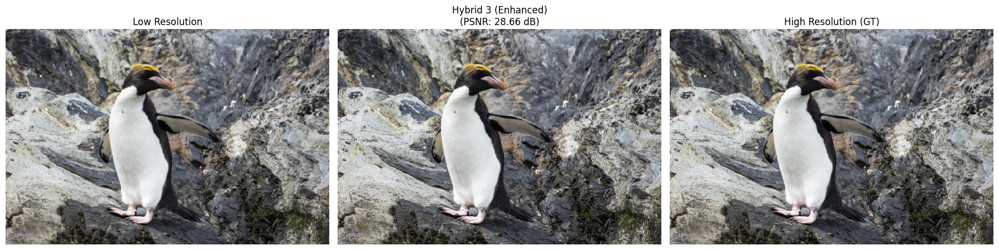

In [78]:
print("\nVisual Comparison for Hybrid 3 (EDSR + L1 + SSIM - Enhanced) on a Test Image:")
if 'hybrid3_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 3 (Enhanced)": hybrid3_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 3 model or test loader not available for visualization.")

In [64]:
# Evaluate (Hybrid 3 - EDSR 32/64)

print("\n--- Evaluating Hybrid 3 (EDSR 32/64) --- ")

# Ensure device is set to GPU (e.g., device = torch.device("cuda" if torch.cuda.is_available() else "cpu"))
if 'device' not in locals():
    print("Error: 'device' variable not defined. Please define it (e.g., to cuda).")
elif device.type == 'cpu':
    print("Warning: 'device' is set to CPU. Evaluation will run on CPU.")

# Use Existing Model Variable
if 'hybrid3_model' not in locals():
    print("Error: hybrid3_model variable not found in the current session.")
else:
    print("Using existing hybrid3_model variable...")
    eval_model_h3 = hybrid3_model
    eval_model_h3.to(device)
    eval_model_h3.eval()

    try:
        # Choose Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1")
                # Ensure val_subset is available if creating new loader
                if 'val_subset' in locals():
                    target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True) # pin_memory=True for GPU
                else:
                    print("Error: val_subset not found, cannot create batch_size=1 loader.")
                    target_loader = None # Prevent evaluation if loader is wrong

            if target_loader:
                print("Using validation set for evaluation.")

                # Run Evaluations
                print("\n--- Evaluating SSIM for Hybrid 3 --- ")
                h3_avg_ssim = evaluate_model_ssim(eval_model_h3, target_loader, device)
                print("\n--- Evaluating LPIPS for Hybrid 3 --- ")
                h3_avg_lpips = evaluate_model_lpips(eval_model_h3, target_loader, device)
                print(f"\n--- Results for Hybrid 3 (In-Memory Model) ---")
                print(f"Average SSIM: {h3_avg_ssim:.4f}")
                print(f"Average LPIPS: {h3_avg_lpips:.4f} (Lower is better)")

                # Clean up GPU memory
                if 'loss_fn_alex' in locals(): del loss_fn_alex
                torch.cuda.empty_cache()

        else:
            print("Error: Validation loader (e.g., val_loader_h3 with batch_size=1) not found or could not be created.")

    except Exception as e:
        print(f"An error occurred during evaluation (check GPU memory?): {e}")


--- Evaluating Hybrid 3 (EDSR 32/64) --- 
Using existing hybrid3_model variable...
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 3 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7802

--- Evaluating LPIPS for Hybrid 3 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.3514 (Lower is better)

--- Results for Hybrid 3 (In-Memory Model) ---
Average SSIM: 0.7802
Average LPIPS: 0.3514 (Lower is better)


### 6.4 Hybrid 4: EDSR (32b, 128f) + L1 + SSIM Loss (100 epochs, Augmentation)

In [65]:
# Setup and Train Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug)

import torch
import torch.nn as nn
import torch.optim as optim
from pytorch_msssim import ssim

# Define number of epochs for this experiment
num_epochs_hybrid4 = 100

# Define Loss (using the same Hybrid2Loss class definition from before)
if 'Hybrid2Loss' not in locals():
    print("Error: Hybrid2Loss class definition not found. Please run that cell first.")
else:
    # Using new variable name for clarity, though the loss function is the same
    hybrid4_criterion = Hybrid2Loss(l1_weight=1.0, ssim_weight=0.1)

# --- Instantiate New Model (Wider), Optimizer, Scheduler ---

# Ensure EDSR class definition (Section 2.5) and Loss are defined
if 'EDSR' not in locals():
    print("Error: EDSR class not defined. Please run the cell in Section 2.5 first.")
elif 'hybrid4_criterion' not in locals():
    print("Error: Loss function for Hybrid 4 not defined.")
else:
    # Instantiate New, WIDER Model (32 res blocks, 128 features)
    print(f"Instantiating NEW WIDER EDSR model (Hybrid 4: 128 features) for {num_epochs_hybrid4} epochs with augmentation...")
    # <<< Increased num_features to 128 >>>
    hybrid4_model = EDSR(num_res_blocks=32, num_features=128, scale_factor=scale_factor).to(device)

    # Instantiate New Optimizer
    # Consider potentially slightly lower LR for larger models, but 1e-4 is often a good start
    hybrid4_optimizer = optim.Adam(hybrid4_model.parameters(), lr=1e-4)

    # Instantiate New Scheduler with T_max=100
    hybrid4_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        hybrid4_optimizer,
        T_max=num_epochs_hybrid4, # Use 100 epochs
        eta_min=1e-6
    )
    print(f"Using CosineAnnealingLR scheduler with T_max={num_epochs_hybrid4}, eta_min=1e-6")

    # Train Hybrid 4 Model
    # Ensure train_model function and loaders are defined
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    # Reuse loaders created for Hybrid 3 (train_loader_aug, val_loader_h3)
    elif 'train_loader_aug' not in locals() or 'val_loader_h3' not in locals():
        print("Error: Augmented DataLoaders (train_loader_aug, val_loader_h3) not found. Run Cell 2 for Hybrid 3 first.")
    else:
        # Call the training function with the new variables
        print("Starting training for Hybrid 4 (Wider EDSR). This will take significantly longer...")
        hybrid4_model, hybrid4_history = train_model(
            hybrid4_model, "Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug)",
            train_loader_aug, val_loader_h3, # Reuse the augmented train loader and val loader
            hybrid4_criterion, hybrid4_optimizer, # Use the new criterion/optimizer
            num_epochs_hybrid4, device,
            scheduler=hybrid4_scheduler # Use the new scheduler
        )
        print("Finished training Hybrid 4.")

Hybrid2Loss initialized with L1 weight: 1.0, SSIM weight: 0.1
Instantiating NEW WIDER EDSR model (Hybrid 4: 128 features) for 100 epochs with augmentation...
Using CosineAnnealingLR scheduler with T_max=100, eta_min=1e-6
Starting training for Hybrid 4 (Wider EDSR). This will take significantly longer...

--- Training Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug) ---


Epoch 1/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/100 - Train Loss: 0.1408, Val PSNR: 23.78 dB
  -> New best model saved with Val PSNR: 23.78 dB


Epoch 2/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/100 - Train Loss: 0.0835, Val PSNR: 23.86 dB
  -> New best model saved with Val PSNR: 23.86 dB


Epoch 3/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/100 - Train Loss: 0.0683, Val PSNR: 24.63 dB
  -> New best model saved with Val PSNR: 24.63 dB


Epoch 4/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/100 - Train Loss: 0.0638, Val PSNR: 26.06 dB
  -> New best model saved with Val PSNR: 26.06 dB


Epoch 5/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/100 - Train Loss: 0.0614, Val PSNR: 26.39 dB
  -> New best model saved with Val PSNR: 26.39 dB


Epoch 6/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/100 - Train Loss: 0.0600, Val PSNR: 26.22 dB


Epoch 7/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/100 - Train Loss: 0.0566, Val PSNR: 26.36 dB


Epoch 8/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/100 - Train Loss: 0.0620, Val PSNR: 26.28 dB


Epoch 9/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/100 - Train Loss: 0.0585, Val PSNR: 26.16 dB


Epoch 10/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/100 - Train Loss: 0.0562, Val PSNR: 26.59 dB
  -> New best model saved with Val PSNR: 26.59 dB


Epoch 11/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/100 - Train Loss: 0.0556, Val PSNR: 26.40 dB


Epoch 12/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/100 - Train Loss: 0.0540, Val PSNR: 26.40 dB


Epoch 13/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/100 - Train Loss: 0.0570, Val PSNR: 26.50 dB


Epoch 14/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/100 - Train Loss: 0.0524, Val PSNR: 26.63 dB
  -> New best model saved with Val PSNR: 26.63 dB


Epoch 15/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/100 - Train Loss: 0.0530, Val PSNR: 26.58 dB


Epoch 16/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/100 - Train Loss: 0.0517, Val PSNR: 26.57 dB


Epoch 17/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/100 - Train Loss: 0.0498, Val PSNR: 26.76 dB
  -> New best model saved with Val PSNR: 26.76 dB


Epoch 18/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/100 - Train Loss: 0.0561, Val PSNR: 26.67 dB


Epoch 19/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/100 - Train Loss: 0.0540, Val PSNR: 26.95 dB
  -> New best model saved with Val PSNR: 26.95 dB


Epoch 20/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/100 - Train Loss: 0.0517, Val PSNR: 27.10 dB
  -> New best model saved with Val PSNR: 27.10 dB


Epoch 21/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/100 - Train Loss: 0.0534, Val PSNR: 26.95 dB


Epoch 22/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/100 - Train Loss: 0.0537, Val PSNR: 27.08 dB


Epoch 23/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/100 - Train Loss: 0.0516, Val PSNR: 26.97 dB


Epoch 24/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/100 - Train Loss: 0.0506, Val PSNR: 27.20 dB
  -> New best model saved with Val PSNR: 27.20 dB


Epoch 25/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/100 - Train Loss: 0.0513, Val PSNR: 26.65 dB


Epoch 26/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/100 - Train Loss: 0.0508, Val PSNR: 27.08 dB


Epoch 27/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/100 - Train Loss: 0.0488, Val PSNR: 27.06 dB


Epoch 28/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/100 - Train Loss: 0.0528, Val PSNR: 27.15 dB


Epoch 29/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/100 - Train Loss: 0.0504, Val PSNR: 27.26 dB
  -> New best model saved with Val PSNR: 27.26 dB


Epoch 30/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/100 - Train Loss: 0.0506, Val PSNR: 26.79 dB


Epoch 31/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/100 - Train Loss: 0.0518, Val PSNR: 27.28 dB
  -> New best model saved with Val PSNR: 27.28 dB


Epoch 32/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/100 - Train Loss: 0.0501, Val PSNR: 26.94 dB


Epoch 33/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/100 - Train Loss: 0.0509, Val PSNR: 27.15 dB


Epoch 34/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/100 - Train Loss: 0.0531, Val PSNR: 27.07 dB


Epoch 35/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/100 - Train Loss: 0.0508, Val PSNR: 27.20 dB


Epoch 36/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/100 - Train Loss: 0.0495, Val PSNR: 27.20 dB


Epoch 37/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/100 - Train Loss: 0.0500, Val PSNR: 26.99 dB


Epoch 38/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/100 - Train Loss: 0.0500, Val PSNR: 27.28 dB


Epoch 39/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/100 - Train Loss: 0.0490, Val PSNR: 26.94 dB


Epoch 40/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/100 - Train Loss: 0.0483, Val PSNR: 26.60 dB


Epoch 41/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/100 - Train Loss: 0.0482, Val PSNR: 27.25 dB


Epoch 42/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/100 - Train Loss: 0.0489, Val PSNR: 27.10 dB


Epoch 43/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/100 - Train Loss: 0.0460, Val PSNR: 27.26 dB


Epoch 44/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/100 - Train Loss: 0.0488, Val PSNR: 27.38 dB
  -> New best model saved with Val PSNR: 27.38 dB


Epoch 45/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/100 - Train Loss: 0.0494, Val PSNR: 27.38 dB
  -> New best model saved with Val PSNR: 27.38 dB


Epoch 46/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/100 - Train Loss: 0.0496, Val PSNR: 27.39 dB
  -> New best model saved with Val PSNR: 27.39 dB


Epoch 47/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/100 - Train Loss: 0.0480, Val PSNR: 27.33 dB


Epoch 48/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/100 - Train Loss: 0.0504, Val PSNR: 27.39 dB
  -> New best model saved with Val PSNR: 27.39 dB


Epoch 49/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/100 - Train Loss: 0.0475, Val PSNR: 27.27 dB


Epoch 50/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/100 - Train Loss: 0.0475, Val PSNR: 27.22 dB


Epoch 51/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 51/100 - Train Loss: 0.0495, Val PSNR: 27.44 dB
  -> New best model saved with Val PSNR: 27.44 dB


Epoch 52/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 52/100 - Train Loss: 0.0473, Val PSNR: 27.00 dB


Epoch 53/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 53/100 - Train Loss: 0.0487, Val PSNR: 27.34 dB


Epoch 54/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 54/100 - Train Loss: 0.0476, Val PSNR: 27.45 dB
  -> New best model saved with Val PSNR: 27.45 dB


Epoch 55/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 55/100 - Train Loss: 0.0463, Val PSNR: 27.44 dB


Epoch 56/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 56/100 - Train Loss: 0.0448, Val PSNR: 27.37 dB


Epoch 57/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 57/100 - Train Loss: 0.0459, Val PSNR: 27.44 dB


Epoch 58/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 58/100 - Train Loss: 0.0463, Val PSNR: 27.16 dB


Epoch 59/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 59/100 - Train Loss: 0.0461, Val PSNR: 27.50 dB
  -> New best model saved with Val PSNR: 27.50 dB


Epoch 60/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 60/100 - Train Loss: 0.0454, Val PSNR: 27.46 dB


Epoch 61/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 61/100 - Train Loss: 0.0464, Val PSNR: 27.46 dB


Epoch 62/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 62/100 - Train Loss: 0.0448, Val PSNR: 27.50 dB
  -> New best model saved with Val PSNR: 27.50 dB


Epoch 63/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 63/100 - Train Loss: 0.0479, Val PSNR: 27.49 dB


Epoch 64/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 64/100 - Train Loss: 0.0475, Val PSNR: 27.47 dB


Epoch 65/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 65/100 - Train Loss: 0.0481, Val PSNR: 27.49 dB


Epoch 66/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 66/100 - Train Loss: 0.0487, Val PSNR: 27.51 dB
  -> New best model saved with Val PSNR: 27.51 dB


Epoch 67/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 67/100 - Train Loss: 0.0456, Val PSNR: 27.53 dB
  -> New best model saved with Val PSNR: 27.53 dB


Epoch 68/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 68/100 - Train Loss: 0.0464, Val PSNR: 27.53 dB


Epoch 69/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 69/100 - Train Loss: 0.0460, Val PSNR: 27.52 dB


Epoch 70/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 70/100 - Train Loss: 0.0475, Val PSNR: 27.53 dB
  -> New best model saved with Val PSNR: 27.53 dB


Epoch 71/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 71/100 - Train Loss: 0.0474, Val PSNR: 27.57 dB
  -> New best model saved with Val PSNR: 27.57 dB


Epoch 72/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 72/100 - Train Loss: 0.0466, Val PSNR: 27.54 dB


Epoch 73/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 73/100 - Train Loss: 0.0450, Val PSNR: 27.53 dB


Epoch 74/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 74/100 - Train Loss: 0.0467, Val PSNR: 27.53 dB


Epoch 75/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 75/100 - Train Loss: 0.0482, Val PSNR: 27.54 dB


Epoch 76/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 76/100 - Train Loss: 0.0462, Val PSNR: 27.56 dB


Epoch 77/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 77/100 - Train Loss: 0.0456, Val PSNR: 27.47 dB


Epoch 78/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 78/100 - Train Loss: 0.0470, Val PSNR: 27.55 dB


Epoch 79/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 79/100 - Train Loss: 0.0462, Val PSNR: 27.55 dB


Epoch 80/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 80/100 - Train Loss: 0.0471, Val PSNR: 27.58 dB
  -> New best model saved with Val PSNR: 27.58 dB


Epoch 81/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 81/100 - Train Loss: 0.0466, Val PSNR: 27.59 dB
  -> New best model saved with Val PSNR: 27.59 dB


Epoch 82/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 82/100 - Train Loss: 0.0452, Val PSNR: 27.55 dB


Epoch 83/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 83/100 - Train Loss: 0.0445, Val PSNR: 27.59 dB
  -> New best model saved with Val PSNR: 27.59 dB


Epoch 84/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 84/100 - Train Loss: 0.0464, Val PSNR: 27.58 dB


Epoch 85/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 85/100 - Train Loss: 0.0456, Val PSNR: 27.60 dB
  -> New best model saved with Val PSNR: 27.60 dB


Epoch 86/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 86/100 - Train Loss: 0.0461, Val PSNR: 27.59 dB


Epoch 87/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 87/100 - Train Loss: 0.0469, Val PSNR: 27.58 dB


Epoch 88/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 88/100 - Train Loss: 0.0470, Val PSNR: 27.59 dB


Epoch 89/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 89/100 - Train Loss: 0.0479, Val PSNR: 27.60 dB


Epoch 90/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 90/100 - Train Loss: 0.0448, Val PSNR: 27.61 dB
  -> New best model saved with Val PSNR: 27.61 dB


Epoch 91/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 91/100 - Train Loss: 0.0445, Val PSNR: 27.61 dB


Epoch 92/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 92/100 - Train Loss: 0.0461, Val PSNR: 27.60 dB


Epoch 93/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 93/100 - Train Loss: 0.0449, Val PSNR: 27.61 dB
  -> New best model saved with Val PSNR: 27.61 dB


Epoch 94/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 94/100 - Train Loss: 0.0459, Val PSNR: 27.60 dB


Epoch 95/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 95/100 - Train Loss: 0.0461, Val PSNR: 27.60 dB


Epoch 96/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 96/100 - Train Loss: 0.0449, Val PSNR: 27.61 dB
  -> New best model saved with Val PSNR: 27.61 dB


Epoch 97/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 97/100 - Train Loss: 0.0465, Val PSNR: 27.61 dB


Epoch 98/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 98/100 - Train Loss: 0.0451, Val PSNR: 27.61 dB


Epoch 99/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 99/100 - Train Loss: 0.0451, Val PSNR: 27.61 dB


Epoch 100/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 100/100 - Train Loss: 0.0464, Val PSNR: 27.61 dB
  -> New best model saved with Val PSNR: 27.61 dB
--- Finished Training Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug) ---
Loaded best model state with Val PSNR: 27.61 dB
Finished training Hybrid 4.


In [66]:
hybrid4_model

EDSR(
  (head): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), pa

In [67]:
import torch

# Save model weights
torch.save(hybrid4_model.state_dict(), 'hybrid4_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid4_model, 'full_hybrid4_model.pth')


Visual Comparison for Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug - Enhanced) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


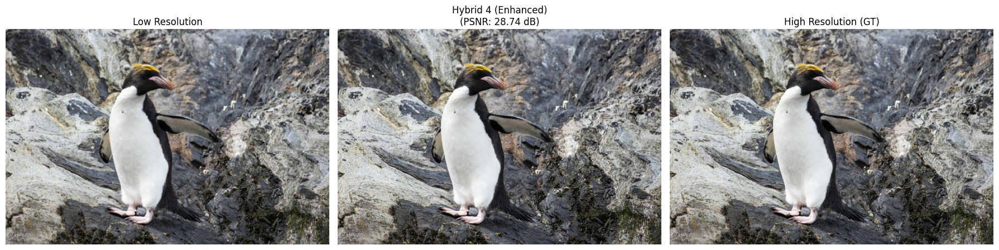

In [77]:
print("\nVisual Comparison for Hybrid 4 (EDSR-128f + L1 + SSIM - 100 Epochs + Aug - Enhanced) on a Test Image:")
if 'hybrid4_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 4 (Enhanced)": hybrid4_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 4 model or test loader not available for visualization.")

In [69]:
# Evaluate (Hybrid 4 - EDSR 32/128)

print("\n--- Evaluating Hybrid 4 (EDSR 32/128) variable on GPU --- ")

# Ensure device is set to GPU
if 'device' not in locals():
    print("Error: 'device' variable not defined. Please define it (e.g., to cuda).")
elif device.type == 'cpu' :
    print("Warning: 'device' is set to CPU. Evaluation will run on CPU.")

if 'hybrid4_model' not in locals():
    print("Error: hybrid4_model variable not found in the current session.")
else:
    print("Using existing hybrid4_model variable...")
    eval_model_h4 = hybrid4_model
    eval_model_h4.to(device)
    eval_model_h4.eval()

    try:
        # Choose Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1")
                # Ensure val_subset is available if creating new loader
                if 'val_subset' in locals():
                    target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True) # pin_memory=True for GPU
                else:
                    print("Error: val_subset not found, cannot create batch_size=1 loader.")
                    target_loader = None # Prevent evaluation if loader is wrong

            if target_loader:
                print("Using validation set for evaluation.")

                # Run Evaluations
                print("\n--- Evaluating SSIM for Hybrid 4 --- ")
                # Pass GPU device to evaluation function
                h4_avg_ssim = evaluate_model_ssim(eval_model_h4, target_loader, device)

                print("\n--- Evaluating LPIPS for Hybrid 4 --- ")
                # Pass GPU device to evaluation function
                h4_avg_lpips = evaluate_model_lpips(eval_model_h4, target_loader, device)

                print(f"\n--- Results for Hybrid 4 ---")
                print(f"Average SSIM: {h4_avg_ssim:.4f}")
                print(f"Average LPIPS: {h4_avg_lpips:.4f} (Lower is better)")

                # Clean up GPU memory
                if 'loss_fn_alex' in locals(): del loss_fn_alex
                torch.cuda.empty_cache()

        else:
            print("Error: Validation loader (e.g., val_loader_h3 with batch_size=1) not found or could not be created.")

    except Exception as e:
        print(f"An error occurred during evaluation (check GPU memory?): {e}")


--- Evaluating Hybrid 4 (EDSR 32/128) variable on GPU --- 
Using existing hybrid4_model variable...
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 4 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7892

--- Evaluating LPIPS for Hybrid 4 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.3340 (Lower is better)

--- Results for Hybrid 4 ---
Average SSIM: 0.7892
Average LPIPS: 0.3340 (Lower is better)


Inference the model with test images

In [117]:
import torch
import os
from PIL import Image
import torchvision.transforms as transforms
import gc
import copy

def run_inference_with_model_var_cpu(model_variable, model_name, input_image_paths, save_dir):
    device = torch.device("cpu")
    print(f"\n==> Running inference with {model_name} on {len(input_image_paths)} images ")
    os.makedirs(save_dir, exist_ok=True)

    # <<< Create a deep copy of the model and move the copy to CPU >>>
    print("Creating a copy of the model for CPU inference...")
    model_cpu_copy = copy.deepcopy(model_variable).to(device)
    model_cpu_copy.eval()
    print("CPU model copy created and set to eval mode.")

    to_pil = transforms.ToPILImage()
    preprocess = transforms.ToTensor()

    for img_path in input_image_paths:
        try:
            img_name = os.path.basename(img_path)
            img_stem = os.path.splitext(img_name)[0]

            img_lr = Image.open(img_path).convert("RGB")
            # <<< Preprocess tensor directly to CPU >>>
            lr_tensor = preprocess(img_lr).unsqueeze(0).to(device)

            with torch.no_grad():
                # <<< Use the CPU model copy for inference >>>
                sr_tensor = model_cpu_copy(lr_tensor).squeeze(0).clamp(0, 1)

            out_img = to_pil(sr_tensor)
            output_filename = os.path.join(save_dir, f"{img_stem}_{model_name}_SR.png")
            out_img.save(output_filename)
            print(f"  Saved {output_filename}")

        except FileNotFoundError:
            print(f"  Error: Input image not found at {img_path}. Skipping.")
        except Exception as e:
            print(f"  Error processing {img_path}: {e}. Skipping.")

    # <<< Clean up the CPU copy >>>
    del model_cpu_copy
    # torch.cuda.empty_cache() # No CUDA cache used here
    gc.collect()
    print(f"==> Inference complete for {model_name} (CPU).")

In [118]:
model_to_use = hybrid4_model

# Specific image paths
my_image_paths = [
    "/content/data/PHOTO-1.jpg",
    "/content/data/PHOTO-2.jpg",
    "/content/data/PHOTO-3.jpg",
    "/content/data/PHOTO-4.jpg",
]

# Define the directory to save the super-resolved images
my_output_directory = "/content/proposed_model_results"

# Call the inference function

if "run_inference_with_model_var_cpu" in locals():
    print(f"Starting CPU inference for {len(my_image_paths)} images...")
    run_inference_with_model_var_cpu(
        model_variable=model_to_use,
        model_name="Proposed_Model",
        input_image_paths=my_image_paths,
        save_dir=my_output_directory
    )
    print("CPU inference call finished.")
else:
    print("Error: run_inference_with_model_var_cpu function is not defined. Please run the cell containing its definition first.")

Starting CPU inference for 4 images...

==> Running inference with Proposed_Model on 4 images 
Creating a copy of the model for CPU inference...
CPU model copy created and set to eval mode.
  Saved /content/proposed_model_results/PHOTO-1_Proposed_Model_SR.png
  Saved /content/proposed_model_results/PHOTO-2_Proposed_Model_SR.png
  Saved /content/proposed_model_results/PHOTO-3_Proposed_Model_SR.png
  Saved /content/proposed_model_results/PHOTO-4_Proposed_Model_SR.png
==> Inference complete for Proposed_Model (CPU).
CPU inference call finished.


HR files:
['0806.png', '0833.png', '0803.png', '0875.png', '0878.png', '0869.png', '0810.png', '0880.png', '0877.png', '0864.png']
LR files:
ls: cannot access '/content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4hr_dir': No such file or directory
ls: cannot access '=': No such file or directory
/content/data/DIV2K_valid_HR:
0801.png  0814.png  0827.png  0840.png	0853.png  0866.png  0879.png  0892.png
0802.png  0815.png  0828.png  0841.png	0854.png  0867.png  0880.png  0893.png
0803.png  0816.png  0829.png  0842.png	0855.png  0868.png  0881.png  0894.png
0804.png  0817.png  0830.png  0843.png	0856.png  0869.png  0882.png  0895.png
0805.png  0818.png  0831.png  0844.png	0857.png  0870.png  0883.png  0896.png
0806.png  0819.png  0832.png  0845.png	0858.png  0871.png  0884.png  0897.png
0807.png  0820.png  0833.png  0846.png	0859.png  0872.png  0885.png  0898.png
0808.png  0821.png  0834.png  0847.png	0860.png  0873.png  0886.png  0899.png
0809.png  0822.png  0835.png  0848.png	0

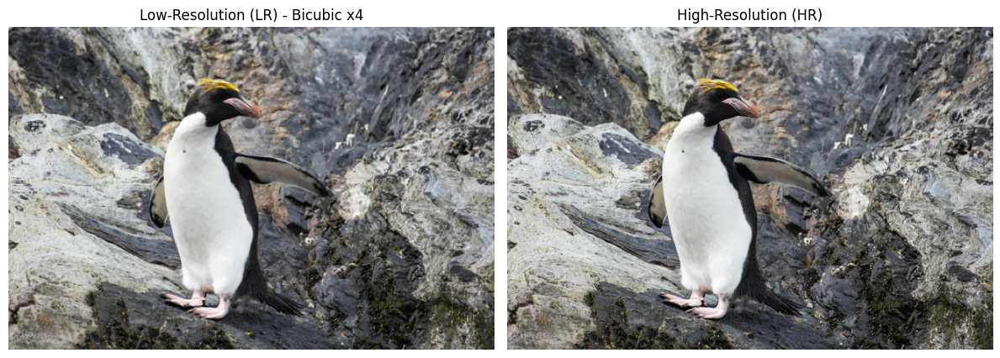

In [122]:
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
hr_dir = "/content/data/DIV2K_valid_HR"
print("HR files:")
print(os.listdir(hr_dir)[:10])

lr_dir = "/content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4"
print("LR files:")
# print(os.listdir(lr_dir))


!ls "$lr_dir"hr_dir = "/content/data/DIV2K_valid_HR"
print("HR files:")
print(os.listdir(hr_dir)[:10])

lr_dir = "/content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4"
print("LR files:")
# print(os.listdir(lr_dir))


!ls "$lr_dir"
# File paths for index 0 (image 0801.png)
hr_path = "/content/data/DIV2K_valid_HR/0801.png"
lr_path = "/content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4/0801x4.png"

# Load images
hr_img = Image.open(hr_path).convert("RGB")
lr_img = Image.open(lr_path).convert("RGB")

# Display side by side
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(lr_img)
plt.title("Low-Resolution (LR) - Bicubic x4")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(hr_img)
plt.title("High-Resolution (HR)")
plt.axis("off")

plt.tight_layout()
plt.show()

In [123]:
import torch
import os
from PIL import Image
import torchvision.transforms as transforms
import gc
import copy
import math

def calculate_psnr(img1_tensor, img2_tensor, max_value=1.0):
    """Calculates PSNR between two tensors (range [0, 1])."""
    # Ensure tensors are on the same device (CPU for this function)
    img1_tensor = img1_tensor.cpu()
    img2_tensor = img2_tensor.cpu()

    mse = torch.mean((img1_tensor - img2_tensor) ** 2)
    if mse == 0:
        return float("inf") # Identical images
    psnr = 10 * math.log10(max_value**2 / mse.item())
    return psnr

def run_inference_single_file_with_psnr_cpu(model_variable, model_name, lr_image_path, hr_image_path, save_dir):
    device = torch.device("cpu")
    print(f"\n==> Processing {os.path.basename(lr_image_path)} with {model_name} (FORCED CPU)")
    os.makedirs(save_dir, exist_ok=True)
    print("Creating a copy of the model for CPU inference...")
    model_cpu_copy = copy.deepcopy(model_variable).to(device)
    model_cpu_copy.eval()
    print("CPU model copy created and set to eval mode.")

    to_pil = transforms.ToPILImage()
    preprocess = transforms.ToTensor() # To convert PIL images to tensors [0, 1]

    try:
        # Load LR and HR images
        img_lr_pil = Image.open(lr_image_path).convert("RGB")
        img_hr_pil = Image.open(hr_image_path).convert("RGB")

        # Preprocess images to tensors
        lr_tensor = preprocess(img_lr_pil).unsqueeze(0).to(device)
        hr_tensor = preprocess(img_hr_pil).to(device)

        with torch.no_grad():
            # Output tensor will be [1, C, H, W] on CPU
            sr_tensor_batch = model_cpu_copy(lr_tensor)
            sr_tensor = sr_tensor_batch.squeeze(0).clamp(0, 1)

        # Save SR image
        out_img_pil = to_pil(sr_tensor)
        lr_basename = os.path.basename(lr_image_path)
        lr_stem = os.path.splitext(lr_basename)[0]
        output_filename = os.path.join(save_dir, f"{lr_stem}_{model_name}_SR_CPU.png")
        out_img_pil.save(output_filename)
        print(f"  Saved SR image: {output_filename}")

        # --- Calculate PSNR ---
        if sr_tensor.shape != hr_tensor.shape:
             print(f"Warning: SR shape {sr_tensor.shape} differs from HR shape {hr_tensor.shape}. PSNR might be inaccurate.")

        psnr_value = calculate_psnr(sr_tensor, hr_tensor, max_value=1.0)
        print(f"  Calculated PSNR: {psnr_value:.4f} dB")

    except FileNotFoundError as e:
        print(f"  Error: Image file not found: {e}. Skipping.")
    except Exception as e:
        print(f"  Error processing {lr_image_path}: {e}. Skipping.")

    # Clean up the CPU
    del model_cpu_copy
    gc.collect()
    print(f"==> Processing complete for {os.path.basename(lr_image_path)} (CPU).")
    return psnr_value # Return the PSNR value


In [124]:
model_to_use = hybrid4_model

# Define the paths to a specific LR and HR images
lr_file_path = "/content/data/DIV2K_valid_LR_bicubic/DIV2K_valid_LR_bicubic/X4/0801x4.png"
hr_file_path = "/content/data/DIV2K_valid_HR/0801.png"

# 3. Define the directory to save the super-resolouated image
my_output_directory = "/content/single_file_results_cpu"


if "run_inference_single_file_with_psnr_cpu" in locals():
    print(f"Starting CPU inference and PSNR calculation for {os.path.basename(lr_file_path)}...")
    psnr_result = run_inference_single_file_with_psnr_cpu(
        model_variable=model_to_use,
        model_name="Proposed_Model",
        lr_image_path=lr_file_path,
        hr_image_path=hr_file_path,
        save_dir=my_output_directory
    )
    if psnr_result is not None:
       print(f"\nFinal PSNR for {os.path.basename(lr_file_path)}: {psnr_result:.4f} dB")
    print(f"CPU inference and PSNR calculation call finished.")
else:
    print("Error: run_inference_single_file_with_psnr_cpu function is not defined. Please run the cell containing its definition first.")

Starting CPU inference and PSNR calculation for 0801x4.png...

==> Processing 0801x4.png with Proposed_Model (FORCED CPU)
Creating a copy of the model for CPU inference...
CPU model copy created and set to eval mode.
  Saved SR image: /content/single_file_results_cpu/0801x4_Proposed_Model_SR_CPU.png
  Calculated PSNR: 28.7442 dB
==> Processing complete for 0801x4.png (CPU).

Final PSNR for 0801x4.png: 28.7442 dB
CPU inference and PSNR calculation call finished.


### 6.5 Hybrid 5: EDSR (64b, 128f) + L1 + SSIM Loss (100 epochs, Augmentation)

In [79]:
# Setup and Train Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug)

import torch
import torch.nn as nn
import torch.optim as optim
from pytorch_msssim import ssim # Ensure this was imported earlier

num_epochs_hybrid5 = 100

# Define Loss (using the same Hybrid2Loss class from before)
if 'Hybrid2Loss' not in locals():
    print("Error: Hybrid2Loss class definition not found. Please run that cell first.")
else:
    hybrid5_criterion = Hybrid2Loss(l1_weight=1.0, ssim_weight=0.1)

# --- Instantiate NEW Model (Deeper & Wider), Optimizer, Scheduler ---

# Ensure EDSR class definition (Section 2.5) and Loss are defined
if 'EDSR' not in locals():
    print("Error: EDSR class not defined. Please run the cell in Section 2.5 first.")
elif 'hybrid5_criterion' not in locals():
    print("Error: Loss function for Hybrid 5 not defined.")
else:
    # Instantiate NEW, DEEPER & WIDER Model (64 res blocks, 128 features)
    print(f"Instantiating NEW DEEPER & WIDER EDSR model (Hybrid 5: 64 blocks, 128 features) for {num_epochs_hybrid5} epochs with augmentation...")
    # <<< Increased num_res_blocks to 64 and kept num_features at 128 >>>
    hybrid5_model = EDSR(num_res_blocks=64, num_features=128, scale_factor=scale_factor).to(device)

    # Instantiate NEW Optimizer
    hybrid5_optimizer = optim.Adam(hybrid5_model.parameters(), lr=1e-4)

    # Instantiate NEW Scheduler with T_max=100
    hybrid5_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        hybrid5_optimizer,
        T_max=num_epochs_hybrid5, # Use 100 epochs
        eta_min=1e-6
    )
    print(f"Using CosineAnnealingLR scheduler with T_max={num_epochs_hybrid5}, eta_min=1e-6")

    # Train the Hybrid 5 Model
    # Ensure train_model function (Section 3.1) and loaders are defined
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    # Reuse loaders created for Hybrid 3 (train_loader_aug, val_loader_h3)
    elif 'train_loader_aug' not in locals() or 'val_loader_h3' not in locals():
        print("Error: Augmented DataLoaders (train_loader_aug, val_loader_h3) not found. Run Cell 2 for Hybrid 3 first.")
    else:
        # Call the training function
        print("Starting training for Hybrid 5 (Deeper & Wider EDSR). This will take an EXTREMELY long time and require significant resources...")
        hybrid5_model, hybrid5_history = train_model(
            hybrid5_model, "Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug)",
            train_loader_aug, val_loader_h3, # Reuse the augmented train loader and val loader
            hybrid5_criterion, hybrid5_optimizer, # Use the new criterion/optimizer
            num_epochs_hybrid5, device,
            scheduler=hybrid5_scheduler # Use the new scheduler
        )
        print("Finished training Hybrid 5.")

Hybrid2Loss initialized with L1 weight: 1.0, SSIM weight: 0.1
Instantiating NEW DEEPER & WIDER EDSR model (Hybrid 5: 64 blocks, 128 features) for 100 epochs with augmentation...
Using CosineAnnealingLR scheduler with T_max=100, eta_min=1e-6
Starting training for Hybrid 5 (Deeper & Wider EDSR). This will take an EXTREMELY long time and require significant resources...

--- Training Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) ---


Epoch 1/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/100 - Train Loss: 0.2007, Val PSNR: 21.83 dB
  -> New best model saved with Val PSNR: 21.83 dB


Epoch 2/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/100 - Train Loss: 0.1054, Val PSNR: 23.61 dB
  -> New best model saved with Val PSNR: 23.61 dB


Epoch 3/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/100 - Train Loss: 0.0835, Val PSNR: 23.61 dB


Epoch 4/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/100 - Train Loss: 0.0766, Val PSNR: 25.54 dB
  -> New best model saved with Val PSNR: 25.54 dB


Epoch 5/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/100 - Train Loss: 0.0696, Val PSNR: 25.63 dB
  -> New best model saved with Val PSNR: 25.63 dB


Epoch 6/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/100 - Train Loss: 0.0646, Val PSNR: 25.88 dB
  -> New best model saved with Val PSNR: 25.88 dB


Epoch 7/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/100 - Train Loss: 0.0623, Val PSNR: 26.28 dB
  -> New best model saved with Val PSNR: 26.28 dB


Epoch 8/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/100 - Train Loss: 0.0580, Val PSNR: 26.33 dB
  -> New best model saved with Val PSNR: 26.33 dB


Epoch 9/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/100 - Train Loss: 0.0576, Val PSNR: 25.95 dB


Epoch 10/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/100 - Train Loss: 0.0607, Val PSNR: 25.92 dB


Epoch 11/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/100 - Train Loss: 0.0586, Val PSNR: 26.61 dB
  -> New best model saved with Val PSNR: 26.61 dB


Epoch 12/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/100 - Train Loss: 0.0557, Val PSNR: 26.58 dB


Epoch 13/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/100 - Train Loss: 0.0544, Val PSNR: 26.74 dB
  -> New best model saved with Val PSNR: 26.74 dB


Epoch 14/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/100 - Train Loss: 0.0546, Val PSNR: 26.72 dB


Epoch 15/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/100 - Train Loss: 0.0542, Val PSNR: 26.64 dB


Epoch 16/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/100 - Train Loss: 0.0563, Val PSNR: 26.82 dB
  -> New best model saved with Val PSNR: 26.82 dB


Epoch 17/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/100 - Train Loss: 0.0548, Val PSNR: 26.78 dB


Epoch 18/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/100 - Train Loss: 0.0536, Val PSNR: 26.63 dB


Epoch 19/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/100 - Train Loss: 0.0522, Val PSNR: 26.63 dB


Epoch 20/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/100 - Train Loss: 0.0540, Val PSNR: 26.62 dB


Epoch 21/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/100 - Train Loss: 0.0529, Val PSNR: 26.94 dB
  -> New best model saved with Val PSNR: 26.94 dB


Epoch 22/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/100 - Train Loss: 0.0540, Val PSNR: 26.91 dB


Epoch 23/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/100 - Train Loss: 0.0513, Val PSNR: 26.97 dB
  -> New best model saved with Val PSNR: 26.97 dB


Epoch 24/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/100 - Train Loss: 0.0535, Val PSNR: 26.64 dB


Epoch 25/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/100 - Train Loss: 0.0529, Val PSNR: 27.09 dB
  -> New best model saved with Val PSNR: 27.09 dB


Epoch 26/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/100 - Train Loss: 0.0502, Val PSNR: 27.08 dB


Epoch 27/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/100 - Train Loss: 0.0502, Val PSNR: 26.97 dB


Epoch 28/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/100 - Train Loss: 0.0526, Val PSNR: 26.75 dB


Epoch 29/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/100 - Train Loss: 0.0535, Val PSNR: 27.18 dB
  -> New best model saved with Val PSNR: 27.18 dB


Epoch 30/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/100 - Train Loss: 0.0520, Val PSNR: 27.18 dB


Epoch 31/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/100 - Train Loss: 0.0510, Val PSNR: 27.14 dB


Epoch 32/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/100 - Train Loss: 0.0503, Val PSNR: 27.10 dB


Epoch 33/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/100 - Train Loss: 0.0512, Val PSNR: 27.16 dB


Epoch 34/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/100 - Train Loss: 0.0498, Val PSNR: 26.99 dB


Epoch 35/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/100 - Train Loss: 0.0513, Val PSNR: 27.29 dB
  -> New best model saved with Val PSNR: 27.29 dB


Epoch 36/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/100 - Train Loss: 0.0513, Val PSNR: 27.19 dB


Epoch 37/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/100 - Train Loss: 0.0490, Val PSNR: 27.21 dB


Epoch 38/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/100 - Train Loss: 0.0503, Val PSNR: 27.08 dB


Epoch 39/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/100 - Train Loss: 0.0503, Val PSNR: 27.15 dB


Epoch 40/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/100 - Train Loss: 0.0510, Val PSNR: 27.03 dB


Epoch 41/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/100 - Train Loss: 0.0496, Val PSNR: 27.32 dB
  -> New best model saved with Val PSNR: 27.32 dB


Epoch 42/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/100 - Train Loss: 0.0489, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 43/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/100 - Train Loss: 0.0497, Val PSNR: 27.29 dB


Epoch 44/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/100 - Train Loss: 0.0487, Val PSNR: 27.33 dB


Epoch 45/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/100 - Train Loss: 0.0496, Val PSNR: 27.33 dB


Epoch 46/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/100 - Train Loss: 0.0515, Val PSNR: 27.07 dB


Epoch 47/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/100 - Train Loss: 0.0505, Val PSNR: 27.34 dB


Epoch 48/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/100 - Train Loss: 0.0508, Val PSNR: 27.31 dB


Epoch 49/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/100 - Train Loss: 0.0486, Val PSNR: 27.35 dB
  -> New best model saved with Val PSNR: 27.35 dB


Epoch 50/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/100 - Train Loss: 0.0484, Val PSNR: 27.35 dB
  -> New best model saved with Val PSNR: 27.35 dB


Epoch 51/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 51/100 - Train Loss: 0.0502, Val PSNR: 27.29 dB


Epoch 52/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 52/100 - Train Loss: 0.0463, Val PSNR: 27.35 dB
  -> New best model saved with Val PSNR: 27.35 dB


Epoch 53/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 53/100 - Train Loss: 0.0506, Val PSNR: 27.33 dB


Epoch 54/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 54/100 - Train Loss: 0.0477, Val PSNR: 27.41 dB
  -> New best model saved with Val PSNR: 27.41 dB


Epoch 55/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 55/100 - Train Loss: 0.0481, Val PSNR: 27.40 dB


Epoch 56/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 56/100 - Train Loss: 0.0473, Val PSNR: 27.38 dB


Epoch 57/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 57/100 - Train Loss: 0.0490, Val PSNR: 27.42 dB
  -> New best model saved with Val PSNR: 27.42 dB


Epoch 58/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 58/100 - Train Loss: 0.0468, Val PSNR: 27.36 dB


Epoch 59/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 59/100 - Train Loss: 0.0504, Val PSNR: 27.45 dB
  -> New best model saved with Val PSNR: 27.45 dB


Epoch 60/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 60/100 - Train Loss: 0.0468, Val PSNR: 27.45 dB


Epoch 61/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 61/100 - Train Loss: 0.0485, Val PSNR: 27.38 dB


Epoch 62/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 62/100 - Train Loss: 0.0475, Val PSNR: 27.36 dB


Epoch 63/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 63/100 - Train Loss: 0.0483, Val PSNR: 27.49 dB
  -> New best model saved with Val PSNR: 27.49 dB


Epoch 64/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 64/100 - Train Loss: 0.0484, Val PSNR: 27.48 dB


Epoch 65/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 65/100 - Train Loss: 0.0478, Val PSNR: 27.43 dB


Epoch 66/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 66/100 - Train Loss: 0.0479, Val PSNR: 27.51 dB
  -> New best model saved with Val PSNR: 27.51 dB


Epoch 67/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 67/100 - Train Loss: 0.0492, Val PSNR: 27.52 dB
  -> New best model saved with Val PSNR: 27.52 dB


Epoch 68/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 68/100 - Train Loss: 0.0477, Val PSNR: 27.46 dB


Epoch 69/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 69/100 - Train Loss: 0.0497, Val PSNR: 27.48 dB


Epoch 70/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 70/100 - Train Loss: 0.0474, Val PSNR: 27.50 dB


Epoch 71/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 71/100 - Train Loss: 0.0473, Val PSNR: 27.49 dB


Epoch 72/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 72/100 - Train Loss: 0.0478, Val PSNR: 27.53 dB
  -> New best model saved with Val PSNR: 27.53 dB


Epoch 73/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 73/100 - Train Loss: 0.0460, Val PSNR: 27.46 dB


Epoch 74/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 74/100 - Train Loss: 0.0469, Val PSNR: 27.53 dB


Epoch 75/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 75/100 - Train Loss: 0.0461, Val PSNR: 27.54 dB
  -> New best model saved with Val PSNR: 27.54 dB


Epoch 76/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 76/100 - Train Loss: 0.0464, Val PSNR: 27.51 dB


Epoch 77/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 77/100 - Train Loss: 0.0461, Val PSNR: 27.55 dB
  -> New best model saved with Val PSNR: 27.55 dB


Epoch 78/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 78/100 - Train Loss: 0.0450, Val PSNR: 27.57 dB
  -> New best model saved with Val PSNR: 27.57 dB


Epoch 79/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 79/100 - Train Loss: 0.0460, Val PSNR: 27.52 dB


Epoch 80/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 80/100 - Train Loss: 0.0475, Val PSNR: 27.54 dB


Epoch 81/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 81/100 - Train Loss: 0.0487, Val PSNR: 27.54 dB


Epoch 82/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 82/100 - Train Loss: 0.0476, Val PSNR: 27.53 dB


Epoch 83/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 83/100 - Train Loss: 0.0471, Val PSNR: 27.57 dB


Epoch 84/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 84/100 - Train Loss: 0.0457, Val PSNR: 27.56 dB


Epoch 85/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 85/100 - Train Loss: 0.0469, Val PSNR: 27.57 dB
  -> New best model saved with Val PSNR: 27.57 dB


Epoch 86/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 86/100 - Train Loss: 0.0459, Val PSNR: 27.57 dB


Epoch 87/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 87/100 - Train Loss: 0.0470, Val PSNR: 27.56 dB


Epoch 88/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 88/100 - Train Loss: 0.0457, Val PSNR: 27.56 dB


Epoch 89/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 89/100 - Train Loss: 0.0472, Val PSNR: 27.57 dB
  -> New best model saved with Val PSNR: 27.57 dB


Epoch 90/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 90/100 - Train Loss: 0.0440, Val PSNR: 27.57 dB
  -> New best model saved with Val PSNR: 27.57 dB


Epoch 91/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 91/100 - Train Loss: 0.0471, Val PSNR: 27.58 dB
  -> New best model saved with Val PSNR: 27.58 dB


Epoch 92/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 92/100 - Train Loss: 0.0465, Val PSNR: 27.58 dB


Epoch 93/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 93/100 - Train Loss: 0.0455, Val PSNR: 27.58 dB
  -> New best model saved with Val PSNR: 27.58 dB


Epoch 94/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 94/100 - Train Loss: 0.0468, Val PSNR: 27.58 dB


Epoch 95/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 95/100 - Train Loss: 0.0462, Val PSNR: 27.58 dB


Epoch 96/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 96/100 - Train Loss: 0.0467, Val PSNR: 27.59 dB
  -> New best model saved with Val PSNR: 27.59 dB


Epoch 97/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 97/100 - Train Loss: 0.0465, Val PSNR: 27.59 dB
  -> New best model saved with Val PSNR: 27.59 dB


Epoch 98/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 98/100 - Train Loss: 0.0469, Val PSNR: 27.58 dB


Epoch 99/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 99/100 - Train Loss: 0.0456, Val PSNR: 27.59 dB


Epoch 100/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 100/100 - Train Loss: 0.0467, Val PSNR: 27.58 dB
--- Finished Training Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) ---
Loaded best model state with Val PSNR: 27.59 dB
Finished training Hybrid 5.


In [80]:
hybrid5_model

EDSR(
  (head): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), pa

In [81]:
import torch

# Save model weights
torch.save(hybrid5_model.state_dict(), 'hybrid5_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid5_model, 'full_hybrid5_model.pth')


Visual Comparison for Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


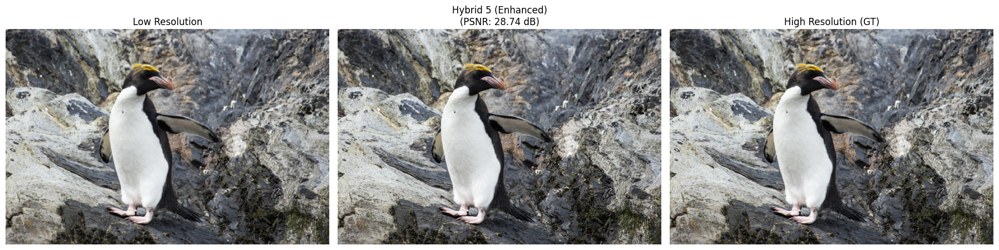

In [82]:
print("\nVisual Comparison for Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) on a Test Image:")
if 'hybrid5_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 5 (Enhanced)": hybrid5_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 5 model or test loader not available for visualization.")

In [83]:
# Evaluate  Hybrid 5

print("\n--- Evaluating Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) variable on GPU --- ")

# Ensure device is set to GPU
if 'device' not in locals():
    print("Error: 'device' variable not defined. Please define it (e.g., to cuda).")
elif device.type == 'cpu' :
    print("Warning: 'device' is set to CPU. Evaluation will run on CPU.")

# Check  hybrid5_model
if 'hybrid5_model' not in locals():
    print("Error: hybrid5_model variable not found in the current session.")
else:
    print("Using existing hybrid5_model variable...")
    eval_model_h5 = hybrid5_model
    eval_model_h5.to(device)
    eval_model_h5.eval()

    try:
        # Choose Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1")
                # Ensure val_subset is available if creating new loader
                if 'val_subset' in locals():
                    target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True) # pin_memory=True for GPU
                else:
                    print("Error: val_subset not found, cannot create batch_size=1 loader.")
                    target_loader = None # Prevent evaluation if loader is wrong

            if target_loader:
                print("Using validation set for evaluation.")

                # Run Evaluations
                print("\n--- Evaluating SSIM for Hybrid 5 --- ")
                h5_avg_ssim = evaluate_model_ssim(eval_model_h5, target_loader, device)
                print("\n--- Evaluating LPIPS for Hybrid 5 --- ")
                h5_avg_lpips = evaluate_model_lpips(eval_model_h5, target_loader, device)

                print(f"\n--- Results for Hybrid 5 ---")
                print(f"Average SSIM: {h5_avg_ssim:.4f}")
                print(f"Average LPIPS: {h5_avg_lpips:.4f} (Lower is better)")

                # Clean up GPU memory
                if 'loss_fn_alex' in locals(): del loss_fn_alex
                torch.cuda.empty_cache()

        else:
            print("Error: Validation loader (e.g., val_loader_h3 with batch_size=1) not found or could not be created.")

    except Exception as e:
        print(f"An error occurred during evaluation (check GPU memory?): {e}")


--- Evaluating Hybrid 5 (EDSR-64b-128f + L1 + SSIM - 100 Epochs + Aug) variable on GPU --- 
Using existing hybrid5_model variable...
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 5 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7881

--- Evaluating LPIPS for Hybrid 5 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.3337 (Lower is better)

--- Results for Hybrid 5 ---
Average SSIM: 0.7881
Average LPIPS: 0.3337 (Lower is better)


### 6.6 Hybrid 6: EDSR (32b, 128f) + VGG (L35) + 0.1 * L1 Loss (100 epochs, Augmentation)

In [70]:
# Define VGG Perceptual Loss for Hybrid 6

import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms

class VGGPerceptualLoss(nn.Module):
    def __init__(self, feature_layer=35):
        """Initializes VGG Perceptual Loss.

        Args:
            feature_layer (int): The index of the layer from VGG19 features to use.
                                 Default is 35, which corresponds to relu5_4.
                                 Layer 26 (relu4_4) is also commonly used.
        """
        super(VGGPerceptualLoss, self).__init__()
        print(f"Initializing VGGPerceptualLoss using VGG19 layer {feature_layer}")
        # Load pre-trained VGG19 model
        vgg = models.vgg19(pretrained=True).features
        # Freeze VGG parameters
        for param in vgg.parameters():
            param.requires_grad = False

        # Extract features up to the specified layer
        self.features = nn.Sequential(*list(vgg.children())[:feature_layer + 1]).eval()
        self.criterion = nn.L1Loss() # Use L1 distance between features

        # Normalization parameters for ImageNet
        self.normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                            std=[0.229, 0.224, 0.225])
        print("VGG19 loaded and feature extractor created.")

    def forward(self, generated_img, target_img):
        """Calculates VGG perceptual loss.

        Args:
            generated_img (torch.Tensor): The super-resolved image (NCHW, range [0, 1]).
            target_img (torch.Tensor): The ground truth high-resolution image (NCHW, range [0, 1]).

        Returns:
            torch.Tensor: The VGG perceptual loss.
        """
        # Normalize images before feeding into VGG
        # Ensure images are 3 channels (repeat grayscale if needed)
        if generated_img.shape[1] == 1:
            generated_img = generated_img.repeat(1, 3, 1, 1)
        if target_img.shape[1] == 1:
            target_img = target_img.repeat(1, 3, 1, 1)

        gen_norm = self.normalize(generated_img)
        target_norm = self.normalize(target_img)

        # Extract features
        gen_features = self.features(gen_norm)
        target_features = self.features(target_norm)

        # Calculate L1 loss between features
        loss = self.criterion(gen_features, target_features)
        return loss

print("VGGPerceptualLoss class defined.")


VGGPerceptualLoss class defined.


In [71]:
# Define Combined Loss for Hybrid 6

class Hybrid6Loss(nn.Module):
    def __init__(self, vgg_weight=1.0, l1_weight=0.1, feature_layer=35):
        """Initializes the combined loss for Hybrid 6.

        Args:
            vgg_weight (float): Weight for the VGG perceptual loss.
            l1_weight (float): Weight for the L1 pixel loss.
            feature_layer (int): Feature layer index for VGGPerceptualLoss.
        """
        super(Hybrid6Loss, self).__init__()
        self.vgg_weight = vgg_weight
        self.l1_weight = l1_weight
        self.vgg_loss = VGGPerceptualLoss(feature_layer=feature_layer)
        self.l1_loss = nn.L1Loss()
        print(f"Hybrid6Loss initialized with VGG weight: {vgg_weight}, L1 weight: {l1_weight}")

    def forward(self, sr_imgs, hr_imgs):
        loss_vgg = self.vgg_loss(sr_imgs, hr_imgs)
        loss_l1 = self.l1_loss(sr_imgs, hr_imgs)
        total_loss = (self.vgg_weight * loss_vgg) + (self.l1_weight * loss_l1)
        # print(f"VGG Loss: {loss_vgg.item():.4f}, L1 Loss: {loss_l1.item():.4f}, Total: {total_loss.item():.4f}") # Optional debug print
        return total_loss

print("Hybrid6Loss class defined.")

Hybrid6Loss class defined.


In [72]:
# Setup and Train Hybrid 6

import torch
import torch.optim as optim

# --- Configuration ---
num_epochs_hybrid6 = 100
learning_rate_h6 = 1e-4
vgg_feature_layer = 35 # VGG19 relu5_4 layer
l1_loss_weight = 0.1

print(f"Setting up Hybrid 6: EDSR(32b, 128f), VGG(layer {vgg_feature_layer}) + {l1_loss_weight}*L1 Loss, {num_epochs_hybrid6} Epochs, LR={learning_rate_h6}")

# --- Instantiate NEW Model, Loss, Optimizer, Scheduler ---

# Ensure EDSR class definition has been run
if 'EDSR' not in locals():
    print("Error: EDSR class not defined. Please run the cell in Section 2.5 first.")
# Ensure Hybrid6Loss class definition has been run
elif 'Hybrid6Loss' not in locals():
    print("Error: Hybrid6Loss class not defined. Please run Cell 2 (Section 7.2) first.")
# Ensure device is defined (e.g., CUDA)
elif 'device' not in locals():
    print("Error: 'device' variable not defined (should be cuda).")
else:
    # 1. Instantiate Model (EDSR 32 blocks, 128 features)
    print("Instantiating EDSR (32 res blocks, 128 features) for Hybrid 6...")
    hybrid6_model = EDSR(num_res_blocks=32, num_features=128, scale_factor=scale_factor).to(device)

    # 2. Instantiate Combined Loss
    print("Instantiating Hybrid6Loss...")
    hybrid6_criterion = Hybrid6Loss(vgg_weight=1.0, l1_weight=l1_loss_weight, feature_layer=vgg_feature_layer).to(device)
    # Ensure the VGG model within the loss is also on the correct device
    hybrid6_criterion.vgg_loss.to(device)

    # 3. Instantiate Optimizer
    hybrid6_optimizer = optim.Adam(hybrid6_model.parameters(), lr=learning_rate_h6)

    # 4. Instantiate Scheduler
    hybrid6_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        hybrid6_optimizer,
        T_max=num_epochs_hybrid6,
        eta_min=1e-6
    )
    print(f"Using Adam optimizer (LR={learning_rate_h6}) and CosineAnnealingLR scheduler (T_max={num_epochs_hybrid6})")

    # --- Train the Hybrid 6 Model ---
    # Ensure train_model function definition has been run
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    # Ensure necessary DataLoaders are available (augmented training, standard validation)
    elif 'train_loader_aug' not in locals() or 'val_loader_h3' not in locals():
        print("Error: Required DataLoaders ('train_loader_aug', 'val_loader_h3') not found. Please run data loading cells.")
    else:
        print("\nStarting Hybrid 6 training...")
        # Call the training function
        hybrid6_model, hybrid6_history = train_model(
            hybrid6_model, "Hybrid 6 (EDSR 32/128 + VGG/L1)",
            train_loader_aug, val_loader_h3, # Use augmented train loader, standard val loader
            hybrid6_criterion, hybrid6_optimizer,
            num_epochs_hybrid6, device,
            scheduler=hybrid6_scheduler # Pass the scheduler
        )
        print("\nHybrid 6 training finished.")

Setting up Hybrid 6: EDSR(32b, 128f), VGG(layer 35) + 0.1*L1 Loss, 100 Epochs, LR=0.0001
Instantiating EDSR (32 res blocks, 128 features) for Hybrid 6...
Instantiating Hybrid6Loss...
Initializing VGGPerceptualLoss using VGG19 layer 35


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:02<00:00, 226MB/s]


VGG19 loaded and feature extractor created.
Hybrid6Loss initialized with VGG weight: 1.0, L1 weight: 0.1
Using Adam optimizer (LR=0.0001) and CosineAnnealingLR scheduler (T_max=100)

Starting Hybrid 6 training...

--- Training Hybrid 6 (EDSR 32/128 + VGG/L1) ---


Epoch 1/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/100 - Train Loss: 0.1742, Val PSNR: 15.73 dB
  -> New best model saved with Val PSNR: 15.73 dB


Epoch 2/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/100 - Train Loss: 0.1444, Val PSNR: 17.60 dB
  -> New best model saved with Val PSNR: 17.60 dB


Epoch 3/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/100 - Train Loss: 0.1396, Val PSNR: 18.54 dB
  -> New best model saved with Val PSNR: 18.54 dB


Epoch 4/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/100 - Train Loss: 0.1476, Val PSNR: 18.97 dB
  -> New best model saved with Val PSNR: 18.97 dB


Epoch 5/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/100 - Train Loss: 0.1437, Val PSNR: 17.73 dB


Epoch 6/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/100 - Train Loss: 0.1425, Val PSNR: 18.92 dB


Epoch 7/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/100 - Train Loss: 0.1402, Val PSNR: 19.41 dB
  -> New best model saved with Val PSNR: 19.41 dB


Epoch 8/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/100 - Train Loss: 0.1349, Val PSNR: 18.94 dB


Epoch 9/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/100 - Train Loss: 0.1381, Val PSNR: 19.74 dB
  -> New best model saved with Val PSNR: 19.74 dB


Epoch 10/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/100 - Train Loss: 0.1367, Val PSNR: 19.51 dB


Epoch 11/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/100 - Train Loss: 0.1357, Val PSNR: 19.66 dB


Epoch 12/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/100 - Train Loss: 0.1391, Val PSNR: 19.95 dB
  -> New best model saved with Val PSNR: 19.95 dB


Epoch 13/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/100 - Train Loss: 0.1375, Val PSNR: 20.05 dB
  -> New best model saved with Val PSNR: 20.05 dB


Epoch 14/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/100 - Train Loss: 0.1376, Val PSNR: 19.97 dB


Epoch 15/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/100 - Train Loss: 0.1345, Val PSNR: 20.33 dB
  -> New best model saved with Val PSNR: 20.33 dB


Epoch 16/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/100 - Train Loss: 0.1384, Val PSNR: 20.13 dB


Epoch 17/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/100 - Train Loss: 0.1339, Val PSNR: 20.45 dB
  -> New best model saved with Val PSNR: 20.45 dB


Epoch 18/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/100 - Train Loss: 0.1420, Val PSNR: 20.54 dB
  -> New best model saved with Val PSNR: 20.54 dB


Epoch 19/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/100 - Train Loss: 0.1330, Val PSNR: 20.65 dB
  -> New best model saved with Val PSNR: 20.65 dB


Epoch 20/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/100 - Train Loss: 0.1352, Val PSNR: 20.49 dB


Epoch 21/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/100 - Train Loss: 0.1311, Val PSNR: 20.63 dB


Epoch 22/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/100 - Train Loss: 0.1366, Val PSNR: 20.93 dB
  -> New best model saved with Val PSNR: 20.93 dB


Epoch 23/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/100 - Train Loss: 0.1299, Val PSNR: 20.77 dB


Epoch 24/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/100 - Train Loss: 0.1331, Val PSNR: 20.57 dB


Epoch 25/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/100 - Train Loss: 0.1369, Val PSNR: 20.95 dB
  -> New best model saved with Val PSNR: 20.95 dB


Epoch 26/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/100 - Train Loss: 0.1368, Val PSNR: 20.94 dB


Epoch 27/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/100 - Train Loss: 0.1357, Val PSNR: 21.05 dB
  -> New best model saved with Val PSNR: 21.05 dB


Epoch 28/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/100 - Train Loss: 0.1365, Val PSNR: 21.05 dB


Epoch 29/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/100 - Train Loss: 0.1315, Val PSNR: 21.03 dB


Epoch 30/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/100 - Train Loss: 0.1346, Val PSNR: 21.26 dB
  -> New best model saved with Val PSNR: 21.26 dB


Epoch 31/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/100 - Train Loss: 0.1326, Val PSNR: 21.09 dB


Epoch 32/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/100 - Train Loss: 0.1325, Val PSNR: 21.08 dB


Epoch 33/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/100 - Train Loss: 0.1360, Val PSNR: 21.25 dB


Epoch 34/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/100 - Train Loss: 0.1306, Val PSNR: 21.40 dB
  -> New best model saved with Val PSNR: 21.40 dB


Epoch 35/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/100 - Train Loss: 0.1332, Val PSNR: 21.24 dB


Epoch 36/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/100 - Train Loss: 0.1340, Val PSNR: 21.61 dB
  -> New best model saved with Val PSNR: 21.61 dB


Epoch 37/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/100 - Train Loss: 0.1292, Val PSNR: 21.41 dB


Epoch 38/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/100 - Train Loss: 0.1301, Val PSNR: 21.51 dB


Epoch 39/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/100 - Train Loss: 0.1301, Val PSNR: 21.51 dB


Epoch 40/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/100 - Train Loss: 0.1293, Val PSNR: 21.53 dB


Epoch 41/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/100 - Train Loss: 0.1330, Val PSNR: 21.61 dB


Epoch 42/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/100 - Train Loss: 0.1328, Val PSNR: 21.50 dB


Epoch 43/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/100 - Train Loss: 0.1314, Val PSNR: 21.31 dB


Epoch 44/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/100 - Train Loss: 0.1320, Val PSNR: 21.67 dB
  -> New best model saved with Val PSNR: 21.67 dB


Epoch 45/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/100 - Train Loss: 0.1304, Val PSNR: 21.57 dB


Epoch 46/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/100 - Train Loss: 0.1324, Val PSNR: 21.61 dB


Epoch 47/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/100 - Train Loss: 0.1272, Val PSNR: 21.79 dB
  -> New best model saved with Val PSNR: 21.79 dB


Epoch 48/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/100 - Train Loss: 0.1330, Val PSNR: 21.66 dB


Epoch 49/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/100 - Train Loss: 0.1310, Val PSNR: 21.69 dB


Epoch 50/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/100 - Train Loss: 0.1329, Val PSNR: 21.73 dB


Epoch 51/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 51/100 - Train Loss: 0.1283, Val PSNR: 22.01 dB
  -> New best model saved with Val PSNR: 22.01 dB


Epoch 52/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 52/100 - Train Loss: 0.1312, Val PSNR: 21.83 dB


Epoch 53/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 53/100 - Train Loss: 0.1305, Val PSNR: 21.93 dB


Epoch 54/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 54/100 - Train Loss: 0.1293, Val PSNR: 21.85 dB


Epoch 55/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 55/100 - Train Loss: 0.1317, Val PSNR: 21.99 dB


Epoch 56/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 56/100 - Train Loss: 0.1303, Val PSNR: 21.79 dB


Epoch 57/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 57/100 - Train Loss: 0.1318, Val PSNR: 22.08 dB
  -> New best model saved with Val PSNR: 22.08 dB


Epoch 58/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 58/100 - Train Loss: 0.1292, Val PSNR: 21.95 dB


Epoch 59/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 59/100 - Train Loss: 0.1264, Val PSNR: 22.03 dB


Epoch 60/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 60/100 - Train Loss: 0.1349, Val PSNR: 22.03 dB


Epoch 61/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 61/100 - Train Loss: 0.1228, Val PSNR: 22.10 dB
  -> New best model saved with Val PSNR: 22.10 dB


Epoch 62/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 62/100 - Train Loss: 0.1258, Val PSNR: 22.02 dB


Epoch 63/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 63/100 - Train Loss: 0.1272, Val PSNR: 22.09 dB


Epoch 64/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 64/100 - Train Loss: 0.1328, Val PSNR: 22.24 dB
  -> New best model saved with Val PSNR: 22.24 dB


Epoch 65/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 65/100 - Train Loss: 0.1310, Val PSNR: 22.15 dB


Epoch 66/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 66/100 - Train Loss: 0.1255, Val PSNR: 22.13 dB


Epoch 67/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 67/100 - Train Loss: 0.1321, Val PSNR: 22.18 dB


Epoch 68/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 68/100 - Train Loss: 0.1323, Val PSNR: 22.23 dB


Epoch 69/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 69/100 - Train Loss: 0.1295, Val PSNR: 22.26 dB
  -> New best model saved with Val PSNR: 22.26 dB


Epoch 70/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 70/100 - Train Loss: 0.1322, Val PSNR: 22.34 dB
  -> New best model saved with Val PSNR: 22.34 dB


Epoch 71/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 71/100 - Train Loss: 0.1270, Val PSNR: 22.30 dB


Epoch 72/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 72/100 - Train Loss: 0.1285, Val PSNR: 22.33 dB


Epoch 73/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 73/100 - Train Loss: 0.1261, Val PSNR: 22.40 dB
  -> New best model saved with Val PSNR: 22.40 dB


Epoch 74/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 74/100 - Train Loss: 0.1290, Val PSNR: 22.30 dB


Epoch 75/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 75/100 - Train Loss: 0.1274, Val PSNR: 22.27 dB


Epoch 76/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 76/100 - Train Loss: 0.1280, Val PSNR: 22.39 dB


Epoch 77/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 77/100 - Train Loss: 0.1279, Val PSNR: 22.32 dB


Epoch 78/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 78/100 - Train Loss: 0.1286, Val PSNR: 22.38 dB


Epoch 79/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 79/100 - Train Loss: 0.1254, Val PSNR: 22.26 dB


Epoch 80/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 80/100 - Train Loss: 0.1308, Val PSNR: 22.34 dB


Epoch 81/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 81/100 - Train Loss: 0.1291, Val PSNR: 22.45 dB
  -> New best model saved with Val PSNR: 22.45 dB


Epoch 82/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 82/100 - Train Loss: 0.1267, Val PSNR: 22.36 dB


Epoch 83/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 83/100 - Train Loss: 0.1290, Val PSNR: 22.49 dB
  -> New best model saved with Val PSNR: 22.49 dB


Epoch 84/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 84/100 - Train Loss: 0.1264, Val PSNR: 22.44 dB


Epoch 85/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 85/100 - Train Loss: 0.1303, Val PSNR: 22.52 dB
  -> New best model saved with Val PSNR: 22.52 dB


Epoch 86/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 86/100 - Train Loss: 0.1286, Val PSNR: 22.47 dB


Epoch 87/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 87/100 - Train Loss: 0.1262, Val PSNR: 22.45 dB


Epoch 88/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 88/100 - Train Loss: 0.1268, Val PSNR: 22.48 dB


Epoch 89/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 89/100 - Train Loss: 0.1271, Val PSNR: 22.50 dB


Epoch 90/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 90/100 - Train Loss: 0.1311, Val PSNR: 22.48 dB


Epoch 91/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 91/100 - Train Loss: 0.1308, Val PSNR: 22.47 dB


Epoch 92/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 92/100 - Train Loss: 0.1263, Val PSNR: 22.49 dB


Epoch 93/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 93/100 - Train Loss: 0.1325, Val PSNR: 22.52 dB
  -> New best model saved with Val PSNR: 22.52 dB


Epoch 94/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 94/100 - Train Loss: 0.1296, Val PSNR: 22.52 dB


Epoch 95/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 95/100 - Train Loss: 0.1265, Val PSNR: 22.53 dB
  -> New best model saved with Val PSNR: 22.53 dB


Epoch 96/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 96/100 - Train Loss: 0.1307, Val PSNR: 22.53 dB
  -> New best model saved with Val PSNR: 22.53 dB


Epoch 97/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 97/100 - Train Loss: 0.1279, Val PSNR: 22.52 dB


Epoch 98/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 98/100 - Train Loss: 0.1289, Val PSNR: 22.51 dB


Epoch 99/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 99/100 - Train Loss: 0.1277, Val PSNR: 22.52 dB


Epoch 100/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 100/100 - Train Loss: 0.1252, Val PSNR: 22.53 dB
  -> New best model saved with Val PSNR: 22.53 dB
--- Finished Training Hybrid 6 (EDSR 32/128 + VGG/L1) ---
Loaded best model state with Val PSNR: 22.53 dB

Hybrid 6 training finished.


In [73]:
hybrid6_model

EDSR(
  (head): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), pa

In [74]:
import torch

# Save model weights
torch.save(hybrid6_model.state_dict(), 'hybrid6_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid6_model, 'full_hybrid6_model.pth')


Visual Comparison for Hybrid 6 (EDSR 32/128 + VGG/L1 Loss - 100 Epochs + Aug) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


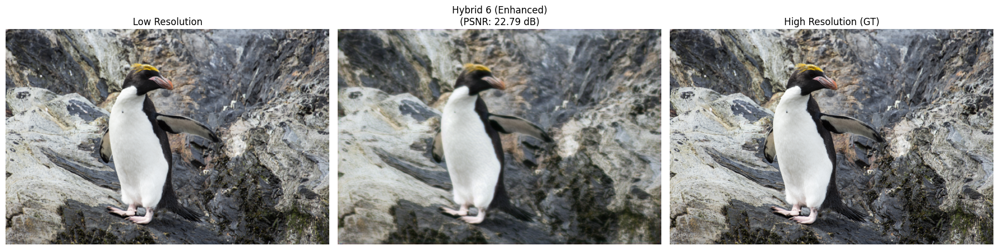

In [75]:
print("\nVisual Comparison for Hybrid 6 (EDSR 32/128 + VGG/L1 Loss - 100 Epochs + Aug) on a Test Image:")
if 'hybrid6_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 6 (Enhanced)": hybrid6_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 6 model or test loader not available for visualization.")

In [76]:
# Evaluate Hybrid 6

print("\n--- Evaluating Hybrid 6 (EDSR 32/128 + VGG/L1 Loss - 100 Epochs + Aug) variable on GPU --- ")

# Ensure device is set to GPU (e.g., device = torch.device("cuda" if torch.cuda.is_available() else "cpu"))
if 'device' not in locals():
    print("Error: 'device' variable not defined. Please define it (e.g., to cuda).")
elif device.type == 'cpu' :
    print("Warning: 'device' is set to CPU. Evaluation will run on CPU.")

if 'hybrid6_model' not in locals():
    print("Error: hybrid6_model variable not found in the current session.")
else:
    print("Using existing hybrid6_model variable...")
    eval_model_h6 = hybrid6_model
    eval_model_h6.to(device)
    eval_model_h6.eval()

    try:
        # Choose Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1")
                # Ensure val_subset is available if creating new loader
                if 'val_subset' in locals():
                    target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True) # pin_memory=True for GPU
                else:
                    print("Error: val_subset not found, cannot create batch_size=1 loader.")
                    target_loader = None # Prevent evaluation if loader is wrong

            if target_loader:
                print("Using validation set for evaluation.")

                # Run Evaluations
                print("\n--- Evaluating SSIM for Hybrid 6 --- ")
                # Pass GPU device to evaluation function
                h6_avg_ssim = evaluate_model_ssim(eval_model_h6, target_loader, device)

                print("\n--- Evaluating LPIPS for Hybrid 6 --- ")
                # Pass GPU device to evaluation function
                h6_avg_lpips = evaluate_model_lpips(eval_model_h6, target_loader, device)

                print(f"\n--- Results for Hybrid 6 ---")
                print(f"Average SSIM: {h6_avg_ssim:.4f}")
                print(f"Average LPIPS: {h6_avg_lpips:.4f} (Lower is better)")

                # Clean up GPU memory
                if 'loss_fn_alex' in locals(): del loss_fn_alex
                torch.cuda.empty_cache()

        else:
            print("Error: Validation loader (e.g., val_loader_h3 with batch_size=1) not found or could not be created.")

    except Exception as e:
        print(f"An error occurred during evaluation (check GPU memory?): {e}")


--- Evaluating Hybrid 6 (EDSR 32/128 + VGG/L1 Loss - 100 Epochs + Aug) variable on GPU --- 
Using existing hybrid6_model variable...
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 6 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.5356

--- Evaluating LPIPS for Hybrid 6 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.6540 (Lower is better)

--- Results for Hybrid 6 ---
Average SSIM: 0.5356
Average LPIPS: 0.6540 (Lower is better)


### 6.7 Hybrid 7: RCAN (10RG, 20RCAB, 64C) + L1 + 0.1 * SSIM Loss (100 epochs, Augmentation)

In [86]:
# Section 8.2: Setup and Train Hybrid 7 (RCAN)

import torch
import torch.optim as optim

# --- Configuration ---
num_epochs_hybrid7 = 100
learning_rate_h7 = 1e-4

# RCAN specific parameters (standard configuration)
rcan_num_rg = 10       # Number of Residual Groups
rcan_num_rcab = 20     # Number of RCAB blocks per group
rcan_channels = 64     # Number of feature channels
rcan_reduction = 16    # Reduction factor for channel attention

print(f"Setting up Hybrid 7: RCAN({rcan_num_rg} RG, {rcan_num_rcab} RCAB, {rcan_channels} C), L1+SSIM Loss, {num_epochs_hybrid7} Epochs, LR={learning_rate_h7}")

# --- Instantiate NEW Model, Loss, Optimizer, Scheduler ---

# Ensure RCAN class definition has been run in the previous cell
if 'RCAN' not in locals():
    print("Error: RCAN class not defined. Please run Cell 1 (Section 8.1) first.")
# Ensure Hybrid2Loss class definition has been run (from previous sections)
elif 'Hybrid2Loss' not in locals():
    print("Error: Hybrid2Loss class definition not found. Please run that cell first.")
# Ensure device is defined (e.g., CUDA)
elif 'device' not in locals():
    print("Error: 'device' variable not defined (should be cuda).")
else:
    # 1. Instantiate Model (RCAN)
    print("Instantiating RCAN model...")
    # Assuming scale_factor is defined (e.g., 4)
    hybrid7_model = RCAN(
        in_channels=3,          # Assuming RGB input
        out_channels=3,         # Assuming RGB output
        channels=rcan_channels,
        reduction=rcan_reduction,
        num_rg=rcan_num_rg,
        num_rcab=rcan_num_rcab,
        upscale_factor=scale_factor
    ).to(device)

    # 2. Instantiate Loss (Using Hybrid2Loss: L1 + SSIM)
    print("Instantiating Hybrid2Loss (L1+SSIM)...")
    hybrid7_criterion = Hybrid2Loss(l1_weight=1.0, ssim_weight=0.1).to(device)

    # 3. Instantiate Optimizer
    hybrid7_optimizer = optim.Adam(hybrid7_model.parameters(), lr=learning_rate_h7)

    # 4. Instantiate Scheduler
    hybrid7_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        hybrid7_optimizer,
        T_max=num_epochs_hybrid7,
        eta_min=1e-6
    )
    print(f"Using Adam optimizer (LR={learning_rate_h7}) and CosineAnnealingLR scheduler (T_max={num_epochs_hybrid7})")

    # --- Train the Hybrid 7 Model ---
    # Ensure train_model function definition has been run
    if 'train_model' not in locals():
        print("Error: train_model function not defined. Please run the cell in Section 3.1 first.")
    # Ensure necessary DataLoaders are available (augmented training, standard validation)
    elif 'train_loader_aug' not in locals() or 'val_loader_h3' not in locals():
        print("Error: Required DataLoaders ('train_loader_aug', 'val_loader_h3') not found. Please run data loading cells.")
    else:
        print("\nStarting Hybrid 7 (RCAN) training...")
        # Call the training function
        hybrid7_model, hybrid7_history = train_model(
            hybrid7_model, "Hybrid 7 (RCAN + L1/SSIM)",
            train_loader_aug, val_loader_h3, # Use augmented train loader, standard val loader
            hybrid7_criterion, hybrid7_optimizer,
            num_epochs_hybrid7, device,
            scheduler=hybrid7_scheduler # Pass the scheduler
        )
        print("\nHybrid 7 (RCAN) training finished.")

Setting up Hybrid 7: RCAN(10 RG, 20 RCAB, 64 C), L1+SSIM Loss, 100 Epochs, LR=0.0001
Instantiating RCAN model...
Instantiating Hybrid2Loss (L1+SSIM)...
Hybrid2Loss initialized with L1 weight: 1.0, SSIM weight: 0.1
Using Adam optimizer (LR=0.0001) and CosineAnnealingLR scheduler (T_max=100)

Starting Hybrid 7 (RCAN) training...

--- Training Hybrid 7 (RCAN + L1/SSIM) ---


Epoch 1/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 1/100 - Train Loss: 0.1788, Val PSNR: 23.50 dB
  -> New best model saved with Val PSNR: 23.50 dB


Epoch 2/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 2/100 - Train Loss: 0.0897, Val PSNR: 24.00 dB
  -> New best model saved with Val PSNR: 24.00 dB


Epoch 3/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 3/100 - Train Loss: 0.0771, Val PSNR: 25.07 dB
  -> New best model saved with Val PSNR: 25.07 dB


Epoch 4/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 4/100 - Train Loss: 0.0698, Val PSNR: 26.18 dB
  -> New best model saved with Val PSNR: 26.18 dB


Epoch 5/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 5/100 - Train Loss: 0.0649, Val PSNR: 25.96 dB


Epoch 6/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 6/100 - Train Loss: 0.0598, Val PSNR: 26.48 dB
  -> New best model saved with Val PSNR: 26.48 dB


Epoch 7/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 7/100 - Train Loss: 0.0608, Val PSNR: 26.42 dB


Epoch 8/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 8/100 - Train Loss: 0.0578, Val PSNR: 26.23 dB


Epoch 9/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 9/100 - Train Loss: 0.0588, Val PSNR: 26.21 dB


Epoch 10/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 10/100 - Train Loss: 0.0585, Val PSNR: 26.58 dB
  -> New best model saved with Val PSNR: 26.58 dB


Epoch 11/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 11/100 - Train Loss: 0.0560, Val PSNR: 26.61 dB
  -> New best model saved with Val PSNR: 26.61 dB


Epoch 12/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 12/100 - Train Loss: 0.0573, Val PSNR: 26.72 dB
  -> New best model saved with Val PSNR: 26.72 dB


Epoch 13/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 13/100 - Train Loss: 0.0561, Val PSNR: 26.70 dB


Epoch 14/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 14/100 - Train Loss: 0.0554, Val PSNR: 26.78 dB
  -> New best model saved with Val PSNR: 26.78 dB


Epoch 15/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 15/100 - Train Loss: 0.0542, Val PSNR: 26.73 dB


Epoch 16/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 16/100 - Train Loss: 0.0515, Val PSNR: 26.78 dB
  -> New best model saved with Val PSNR: 26.78 dB


Epoch 17/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 17/100 - Train Loss: 0.0554, Val PSNR: 26.87 dB
  -> New best model saved with Val PSNR: 26.87 dB


Epoch 18/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 18/100 - Train Loss: 0.0498, Val PSNR: 26.90 dB
  -> New best model saved with Val PSNR: 26.90 dB


Epoch 19/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 19/100 - Train Loss: 0.0528, Val PSNR: 26.94 dB
  -> New best model saved with Val PSNR: 26.94 dB


Epoch 20/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 20/100 - Train Loss: 0.0531, Val PSNR: 26.87 dB


Epoch 21/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 21/100 - Train Loss: 0.0538, Val PSNR: 26.81 dB


Epoch 22/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 22/100 - Train Loss: 0.0541, Val PSNR: 26.85 dB


Epoch 23/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 23/100 - Train Loss: 0.0526, Val PSNR: 26.91 dB


Epoch 24/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 24/100 - Train Loss: 0.0505, Val PSNR: 27.00 dB
  -> New best model saved with Val PSNR: 27.00 dB


Epoch 25/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 25/100 - Train Loss: 0.0534, Val PSNR: 27.01 dB
  -> New best model saved with Val PSNR: 27.01 dB


Epoch 26/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 26/100 - Train Loss: 0.0533, Val PSNR: 26.99 dB


Epoch 27/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 27/100 - Train Loss: 0.0520, Val PSNR: 27.03 dB
  -> New best model saved with Val PSNR: 27.03 dB


Epoch 28/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 28/100 - Train Loss: 0.0532, Val PSNR: 27.04 dB
  -> New best model saved with Val PSNR: 27.04 dB


Epoch 29/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 29/100 - Train Loss: 0.0514, Val PSNR: 26.99 dB


Epoch 30/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 30/100 - Train Loss: 0.0513, Val PSNR: 27.08 dB
  -> New best model saved with Val PSNR: 27.08 dB


Epoch 31/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 31/100 - Train Loss: 0.0492, Val PSNR: 27.06 dB


Epoch 32/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 32/100 - Train Loss: 0.0520, Val PSNR: 26.91 dB


Epoch 33/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 33/100 - Train Loss: 0.0504, Val PSNR: 27.15 dB
  -> New best model saved with Val PSNR: 27.15 dB


Epoch 34/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 34/100 - Train Loss: 0.0512, Val PSNR: 27.15 dB
  -> New best model saved with Val PSNR: 27.15 dB


Epoch 35/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 35/100 - Train Loss: 0.0500, Val PSNR: 27.07 dB


Epoch 36/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 36/100 - Train Loss: 0.0520, Val PSNR: 27.08 dB


Epoch 37/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 37/100 - Train Loss: 0.0515, Val PSNR: 27.13 dB


Epoch 38/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 38/100 - Train Loss: 0.0523, Val PSNR: 27.16 dB
  -> New best model saved with Val PSNR: 27.16 dB


Epoch 39/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 39/100 - Train Loss: 0.0522, Val PSNR: 27.22 dB
  -> New best model saved with Val PSNR: 27.22 dB


Epoch 40/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 40/100 - Train Loss: 0.0503, Val PSNR: 27.20 dB


Epoch 41/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 41/100 - Train Loss: 0.0512, Val PSNR: 27.16 dB


Epoch 42/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 42/100 - Train Loss: 0.0500, Val PSNR: 27.22 dB
  -> New best model saved with Val PSNR: 27.22 dB


Epoch 43/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 43/100 - Train Loss: 0.0505, Val PSNR: 27.21 dB


Epoch 44/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 44/100 - Train Loss: 0.0496, Val PSNR: 27.20 dB


Epoch 45/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 45/100 - Train Loss: 0.0498, Val PSNR: 26.84 dB


Epoch 46/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 46/100 - Train Loss: 0.0498, Val PSNR: 27.22 dB


Epoch 47/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 47/100 - Train Loss: 0.0477, Val PSNR: 27.25 dB
  -> New best model saved with Val PSNR: 27.25 dB


Epoch 48/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 48/100 - Train Loss: 0.0499, Val PSNR: 27.28 dB
  -> New best model saved with Val PSNR: 27.28 dB


Epoch 49/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 49/100 - Train Loss: 0.0482, Val PSNR: 27.28 dB


Epoch 50/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 50/100 - Train Loss: 0.0498, Val PSNR: 27.19 dB


Epoch 51/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 51/100 - Train Loss: 0.0494, Val PSNR: 27.25 dB


Epoch 52/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 52/100 - Train Loss: 0.0473, Val PSNR: 27.27 dB


Epoch 53/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 53/100 - Train Loss: 0.0482, Val PSNR: 27.23 dB


Epoch 54/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 54/100 - Train Loss: 0.0498, Val PSNR: 27.24 dB


Epoch 55/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 55/100 - Train Loss: 0.0496, Val PSNR: 27.29 dB
  -> New best model saved with Val PSNR: 27.29 dB


Epoch 56/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 56/100 - Train Loss: 0.0500, Val PSNR: 27.28 dB


Epoch 57/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 57/100 - Train Loss: 0.0490, Val PSNR: 27.28 dB


Epoch 58/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 58/100 - Train Loss: 0.0495, Val PSNR: 27.30 dB
  -> New best model saved with Val PSNR: 27.30 dB


Epoch 59/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 59/100 - Train Loss: 0.0488, Val PSNR: 27.33 dB
  -> New best model saved with Val PSNR: 27.33 dB


Epoch 60/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 60/100 - Train Loss: 0.0483, Val PSNR: 27.18 dB


Epoch 61/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 61/100 - Train Loss: 0.0496, Val PSNR: 27.34 dB
  -> New best model saved with Val PSNR: 27.34 dB


Epoch 62/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 62/100 - Train Loss: 0.0488, Val PSNR: 27.36 dB
  -> New best model saved with Val PSNR: 27.36 dB


Epoch 63/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 63/100 - Train Loss: 0.0488, Val PSNR: 27.34 dB


Epoch 64/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 64/100 - Train Loss: 0.0491, Val PSNR: 27.30 dB


Epoch 65/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 65/100 - Train Loss: 0.0503, Val PSNR: 27.32 dB


Epoch 66/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 66/100 - Train Loss: 0.0488, Val PSNR: 27.37 dB
  -> New best model saved with Val PSNR: 27.37 dB


Epoch 67/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 67/100 - Train Loss: 0.0489, Val PSNR: 27.30 dB


Epoch 68/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 68/100 - Train Loss: 0.0471, Val PSNR: 27.36 dB


Epoch 69/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 69/100 - Train Loss: 0.0464, Val PSNR: 27.38 dB
  -> New best model saved with Val PSNR: 27.38 dB


Epoch 70/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 70/100 - Train Loss: 0.0481, Val PSNR: 27.38 dB


Epoch 71/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 71/100 - Train Loss: 0.0501, Val PSNR: 27.37 dB


Epoch 72/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 72/100 - Train Loss: 0.0486, Val PSNR: 27.39 dB
  -> New best model saved with Val PSNR: 27.39 dB


Epoch 73/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 73/100 - Train Loss: 0.0481, Val PSNR: 27.36 dB


Epoch 74/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 74/100 - Train Loss: 0.0472, Val PSNR: 27.39 dB
  -> New best model saved with Val PSNR: 27.39 dB


Epoch 75/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 75/100 - Train Loss: 0.0484, Val PSNR: 27.39 dB
  -> New best model saved with Val PSNR: 27.39 dB


Epoch 76/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 76/100 - Train Loss: 0.0481, Val PSNR: 27.40 dB
  -> New best model saved with Val PSNR: 27.40 dB


Epoch 77/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 77/100 - Train Loss: 0.0469, Val PSNR: 27.39 dB


Epoch 78/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 78/100 - Train Loss: 0.0497, Val PSNR: 27.40 dB


Epoch 79/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 79/100 - Train Loss: 0.0466, Val PSNR: 27.40 dB


Epoch 80/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 80/100 - Train Loss: 0.0471, Val PSNR: 27.41 dB
  -> New best model saved with Val PSNR: 27.41 dB


Epoch 81/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 81/100 - Train Loss: 0.0469, Val PSNR: 27.40 dB


Epoch 82/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 82/100 - Train Loss: 0.0464, Val PSNR: 27.41 dB


Epoch 83/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 83/100 - Train Loss: 0.0514, Val PSNR: 27.41 dB
  -> New best model saved with Val PSNR: 27.41 dB


Epoch 84/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 84/100 - Train Loss: 0.0470, Val PSNR: 27.42 dB
  -> New best model saved with Val PSNR: 27.42 dB


Epoch 85/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 85/100 - Train Loss: 0.0447, Val PSNR: 27.42 dB


Epoch 86/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 86/100 - Train Loss: 0.0477, Val PSNR: 27.42 dB
  -> New best model saved with Val PSNR: 27.42 dB


Epoch 87/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 87/100 - Train Loss: 0.0449, Val PSNR: 27.41 dB


Epoch 88/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 88/100 - Train Loss: 0.0488, Val PSNR: 27.41 dB


Epoch 89/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 89/100 - Train Loss: 0.0468, Val PSNR: 27.42 dB
  -> New best model saved with Val PSNR: 27.42 dB


Epoch 90/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 90/100 - Train Loss: 0.0463, Val PSNR: 27.42 dB
  -> New best model saved with Val PSNR: 27.42 dB


Epoch 91/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 91/100 - Train Loss: 0.0461, Val PSNR: 27.43 dB
  -> New best model saved with Val PSNR: 27.43 dB


Epoch 92/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 92/100 - Train Loss: 0.0485, Val PSNR: 27.42 dB


Epoch 93/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 93/100 - Train Loss: 0.0479, Val PSNR: 27.43 dB
  -> New best model saved with Val PSNR: 27.43 dB


Epoch 94/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 94/100 - Train Loss: 0.0482, Val PSNR: 27.43 dB
  -> New best model saved with Val PSNR: 27.43 dB


Epoch 95/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 95/100 - Train Loss: 0.0464, Val PSNR: 27.43 dB


Epoch 96/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 96/100 - Train Loss: 0.0467, Val PSNR: 27.43 dB


Epoch 97/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 97/100 - Train Loss: 0.0478, Val PSNR: 27.43 dB


Epoch 98/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 98/100 - Train Loss: 0.0468, Val PSNR: 27.43 dB


Epoch 99/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 99/100 - Train Loss: 0.0481, Val PSNR: 27.43 dB
  -> New best model saved with Val PSNR: 27.43 dB


Epoch 100/100 [Train]:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating PSNR:   0%|          | 0/80 [00:00<?, ?it/s]

Epoch 100/100 - Train Loss: 0.0480, Val PSNR: 27.43 dB
  -> New best model saved with Val PSNR: 27.43 dB
--- Finished Training Hybrid 7 (RCAN + L1/SSIM) ---
Loaded best model state with Val PSNR: 27.43 dB

Hybrid 7 (RCAN) training finished.


In [87]:
hybrid7_model

RCAN(
  (sfe): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (residual_group): Sequential(
    (0): ResidualGroup(
      (residual_channel_attention_block): Sequential(
        (0): RCAB(
          (rcab): Sequential(
            (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): ReLU(inplace=True)
            (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (3): CALayer(
              (avg_pool): AdaptiveAvgPool2d(output_size=1)
              (conv_du): Sequential(
                (0): Conv2d(64, 4, kernel_size=(1, 1), stride=(1, 1))
                (1): ReLU(inplace=True)
                (2): Conv2d(4, 64, kernel_size=(1, 1), stride=(1, 1))
                (3): Sigmoid()
              )
            )
          )
        )
        (1): RCAB(
          (rcab): Sequential(
            (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): ReLU(inplace=True)
      

In [88]:
import torch

# Save model weights
torch.save(hybrid7_model.state_dict(), 'hybrid7_model_weights.pth')

# OR: Save entire model (not recommended for production)
torch.save(hybrid7_model, 'full_hybrid7_model.pth')


Visual Comparison for Hybrid 7 (RCAN + L1/SSIM Loss - 100 Epochs + Aug) on a Test Image:
Visualizing - LR Image Shape: torch.Size([1, 3, 339, 510]), HR Image Shape: torch.Size([1, 3, 1356, 2040])


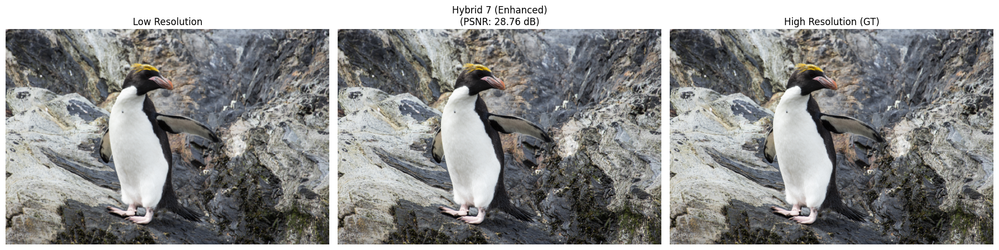

In [89]:
print("\nVisual Comparison for Hybrid 7 (RCAN + L1/SSIM Loss - 100 Epochs + Aug) on a Test Image:")
if 'hybrid7_model' in locals() and test_loader:
    # Ensure the model is loaded with the best state from training
    # (The train_model function should have loaded the best state already)
    models_to_visualize = {"Hybrid 7 (Enhanced)": hybrid7_model}

    # Assuming visualize_comparison function is defined and takes these arguments
    # It likely takes: models_dict, loader, device, scale_factor, idx
    try:
        visualize_comparison(models_to_visualize, test_loader, device, scale_factor, idx=0)
    except NameError:
        print("Error: visualize_comparison function not defined or not found.")
    except Exception as e:
        print(f"An error occurred during visualization: {e}")
else:
    print("Hybrid 7 model or test loader not available for visualization.")

In [90]:
# Evaluate Hybrid 7

print("\n--- Evaluating Hybrid 7 (RCAN + L1/SSIM Loss - 100 Epochs + Aug) on GPU --- ")

# Ensure device is set to GPU (e.g., device = torch.device("cuda" if torch.cuda.is_available() else "cpu"))
if 'device' not in locals():
    print("Error: 'device' variable not defined. Please define it (e.g., to cuda).")
elif device.type == 'cpu' :
    print("Warning: 'device' is set to CPU. Evaluation will run on CPU.")

if 'hybrid7_model' not in locals():
    print("Error: hybrid7_model variable not found in the current session.")
else:
    print("Using existing hybrid7_model variable...")
    eval_model_h7 = hybrid7_model
    eval_model_h7.to(device)
    eval_model_h7.eval()

    try:
        # Choose Dataloader
        if 'val_loader_h3' in locals():
            target_loader = val_loader_h3
            if target_loader.batch_size != 1:
                print("Warning: Creating temporary loader with batch_size=1")
                # Ensure val_subset is available if creating new loader
                if 'val_subset' in locals():
                    target_loader = DataLoader(val_subset, batch_size=1, shuffle=False, num_workers=2, pin_memory=True) # pin_memory=True for GPU
                else:
                    print("Error: val_subset not found, cannot create batch_size=1 loader.")
                    target_loader = None # Prevent evaluation if loader is wrong

            if target_loader:
                print("Using validation set for evaluation.")

                # Run Evaluations
                print("\n--- Evaluating SSIM for Hybrid 6 --- ")
                h7_avg_ssim = evaluate_model_ssim(eval_model_h7, target_loader, device)

                print("\n--- Evaluating LPIPS for Hybrid 6 --- ")
                h7_avg_lpips = evaluate_model_lpips(eval_model_h7, target_loader, device)

                print(f"\n--- Results for Hybrid 6 ---")
                print(f"Average SSIM: {h7_avg_ssim:.4f}")
                print(f"Average LPIPS: {h7_avg_lpips:.4f} (Lower is better)")

                # Clean up GPU memory
                if 'loss_fn_alex' in locals(): del loss_fn_alex
                torch.cuda.empty_cache()

        else:
            print("Error: Validation loader (e.g., val_loader_h3 with batch_size=1) not found or could not be created.")

    except Exception as e:
        print(f"An error occurred during evaluation (check GPU memory?): {e}")


--- Evaluating Hybrid 7 (RCAN + L1/SSIM Loss - 100 Epochs + Aug) on GPU --- 
Using existing hybrid7_model variable...
Using validation set for evaluation.

--- Evaluating SSIM for Hybrid 6 --- 


Evaluating SSIM:   0%|          | 0/80 [00:00<?, ?it/s]


Average SSIM on 80 images: 0.7829

--- Evaluating LPIPS for Hybrid 6 --- 
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/80 [00:00<?, ?it/s]


Average LPIPS on 80 images: 0.3594 (Lower is better)

--- Results for Hybrid 6 ---
Average SSIM: 0.7829
Average LPIPS: 0.3594 (Lower is better)


## 7. Comparative Analysis & Results Summary

### 7.1 Plot Training History (Loss and Validation PSNR)

Corrected plot_history function defined.

Plotting available model histories...


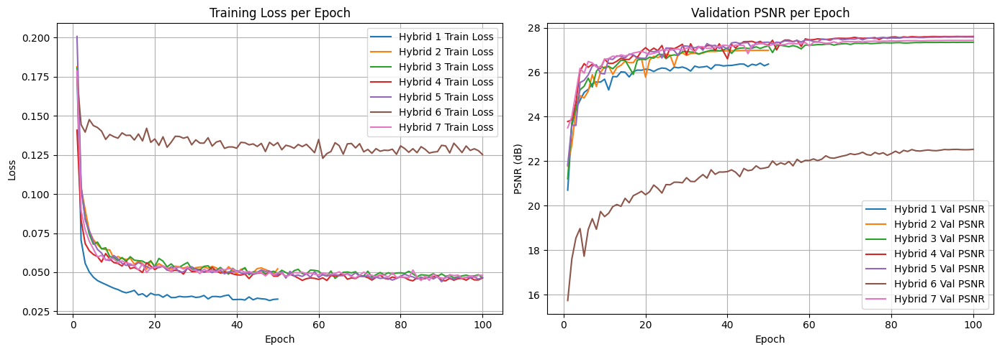

In [121]:
import matplotlib.pyplot as plt

def plot_history(history_dict, model_names):
    num_models = len(history_dict)
    # Check if history is empty
    if not history_dict or not any(name in history_dict and history_dict[name].get("train_loss") for name in model_names):
        print("No valid training history found to plot.")
        return

    plt.figure(figsize=(14, 5))

    # Plot Training Loss
    plt.subplot(1, 2, 1)
    for name in model_names:
        if name in history_dict and history_dict[name].get("train_loss"):
            # <<< Calculate epochs specific to this model >>>
            current_history = history_dict[name]["train_loss"]
            epochs_current = range(1, len(current_history) + 1)
            # <<< Plot using the model-specific epoch range >>>
            plt.plot(epochs_current, current_history, label=f"{name} Train Loss")
        else:
            print(f"Warning: No train_loss history found for {name}.")

    plt.title("Training Loss per Epoch")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)

    # Plot Validation PSNR
    plt.subplot(1, 2, 2)
    for name in model_names:
        if name in history_dict and history_dict[name].get("val_psnr"):
            # <<< Calculate epochs specific to this model >>>
            current_history = history_dict[name]["val_psnr"]
            epochs_current = range(1, len(current_history) + 1)
            # <<< Plot using the model-specific epoch range >>>
            plt.plot(epochs_current, current_history, label=f"{name} Val PSNR")
        else:
            print(f"Warning: No val_psnr history found for {name}.")

    plt.title("Validation PSNR per Epoch")
    plt.xlabel("Epoch")
    plt.ylabel("PSNR (dB)")
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

print("Corrected plot_history function defined.")

# --- Example of how to call it (same as your code) ---
# Combine histories (handle potential errors if training failed for some models)
all_histories = {}
if 'hybrid1_history' in locals(): all_histories["Hybrid 1"] = hybrid1_history
if 'hybrid2_history' in locals(): all_histories["Hybrid 2"] = hybrid2_history
if 'hybrid3_history' in locals(): all_histories["Hybrid 3"] = hybrid3_history
if 'hybrid4_history' in locals(): all_histories["Hybrid 4"] = hybrid4_history
if 'hybrid5_history' in locals(): all_histories["Hybrid 5"] = hybrid5_history
if 'hybrid6_history' in locals(): all_histories["Hybrid 6"] = hybrid6_history
if 'hybrid7_history' in locals(): all_histories["Hybrid 7"] = hybrid7_history

model_names_plot = list(all_histories.keys())

if model_names_plot:
    print("\nPlotting available model histories...")
    plot_history(all_histories, model_names_plot)
else:
    print("\nNo model histories available for plotting.")

### 7.2 Evaluate Models on Test Set

In [101]:
# Updated Evaluation Functions (Handling SRCNN Input Upsampling)

import torch
import torch.nn.functional as F
import numpy as np
from tqdm.notebook import tqdm
from pytorch_msssim import ssim
import lpips


def evaluate_model_psnr(model, loader, device):
    """Evaluates the PSNR of a model, handling SRCNN input upsampling."""
    model.eval()
    total_psnr = 0.0
    num_images = 0
    with torch.no_grad():
        progress_bar = tqdm(loader, desc="Evaluating PSNR", leave=False)
        for lr_imgs, hr_imgs in progress_bar:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            input_tensor = lr_imgs
            # Check if the model is SRCNN and upsample input if necessary
            if isinstance(model, SRCNN):
                target_h, target_w = hr_imgs.shape[-2:]
                # print(f"Upsampling SRCNN input from {lr_imgs.shape} to ({target_h}, {target_w})") # Optional debug print
                input_tensor = F.interpolate(lr_imgs, size=(target_h, target_w), mode='bicubic', align_corners=False)
                input_tensor = torch.clamp(input_tensor, 0.0, 1.0)

            # Get model output
            sr_imgs = model(input_tensor)
            sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)

            # Calculate PSNR (assuming calculate_psnr works on numpy arrays)
            for i in range(sr_imgs.size(0)):
                sr_np = sr_imgs[i].cpu().numpy().transpose(1, 2, 0)
                hr_np = hr_imgs[i].cpu().numpy().transpose(1, 2, 0)
                try:
                    if sr_np.shape == hr_np.shape:
                        current_psnr = calculate_psnr(hr_np, sr_np, data_range=1.0)
                        if not (np.isinf(current_psnr) or np.isnan(current_psnr)):
                            total_psnr += current_psnr
                            num_images += 1
                        else:
                            print(f"Warning: Invalid PSNR value encountered (inf or nan). Skipping image.")
                    else:
                        print(f"Warning: Shape mismatch for PSNR calculation. SR: {sr_np.shape}, HR: {hr_np.shape}. Skipping image.")
                except NameError:
                    print("Error: calculate_psnr function not found.")
                    return None # Or raise error
                except Exception as e:
                    print(f"Error calculating PSNR for an image: {e}. Skipping image.")

            if num_images > 0:
                running_avg_psnr = total_psnr / num_images
                progress_bar.set_postfix({"Avg PSNR": f"{running_avg_psnr:.2f} dB"})

    avg_psnr = total_psnr / num_images if num_images > 0 else 0
    print(f"\nAverage PSNR on {num_images} images: {avg_psnr:.2f} dB")
    return avg_psnr

def evaluate_model_ssim(model, loader, device):
    """Evaluates the SSIM of a model, handling SRCNN input upsampling."""
    model.eval()
    total_ssim = 0.0
    num_images = 0
    with torch.no_grad():
        progress_bar = tqdm(loader, desc="Evaluating SSIM", leave=False)
        for lr_imgs, hr_imgs in progress_bar:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            input_tensor = lr_imgs
            # Check if the model is SRCNN and upsample input if necessary
            if isinstance(model, SRCNN):
                target_h, target_w = hr_imgs.shape[-2:]
                input_tensor = F.interpolate(lr_imgs, size=(target_h, target_w), mode='bicubic', align_corners=False)
                input_tensor = torch.clamp(input_tensor, 0.0, 1.0)

            # Get model output
            sr_imgs = model(input_tensor)
            sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
            hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)

            # Calculate SSIM
            try:
                if sr_imgs.shape == hr_imgs.shape:
                    batch_ssim = ssim(sr_imgs, hr_imgs, data_range=1.0, size_average=False) # Get per-image SSIM
                    total_ssim += torch.sum(batch_ssim).item()
                    num_images += sr_imgs.size(0)
                else:
                     print(f"Warning: Shape mismatch for SSIM calculation. SR: {sr_imgs.shape}, HR: {hr_imgs.shape}. Skipping batch.")
            except Exception as e:
                print(f"Error calculating SSIM for a batch: {e}. Skipping batch.")

            if num_images > 0:
                running_avg_ssim = total_ssim / num_images
                progress_bar.set_postfix({"Avg SSIM": f"{running_avg_ssim:.4f}"})

    avg_ssim = total_ssim / num_images if num_images > 0 else 0
    print(f"\nAverage SSIM on {num_images} images: {avg_ssim:.4f}")
    return avg_ssim

def evaluate_model_lpips(model, loader, device):
    """Evaluates the LPIPS of a model, handling SRCNN input upsampling."""
    model.eval()
    try:
        # Initialize LPIPS model here to manage memory per evaluation call
        loss_fn_alex = lpips.LPIPS(net='alex').to(device)
        loss_fn_alex.eval()
    except Exception as e:
        print(f"Error initializing LPIPS model: {e}")
        return None

    total_lpips = 0.0
    num_images = 0
    with torch.no_grad():
        progress_bar = tqdm(loader, desc="Evaluating LPIPS", leave=False)
        for lr_imgs, hr_imgs in progress_bar:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            input_tensor = lr_imgs
            # Check if the model is SRCNN and upsample input if necessary
            if isinstance(model, SRCNN):
                target_h, target_w = hr_imgs.shape[-2:]
                input_tensor = F.interpolate(lr_imgs, size=(target_h, target_w), mode='bicubic', align_corners=False)
                input_tensor = torch.clamp(input_tensor, 0.0, 1.0)

            # Get model output
            sr_imgs = model(input_tensor)
            sr_imgs = torch.clamp(sr_imgs, 0.0, 1.0)
            hr_imgs = torch.clamp(hr_imgs, 0.0, 1.0)

            # Calculate LPIPS (requires input range [-1, 1])
            try:
                if sr_imgs.shape == hr_imgs.shape:
                    sr_imgs_norm = sr_imgs * 2.0 - 1.0
                    hr_imgs_norm = hr_imgs * 2.0 - 1.0
                    batch_lpips = loss_fn_alex(sr_imgs_norm, hr_imgs_norm)
                    total_lpips += torch.sum(batch_lpips).item()
                    num_images += sr_imgs.size(0)
                else:
                    print(f"Warning: Shape mismatch for LPIPS calculation. SR: {sr_imgs.shape}, HR: {hr_imgs.shape}. Skipping batch.")
            except Exception as e:
                print(f"Error calculating LPIPS for a batch: {e}. Skipping batch.")

            if num_images > 0:
                running_avg_lpips = total_lpips / num_images
                progress_bar.set_postfix({"Avg LPIPS": f"{running_avg_lpips:.4f}"})

    avg_lpips = total_lpips / num_images if num_images > 0 else float('inf')
    print(f"\nAverage LPIPS on {num_images} images: {avg_lpips:.4f} (Lower is better)")

    # Clean up LPIPS model from GPU memory after use
    del loss_fn_alex
    torch.cuda.empty_cache()

    return avg_lpips


In [102]:
# Evaluate Hybrid 1 (SRCNN) on Test Set

print("\n--- Evaluating Hybrid 1 (SRCNN) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'SRCNN' not in locals():
    print("Error: SRCNN class definition not found.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        print("Instantiating SRCNN model...")
        eval_model_h1 = SRCNN().to(device)
        model_path_h1 = "/content/data/hybrid1_model_weights.pth"
        print(f"Loading weights from: {model_path_h1}")
        eval_model_h1.load_state_dict(torch.load(model_path_h1, map_location=device))
        eval_model_h1.eval()
        print("Model weights loaded.")

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 1 (Test Set) ---")
        h1_test_psnr = evaluate_model_psnr(eval_model_h1, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 1 (Test Set) ---")
        h1_test_ssim = evaluate_model_ssim(eval_model_h1, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 1 (Test Set) ---")
        h1_test_lpips = evaluate_model_lpips(eval_model_h1, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 1 ({model_path_h1}) ---")
        print(f"Average Test PSNR: {h1_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h1_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h1_test_lpips:.4f} (Lower is better)")

        # Clean up GPU memory
        del eval_model_h1
        if 'loss_fn_alex' in locals(): del loss_fn_alex # LPIPS cleanup
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 1 evaluation resources.")

    except FileNotFoundError:
        print(f"Error: Model file not found at {model_path_h1}")
    except Exception as e:
        print(f"An error occurred during Hybrid 1 test evaluation: {e}")


--- Evaluating Hybrid 1 (SRCNN) on TEST SET (GPU) ---
Instantiating SRCNN model...
Loading weights from: /content/data/hybrid1_model_weights.pth
Model weights loaded.

--- Evaluating PSNR for Hybrid 1 (Test Set) ---


Evaluating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


Average PSNR on 100 images: 26.60 dB

--- Evaluating SSIM for Hybrid 1 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.7511

--- Evaluating LPIPS for Hybrid 1 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.4373 (Lower is better)

--- TEST Results for Hybrid 1 (/content/data/hybrid1_model_weights.pth) ---
Average Test PSNR: 26.60 dB
Average Test SSIM: 0.7511
Average Test LPIPS: 0.4373 (Lower is better)
Cleaned up Hybrid 1 evaluation resources.


In [98]:
# Evaluate Hybrid 2 (EDSR 32/64) on Test Set

print("\n--- Evaluating Hybrid 2 (EDSR 32/64) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid2_model' not in locals():
    print("Error: hybrid2_model variable not found.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h2 = hybrid2_model
        eval_model_h2.to(device)
        eval_model_h2.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 2 (Test Set) ---")
        h2_test_psnr = evaluate_model_psnr(eval_model_h2, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 2 (Test Set) ---")
        h2_test_ssim = evaluate_model_ssim(eval_model_h2, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 2 (Test Set) ---")
        h2_test_lpips = evaluate_model_lpips(eval_model_h2, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 2 ---")
        print(f"Average Test PSNR: {h2_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h2_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h2_test_lpips:.4f} (Lower is better)")

        # Clean up GPU memory
        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 2 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 2 test evaluation: {e}")


--- Evaluating Hybrid 2 (EDSR 32/64) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 2 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 2 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.7801

--- Evaluating LPIPS for Hybrid 2 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.3597 (Lower is better)

--- TEST Results for Hybrid 2 ---
Average Test PSNR: 27.41 dB
Average Test SSIM: 0.7801
Average Test LPIPS: 0.3597 (Lower is better)
Cleaned up Hybrid 2 evaluation resources.


In [97]:
# Evaluate Hybrid 3 (EDSR 32/64) on Test Set

print("\n--- Evaluating Hybrid 3 (EDSR 32/64) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid3_model' not in locals():
     print("Error: hybrid3_model variable not found.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h3 = hybrid3_model
        eval_model_h3.to(device)
        eval_model_h3.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 3 (Test Set) ---")
        h3_test_psnr = evaluate_model_psnr(eval_model_h3, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 3 (Test Set) ---")
        h3_test_ssim = evaluate_model_ssim(eval_model_h3, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 3 (Test Set) ---")
        h3_test_lpips = evaluate_model_lpips(eval_model_h3, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 3 ---")
        print(f"Average Test PSNR: {h3_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h3_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h3_test_lpips:.4f} (Lower is better)")

        # Clean up GPU memory
        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 3 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 3 test evaluation: {e}")


--- Evaluating Hybrid 3 (EDSR 32/64) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 3 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 3 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.7933

--- Evaluating LPIPS for Hybrid 3 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.3327 (Lower is better)

--- TEST Results for Hybrid 3 ---
Average Test PSNR: 27.85 dB
Average Test SSIM: 0.7933
Average Test LPIPS: 0.3327 (Lower is better)
Cleaned up Hybrid 3 evaluation resources.


In [96]:
# Evaluate Hybrid 4 (EDSR 32/128) on Test Set

print("\n--- Evaluating Hybrid 4 (EDSR 32/128) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid4_model' not in locals():
     print("Error: hybrid4_model variable not found.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h4 = hybrid4_model
        eval_model_h4.to(device)
        eval_model_h4.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 4 (Test Set) ---")
        h4_test_psnr = evaluate_model_psnr(eval_model_h4, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 4 (Test Set) ---")
        h4_test_ssim = evaluate_model_ssim(eval_model_h4, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 4 (Test Set) ---")
        h4_test_lpips = evaluate_model_lpips(eval_model_h4, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 4 ---")
        print(f"Average Test PSNR: {h4_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h4_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h4_test_lpips:.4f} (Lower is better)")

        #  Clean up GPU memory
        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 4 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 4 test evaluation: {e}")


--- Evaluating Hybrid 4 (EDSR 32/128) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 4 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 4 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.8031

--- Evaluating LPIPS for Hybrid 4 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.3132 (Lower is better)

--- TEST Results for Hybrid 4 ---
Average Test PSNR: 28.17 dB
Average Test SSIM: 0.8031
Average Test LPIPS: 0.3132 (Lower is better)
Cleaned up Hybrid 4 evaluation resources.


In [95]:
# Evaluate Hybrid 5 (EDSR 64/128) on Test Set

print("\n--- Evaluating Hybrid 5 (EDSR 64/128) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid5_model' not in locals():
     print("Error: hybrid5_model variable not found. Make sure training finished and variable exists.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h5 = hybrid5_model
        eval_model_h5.to(device)
        eval_model_h5.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 5 (Test Set) ---")
        h5_test_psnr = evaluate_model_psnr(eval_model_h5, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 5 (Test Set) ---")
        h5_test_ssim = evaluate_model_ssim(eval_model_h5, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 5 (Test Set) ---")
        h5_test_lpips = evaluate_model_lpips(eval_model_h5, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 5 ---")
        print(f"Average Test PSNR: {h5_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h5_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h5_test_lpips:.4f} (Lower is better)")

        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 5 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 5 test evaluation: {e}")


--- Evaluating Hybrid 5 (EDSR 64/128) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 5 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 5 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.8019

--- Evaluating LPIPS for Hybrid 5 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.3128 (Lower is better)

--- TEST Results for Hybrid 5 ---
Average Test PSNR: 28.15 dB
Average Test SSIM: 0.8019
Average Test LPIPS: 0.3128 (Lower is better)
Cleaned up Hybrid 5 evaluation resources.


In [94]:
#  Evaluate Hybrid 6 (EDSR 32/128 + VGG/L1) on Test Set

print("\n--- Evaluating Hybrid 6 (EDSR 32/128 + VGG/L1) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid6_model' not in locals():
     print("Error: hybrid6_model variable not found.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h6 = hybrid6_model
        eval_model_h6.to(device)
        eval_model_h6.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 6 (Test Set) ---")
        h6_test_psnr = evaluate_model_psnr(eval_model_h6, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 6 (Test Set) ---")
        h6_test_ssim = evaluate_model_ssim(eval_model_h6, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 6 (Test Set) ---")
        h6_test_lpips = evaluate_model_lpips(eval_model_h6, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 6 ---")
        print(f"Average Test PSNR: {h6_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h6_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h6_test_lpips:.4f} (Lower is better)")

        # Clean up GPU memory
        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 6 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 6 test evaluation: {e}")


--- Evaluating Hybrid 6 (EDSR 32/128 + VGG/L1) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 6 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 6 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.5412

--- Evaluating LPIPS for Hybrid 6 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.6445 (Lower is better)

--- TEST Results for Hybrid 6 ---
Average Test PSNR: 22.58 dB
Average Test SSIM: 0.5412
Average Test LPIPS: 0.6445 (Lower is better)
Cleaned up Hybrid 6 evaluation resources.


In [93]:
# Evaluate Hybrid 7 (RCAN) on Test Set

print("\n--- Evaluating Hybrid 7 (RCAN) on TEST SET (GPU) ---")

# Ensure prerequisites are met
if 'hybrid7_model' not in locals():
     print("Error: hybrid7_model variable not found. Make sure RCAN training finished.")
elif 'test_loader_h3' not in locals() or test_loader_h3.batch_size != 1:
    print("Error: test_loader_h3 (batch_size=1) not found.")
elif 'device' not in locals():
    print("Error: 'device' variable not defined.")
elif 'evaluate_model_psnr' not in locals() or 'evaluate_model_ssim' not in locals() or 'evaluate_model_lpips' not in locals():
    print("Error: Evaluation functions (psnr, ssim, lpips) not defined.")
else:
    try:
        eval_model_h7 = hybrid7_model
        eval_model_h7.to(device)
        eval_model_h7.eval()

        # Run Evaluations
        print("\n--- Evaluating PSNR for Hybrid 7 (Test Set) ---")
        h7_test_psnr = evaluate_model_psnr(eval_model_h7, test_loader_h3, device)

        print("\n--- Evaluating SSIM for Hybrid 7 (Test Set) ---")
        h7_test_ssim = evaluate_model_ssim(eval_model_h7, test_loader_h3, device)

        print("\n--- Evaluating LPIPS for Hybrid 7 (Test Set) ---")
        h7_test_lpips = evaluate_model_lpips(eval_model_h7, test_loader_h3, device)

        print(f"\n--- TEST Results for Hybrid 7 ---")
        print(f"Average Test PSNR: {h7_test_psnr:.2f} dB")
        print(f"Average Test SSIM: {h7_test_ssim:.4f}")
        print(f"Average Test LPIPS: {h7_test_lpips:.4f} (Lower is better)")

        # Clean up GPU memory
        if 'loss_fn_alex' in locals(): del loss_fn_alex
        torch.cuda.empty_cache()
        print("Cleaned up Hybrid 7 evaluation resources.")

    except Exception as e:
        print(f"An error occurred during Hybrid 7 test evaluation: {e}")


--- Evaluating Hybrid 7 (RCAN) on TEST SET (GPU) ---

--- Evaluating PSNR for Hybrid 7 (Test Set) ---


Calculating PSNR:   0%|          | 0/100 [00:00<?, ?it/s]


--- Evaluating SSIM for Hybrid 7 (Test Set) ---


Evaluating SSIM:   0%|          | 0/100 [00:00<?, ?it/s]


Average SSIM on 100 images: 0.7959

--- Evaluating LPIPS for Hybrid 7 (Test Set) ---
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


Evaluating LPIPS:   0%|          | 0/100 [00:00<?, ?it/s]


Average LPIPS on 100 images: 0.3409 (Lower is better)

--- TEST Results for Hybrid 7 ---
Average Test PSNR: 27.94 dB
Average Test SSIM: 0.7959
Average Test LPIPS: 0.3409 (Lower is better)
Cleaned up Hybrid 7 evaluation resources.


### 7.3 Summary

In [13]:
# The values are taken from the results of 5.2 section
results_data = [
    {"Model Name": "Hybrid 1", "PSNR (dB)": 26.60, "SSIM": 0.7511, "LPIPS": 0.4373},
    {"Model Name": "Hybrid 2", "PSNR (dB)": 27.41, "SSIM": 0.7801, "LPIPS": 0.3597},
    {"Model Name": "Hybrid 3", "PSNR (dB)": 27.85, "SSIM": 0.7933, "LPIPS": 0.3327},
    {"Model Name": "Hybrid 4", "PSNR (dB)": 28.17, "SSIM": 0.8031, "LPIPS": 0.3132},
    {"Model Name": "Hybrid 5", "PSNR (dB)": 28.15, "SSIM": 0.8019, "LPIPS": 0.3128},
    {"Model Name": "Hybrid 6", "PSNR (dB)": 22.58, "SSIM": 0.5412, "LPIPS": 0.6445},
    {"Model Name": "Hybrid 7", "PSNR (dB)": 27.94, "SSIM": 0.7959, "LPIPS": 0.3409}
]

# Sort the data by PSNR in descending order (for Markdown table)
sorted_results_by_psnr = sorted(results_data, key=lambda x: x["PSNR (dB)"], reverse=True)

# Print the sorted data as a Markdown table
print("\n--- Final Test Results Summary (Sorted by PSNR) ---")
print("==================================================================")
print("| Model Name         | PSNR (dB)    | SSIM       | LPIPS      |")
print("|--------------------|--------------|------------|------------|")
for item in sorted_results_by_psnr:
    print(f"| {item['Model Name']:<18} | {item['PSNR (dB)']:<12.2f} | {item['SSIM']:<10.4f} | {item['LPIPS']:<10.4f} |")
print("==================================================================")


if sorted_results_by_psnr: # Check if the list is not empty
    best_model_by_psnr = sorted_results_by_psnr[0] # Get the first dictionary (highest PSNR)

    print("\n--- Best Performing Model (Based on PSNR) ---")
    print(f"Best performing model (based on PSNR): {best_model_by_psnr['Model Name']}")
    print(f"  PSNR:  {best_model_by_psnr['PSNR (dB)']}")
    print(f"  SSIM:  {best_model_by_psnr['SSIM']}")
    print(f"  LPIPS: {best_model_by_psnr['LPIPS']}")
    print("\n(Higher PSNR/SSIM is better, Lower LPIPS is better)")
else:
    print("Result list is empty.")


--- Final Test Results Summary (Sorted by PSNR) ---
| Model Name         | PSNR (dB)    | SSIM       | LPIPS      |
|--------------------|--------------|------------|------------|
| Hybrid 4           | 28.17        | 0.8031     | 0.3132     |
| Hybrid 5           | 28.15        | 0.8019     | 0.3128     |
| Hybrid 7           | 27.94        | 0.7959     | 0.3409     |
| Hybrid 3           | 27.85        | 0.7933     | 0.3327     |
| Hybrid 2           | 27.41        | 0.7801     | 0.3597     |
| Hybrid 1           | 26.60        | 0.7511     | 0.4373     |
| Hybrid 6           | 22.58        | 0.5412     | 0.6445     |

--- Best Performing Model (Based on PSNR) ---
Best performing model (based on PSNR): Hybrid 4
  PSNR:  28.17
  SSIM:  0.8031
  LPIPS: 0.3132

(Higher PSNR/SSIM is better, Lower LPIPS is better)
